In [1]:
# torch-gpu environment
# using output from cellprofiler run

import warnings
warnings.filterwarnings('ignore')
import pandas
import numpy
import matplotlib.pyplot as plt
import seaborn
import sklearn
import umap
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
import matplotlib
import matplotlib.pyplot as plt
import cv2
import glob

2025-01-29 11:49:48.181805: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-01-29 11:49:48.216036: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2025-01-29 11:49:48.216076: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2025-01-29 11:49:48.217152: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2025-01-29 11:49:48.223257: I tensorflow/core/platform/cpu_feature_guar

In [3]:
p1 = pandas.read_csv('plate1/calcein/cells.txt', sep='\t')
print(p1.shape)
p2 = pandas.read_csv('plate2/calcein/cells.txt', sep='\t')
print(p2.shape)
# p3 = pandas.read_csv('plate3/cells.txt', sep='\t')
# print(p3.shape)
p4 = pandas.read_csv('plate4/calcein/cells.txt', sep='\t')
print(p4.shape)

(44747, 425)
(52113, 425)
(35342, 425)


In [4]:
(p1.columns == p2.columns).all()

True

In [5]:
imgs1 = pandas.read_csv('plate1/calcein/Image.txt', sep='\t')
print(imgs1.shape)
imgs2 = pandas.read_csv('plate2/calcein/Image.txt', sep='\t')
print(imgs2.shape)
# imgs3 = pandas.read_csv('plate3/Image.txt', sep='\t')
# print(imgs3.shape)
imgs4 = pandas.read_csv('plate4/calcein/Image.txt', sep='\t')
print(imgs4.shape)

(859, 2298)
(854, 2298)
(853, 2298)


In [6]:
(imgs1.columns == imgs4.columns).all()

True

In [7]:
for x in [imgs1, imgs2, imgs4]:
    x.rename(columns={'Metadata_Well':'well', 'Metadata_guide':'guide'}, inplace=True)

In [8]:
for x in [p1, p2, p4]:
    x.rename(columns={'Metadata_Well':'well', 'Metadata_guide':'guide'}, inplace=True)

In [11]:
for x in [p1,p2,p4]:
    x['guide'] = x.guide.apply(lambda i: i.replace('non-targeting', 'nt'))
p1.guide.unique()

array(['nt_00999', 'MFN2_2', 'LAMP1', 'nt_01460', 'LMNB2', 'ATP13A2',
       'DYRK1A', 'nt_03731', 'PICALM', 'nt_03677', 'SOD1', 'nt_00095',
       'MESDC1', 'CKAP5_2', 'DNM1L', 'MFN2_1', 'BECN1', 'nt_02845',
       'CKAP5_1', 'PINK1', 'nt_02396', 'nt_02443', 'ILK', 'nt_02621',
       'nt_03526', 'GNAO1', 'nt_02160', 'nt_01706', 'nt_00177', 'PSEN1'],
      dtype=object)

In [12]:
for x in [imgs1,imgs2,imgs4]:
    x['guide'] = x.guide.apply(lambda i: i.replace('non-targeting', 'nt'))
imgs1.guide.unique()

array(['nt_00999', 'MFN2_2', 'LAMP1', 'nt_01460', 'LMNB2', 'ATP13A2',
       'DYRK1A', 'nt_03731', 'PICALM', 'nt_03677', 'SOD1', 'nt_00095',
       'MESDC1', 'CKAP5_2', 'DNM1L', 'MFN2_1', 'BECN1', 'nt_02845',
       'CKAP5_1', 'PINK1', 'nt_02396', 'nt_02443', 'ILK', 'nt_02621',
       'nt_03526', 'GNAO1', 'nt_02160', 'nt_01706', 'nt_00177', 'PSEN1'],
      dtype=object)

In [13]:
treatments = pandas.read_csv('treatments.txt', sep='\t')
treatments['guide'] = treatments.guide.apply(lambda x: x.replace('non-targeting', 'nt'))
print(treatments.shape)
treatments.head()     

(240, 2)


,well,guide
0,C03,nt_00999
1,C05,LAMP1
2,C07,LMNB2
3,C09,DYRK1A
4,C11,PICALM


In [14]:
# function to remove not useful columns from CP output:

def subset_table(cells):
    subset = cells.copy()
    subset = subset[list(subset.columns[9:])]
    print(subset.shape)
    subset.dropna(axis='columns', inplace=True)
    subset.dropna(axis='rows', inplace=True)
    print(subset.shape)
    
    subset.drop(index=subset.iloc[subset.values==numpy.inf].index, inplace=True)
    print(subset.shape)
    
    subset.reset_index(inplace=True, drop=True)
    
    del subset['Number_Object_Number']
    del subset['Parent_masks']
    if 'Intensity_MassDisplacement_tubu_enhance' in subset.columns:
        del subset['Intensity_MassDisplacement_tubu_enhance']
    if 'Intensity_MassDisplacement_tubulin' in subset.columns:
        del subset['Intensity_MassDisplacement_tubulin']
    if 'Intensity_MassDisplacement_lyso_enhance' in subset.columns:
        del subset['Intensity_MassDisplacement_lyso_enhance']
    if 'Intensity_MassDisplacement_lysosome' in subset.columns:
        del subset['Intensity_MassDisplacement_lysosome']
    print(subset.shape)
    
    for x in subset.columns:
        if x.startswith('Location'):
            del subset[x]
    for x in subset.columns:
        if '_X' in x:
            del subset[x]
    for x in subset.columns:
        if '_Y' in x:
            del subset[x]
    for x in subset.columns:
        if '_Z' in x:
            del subset[x]
    for x in subset.columns:
        if 'Metadata' in x:
            del subset[x]
    return subset

In [15]:
subset1 = subset_table(p1)
subset2 = subset_table(p2)
# subset3 = subset_table(p3)
subset4 = subset_table(p4)

(44747, 416)
(44747, 413)
(44747, 413)
(44747, 407)
(52113, 416)
(52113, 413)
(52113, 413)
(52113, 407)
(35342, 416)
(35342, 413)
(35342, 413)
(35342, 407)


In [16]:
subset4 = subset4[list(subset4.columns[2:]) + ['well', 'guide']]
subset2 = subset2[subset4.columns]
# subset3 = subset3[subset4.columns]
subset1 = subset1[subset4.columns]

In [17]:
(subset1.columns == subset2.columns).all()

True

In [19]:
subset_columns = list(subset4.columns)
len(subset_columns)

361

array([<Axes: title={'center': 'ATP13A2'}>,
       <Axes: title={'center': 'BECN1'}>,
       <Axes: title={'center': 'CKAP5_1'}>,
       <Axes: title={'center': 'CKAP5_2'}>,
       <Axes: title={'center': 'DNM1L'}>,
       <Axes: title={'center': 'DYRK1A'}>,
       <Axes: title={'center': 'GNAO1'}>, <Axes: title={'center': 'ILK'}>,
       <Axes: title={'center': 'LAMP1'}>,
       <Axes: title={'center': 'LMNB2'}>,
       <Axes: title={'center': 'MESDC1'}>,
       <Axes: title={'center': 'MFN2_1'}>,
       <Axes: title={'center': 'MFN2_2'}>,
       <Axes: title={'center': 'PICALM'}>,
       <Axes: title={'center': 'PINK1'}>,
       <Axes: title={'center': 'PSEN1'}>,
       <Axes: title={'center': 'SOD1'}>,
       <Axes: title={'center': 'nt_00095'}>,
       <Axes: title={'center': 'nt_00177'}>,
       <Axes: title={'center': 'nt_00999'}>,
       <Axes: title={'center': 'nt_01460'}>,
       <Axes: title={'center': 'nt_01706'}>,
       <Axes: title={'center': 'nt_02160'}>,
       <Axes: t

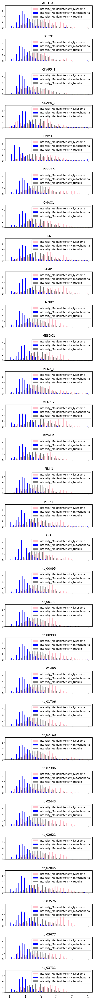

In [21]:
# plate 1:
p1[['Intensity_MedianIntensity_lysosome', 'Intensity_MedianIntensity_mitochondria', 'Intensity_MedianIntensity_tubulin', 'guide']].hist(
    bins=50, layout=(p1.guide.nunique(),1), figsize=(6,72), by='guide', legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True, density=True)

array([<Axes: title={'center': 'ATP13A2'}>,
       <Axes: title={'center': 'BECN1'}>,
       <Axes: title={'center': 'CKAP5_1'}>,
       <Axes: title={'center': 'CKAP5_2'}>,
       <Axes: title={'center': 'DNM1L'}>,
       <Axes: title={'center': 'DYRK1A'}>,
       <Axes: title={'center': 'GNAO1'}>, <Axes: title={'center': 'ILK'}>,
       <Axes: title={'center': 'LAMP1'}>,
       <Axes: title={'center': 'LMNB2'}>,
       <Axes: title={'center': 'MESDC1'}>,
       <Axes: title={'center': 'MFN2_1'}>,
       <Axes: title={'center': 'MFN2_2'}>,
       <Axes: title={'center': 'PICALM'}>,
       <Axes: title={'center': 'PINK1'}>,
       <Axes: title={'center': 'PSEN1'}>,
       <Axes: title={'center': 'SOD1'}>,
       <Axes: title={'center': 'nt_00095'}>,
       <Axes: title={'center': 'nt_00177'}>,
       <Axes: title={'center': 'nt_00999'}>,
       <Axes: title={'center': 'nt_01460'}>,
       <Axes: title={'center': 'nt_01706'}>,
       <Axes: title={'center': 'nt_02160'}>,
       <Axes: t

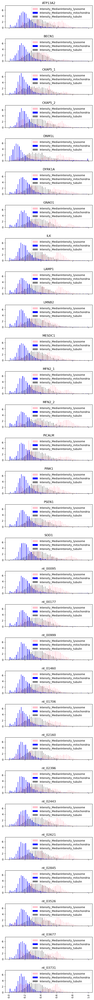

In [22]:
# plate 2:
p2[['Intensity_MedianIntensity_lysosome', 'Intensity_MedianIntensity_mitochondria', 'Intensity_MedianIntensity_tubulin', 'guide']].hist(
    bins=50, layout=(p2.guide.nunique(),1), figsize=(6,72), by='guide', legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True, density=True)

In [23]:
# # plate 3:
# p3[['Intensity_MedianIntensity_lysosome', 'Intensity_MedianIntensity_mitochondria', 'Intensity_MedianIntensity_tubulin', 'guide']].hist(
#     bins=25, layout=(p3.guide.nunique(),1), figsize=(6,72), by='guide', legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True, density=True)

array([<Axes: title={'center': 'ATP13A2'}>,
       <Axes: title={'center': 'BECN1'}>,
       <Axes: title={'center': 'CKAP5_1'}>,
       <Axes: title={'center': 'CKAP5_2'}>,
       <Axes: title={'center': 'DNM1L'}>,
       <Axes: title={'center': 'DYRK1A'}>,
       <Axes: title={'center': 'GNAO1'}>, <Axes: title={'center': 'ILK'}>,
       <Axes: title={'center': 'LAMP1'}>,
       <Axes: title={'center': 'LMNB2'}>,
       <Axes: title={'center': 'MESDC1'}>,
       <Axes: title={'center': 'MFN2_1'}>,
       <Axes: title={'center': 'MFN2_2'}>,
       <Axes: title={'center': 'PICALM'}>,
       <Axes: title={'center': 'PINK1'}>,
       <Axes: title={'center': 'PSEN1'}>,
       <Axes: title={'center': 'SOD1'}>,
       <Axes: title={'center': 'nt_00095'}>,
       <Axes: title={'center': 'nt_00177'}>,
       <Axes: title={'center': 'nt_00999'}>,
       <Axes: title={'center': 'nt_01460'}>,
       <Axes: title={'center': 'nt_01706'}>,
       <Axes: title={'center': 'nt_02160'}>,
       <Axes: t

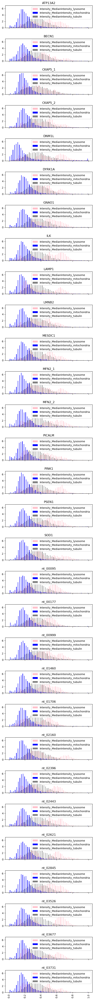

In [24]:
# plate 4:
p4[['Intensity_MedianIntensity_lysosome', 'Intensity_MedianIntensity_mitochondria', 'Intensity_MedianIntensity_tubulin', 'guide']].hist(
    bins=50, layout=(p4.guide.nunique(),1), figsize=(6,72), by='guide', legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True, density=True)

In [64]:
[x for x in imgs1.columns if 'Intensity' in x]

['ExecutionTime_32MeasureObjectIntensity',
 'ImageQuality_MADIntensity_lysosome',
 'ImageQuality_MADIntensity_mitochondria',
 'ImageQuality_MADIntensity_tubulin',
 'ImageQuality_MaxIntensity_lysosome',
 'ImageQuality_MaxIntensity_mitochondria',
 'ImageQuality_MaxIntensity_tubulin',
 'ImageQuality_MeanIntensity_lysosome',
 'ImageQuality_MeanIntensity_mitochondria',
 'ImageQuality_MeanIntensity_tubulin',
 'ImageQuality_MedianIntensity_lysosome',
 'ImageQuality_MedianIntensity_mitochondria',
 'ImageQuality_MedianIntensity_tubulin',
 'ImageQuality_MinIntensity_lysosome',
 'ImageQuality_MinIntensity_mitochondria',
 'ImageQuality_MinIntensity_tubulin',
 'ImageQuality_StdIntensity_lysosome',
 'ImageQuality_StdIntensity_mitochondria',
 'ImageQuality_StdIntensity_tubulin',
 'ImageQuality_TotalIntensity_lysosome',
 'ImageQuality_TotalIntensity_mitochondria',
 'ImageQuality_TotalIntensity_tubulin',
 'Mean_cells_Intensity_IntegratedIntensityEdge_lyso_enhance',
 'Mean_cells_Intensity_IntegratedInte

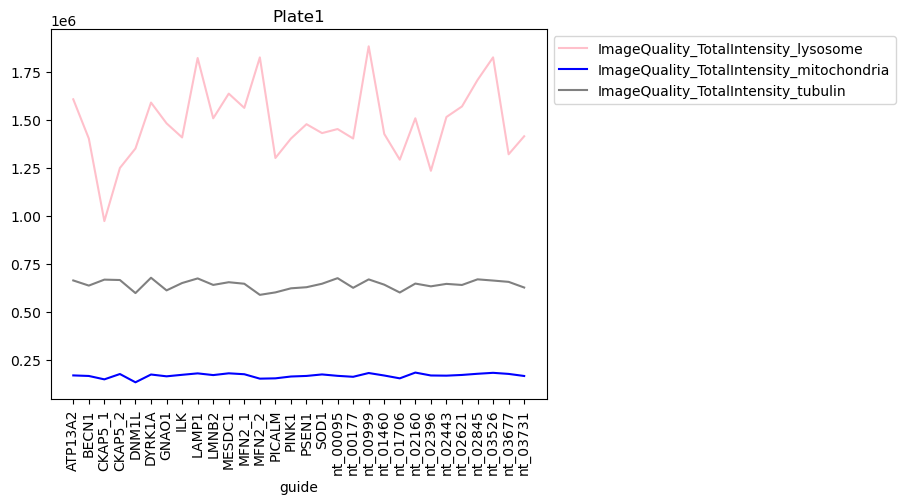

In [26]:
t = 'Plate1'
imgs1[['ImageQuality_TotalIntensity_lysosome', 'ImageQuality_TotalIntensity_mitochondria', 'ImageQuality_TotalIntensity_tubulin', 'guide']].groupby('guide').mean().plot(color=['pink', 'b', 'grey'],
xticks=range(imgs1.guide.nunique()), title=t, rot=90).legend(bbox_to_anchor=(1.0, 1.0))


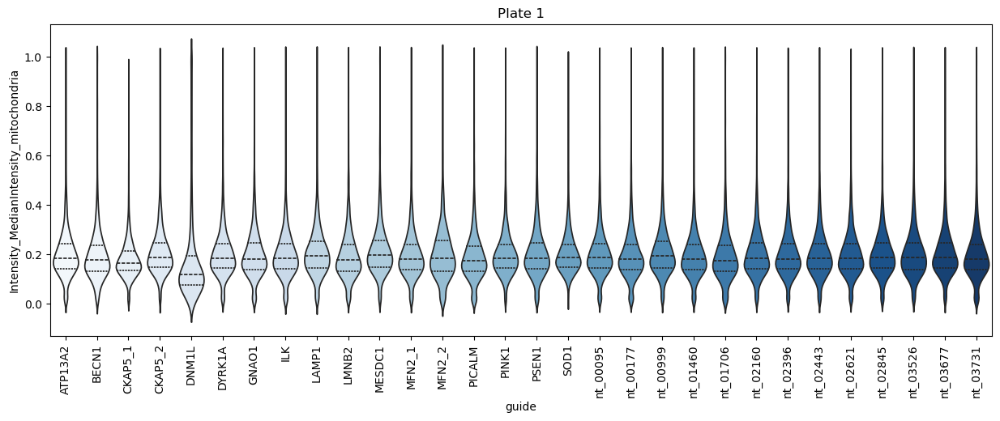

In [41]:
plt.rcParams['figure.figsize']=(15,5)
fig, axes = plt.subplots()
import seaborn

seaborn.violinplot(data=p1.sort_values(by='guide'), x = 'guide', y='Intensity_MedianIntensity_mitochondria', ax = axes, hue='guide', palette='Blues', inner='quart')
axes.set_title('Plate 1')

axes.yaxis.grid(False)
axes.set_xlabel('guide')
# axes.set_ylabel('cells/well')
plt.xticks(rotation=90)

plt.show()

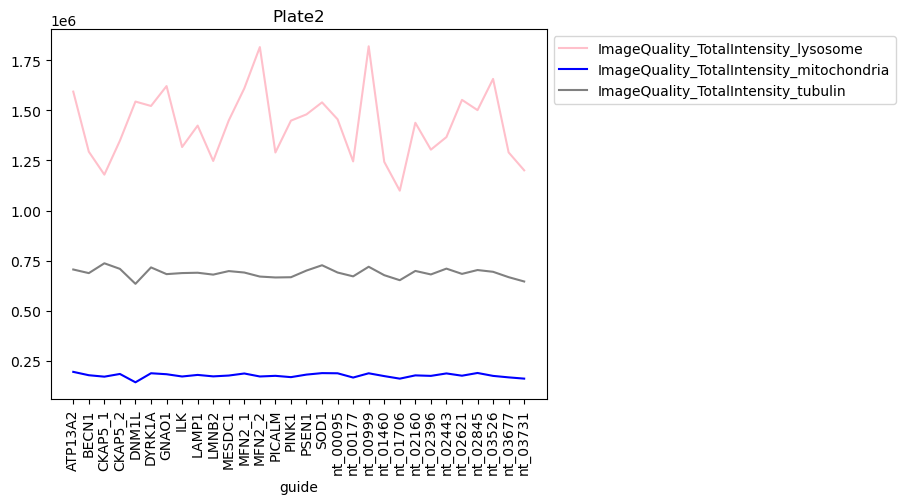

In [27]:
t = 'Plate2'
imgs2[['ImageQuality_TotalIntensity_lysosome', 'ImageQuality_TotalIntensity_mitochondria', 'ImageQuality_TotalIntensity_tubulin', 'guide']].groupby('guide').mean().plot(color=['pink', 'b', 'grey'],
xticks=range(imgs2.guide.nunique()), title=t, rot=90).legend(bbox_to_anchor=(1.0, 1.0))


In [28]:
# t = 'Plate3'
# imgs3[['ImageQuality_TotalIntensity_lysosome', 'ImageQuality_TotalIntensity_mitochondria', 'ImageQuality_TotalIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'],
# xticks=range(imgs3.guide.nunique()), title=t, rot=90).legend(bbox_to_anchor=(1.0, 1.0))

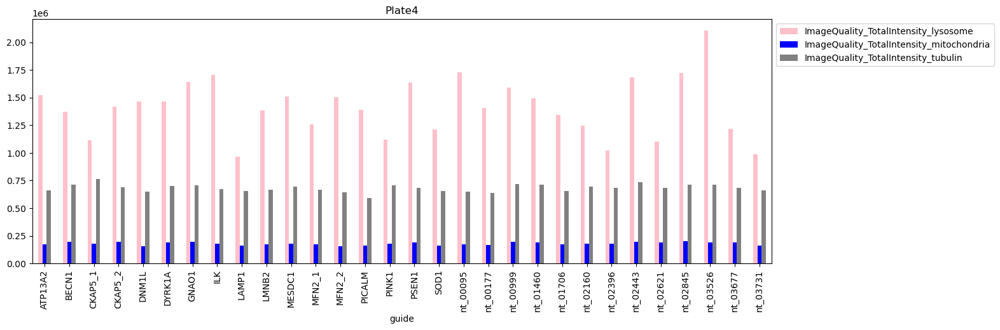

In [43]:
t = 'Plate4'
imgs4[['ImageQuality_TotalIntensity_lysosome', 'ImageQuality_TotalIntensity_mitochondria', 'ImageQuality_TotalIntensity_tubulin', 'guide']].groupby('guide').median().plot(kind='bar', color=['pink', 'b', 'grey'],
# xticks=range(imgs4.guide.nunique()), 
title=t, rot=90).legend(bbox_to_anchor=(1.0, 1.0))

In [69]:
type(p1)

pandas.core.frame.DataFrame

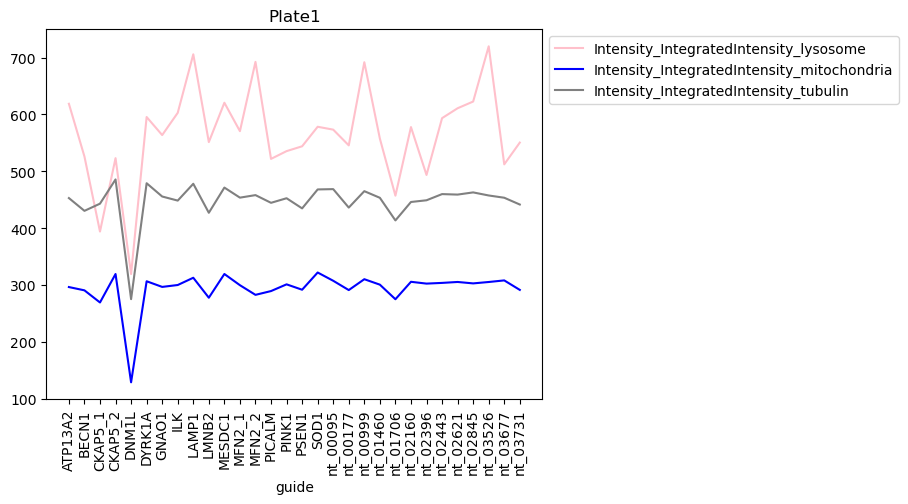

In [30]:
t = 'Plate1'
p1[['Intensity_IntegratedIntensity_lysosome', 'Intensity_IntegratedIntensity_mitochondria', 'Intensity_IntegratedIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p1.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))
# subset.to_pandas()[['Intensity_IntegratedIntensity_lysosome', 'Intensity_IntegratedIntensity_mitochondria', 'Intensity_IntegratedIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(30), title=t).legend(bbox_to_anchor=(1.0, 1.0))

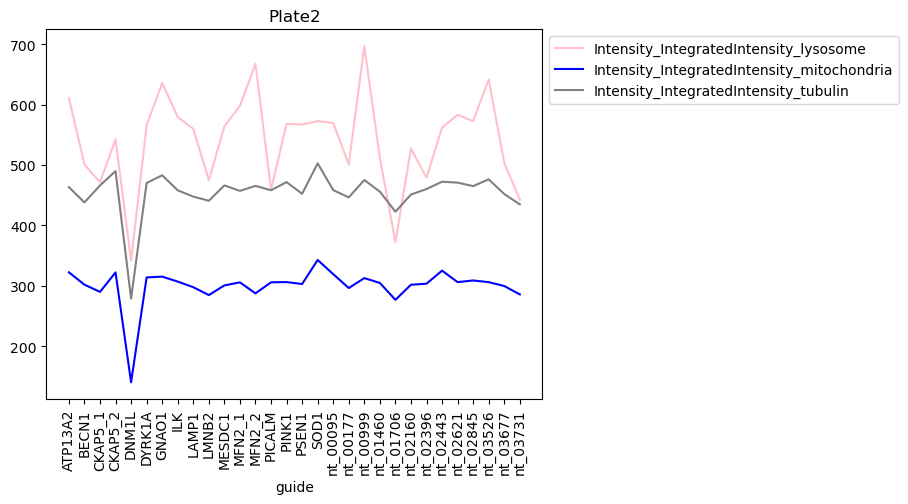

In [31]:
t = 'Plate2'
p2[['Intensity_IntegratedIntensity_lysosome', 'Intensity_IntegratedIntensity_mitochondria', 'Intensity_IntegratedIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p2.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

In [32]:
# t = 'Plate3'
# p3[['Intensity_IntegratedIntensity_lysosome', 'Intensity_IntegratedIntensity_mitochondria', 'Intensity_IntegratedIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p3.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

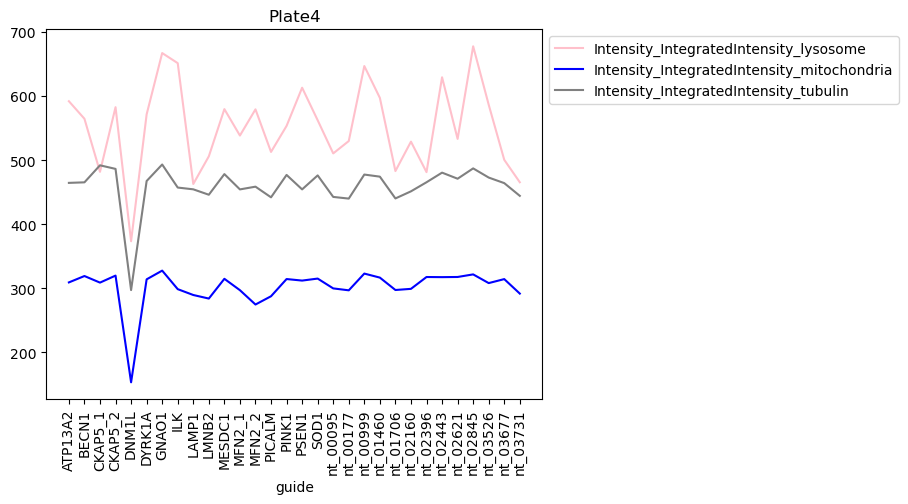

In [33]:
t = 'Plate4'
p4[['Intensity_IntegratedIntensity_lysosome', 'Intensity_IntegratedIntensity_mitochondria', 'Intensity_IntegratedIntensity_tubulin', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p4.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

In [44]:
def umap_plot_cpu(table, kind, feature, n):
    # table = t.to_pandas()
    scaled_cells = StandardScaler().fit_transform(table[table.columns[:-n]].values)
    reducer = umap.UMAP()
    embedding = reducer.fit_transform(scaled_cells)
    
    colors_map = {idx: i for i, idx in enumerate(table[feature].unique())}
    colors_map_reverse = {i: idx for i, idx in enumerate(table[feature].unique())}

    c = [colors_map[idx] for idx in table[feature]]


    colors = [f"C{i}" for i, idx in enumerate(table[feature].unique())]
    cmap, norm = matplotlib.colors.from_levels_and_colors(range(min(c), max(c)+2), plt.cm.tab20b(numpy.linspace(0,1,len(table[feature].unique()))))

    fig, ax = plt.subplots()
    plt.gca().set_aspect('equal', 'datalim')
    plt.title('UMAP projection of ' + kind, fontsize=16)
    scatter1 = ax.scatter(embedding[:, 0], embedding[:, 1], c=c, cmap=cmap, norm=norm, s=1)
    ax.legend(scatter1.legend_elements(num=len(table[feature].unique()))[0], [colors_map_reverse[i] for i in range(len(table[feature].unique()))],
          bbox_to_anchor=(1, 1), title=str(feature), ncols=2)

In [27]:
texture = subset[[x for x in cells.columns if 'Texture' in x] + ['guide']]
# texture['guide'] = texture.to_pandas().guide.apply(lambda x: x[:13])
texture.shape

(198941, 157)

In [72]:
texture1 = subset1[[x for x in subset1.columns if 'Texture' in x] + ['guide']]
texture2 = subset2[[x for x in subset2.columns if 'Texture' in x] + ['guide']]
# texture3 = subset3[[x for x in subset3.columns if 'Texture' in x] + ['guide']]
texture4 = subset4[[x for x in subset4.columns if 'Texture' in x] + ['guide']]
print(texture1.shape)
print(texture2.shape)
# print(texture3.shape)
print(texture4.shape)

(146230, 157)
(152150, 157)
(151096, 157)


CPU times: user 27min 37s, sys: 23min 52s, total: 51min 30s
Wall time: 25.5 s


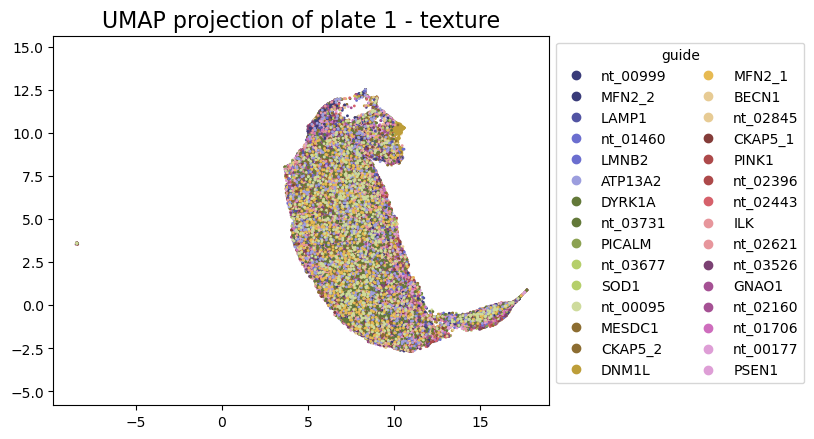

In [48]:
%%time
umap_plot_cpu(texture1, 'plate 1 - texture', 'guide', 1)

CPU times: user 28min 59s, sys: 29min 28s, total: 58min 27s
Wall time: 26.5 s


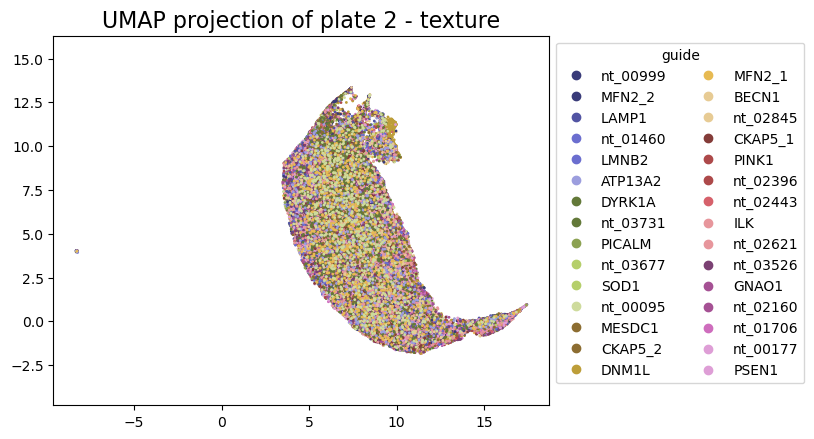

In [49]:
%%time
umap_plot_cpu(texture2, 'plate 2 - texture', 'guide', 1)

In [50]:
# %%time
# umap_plot_cpu(texture3, 'plate 3 - texture', 'guide', 1)

CPU times: user 29min 46s, sys: 29min 23s, total: 59min 10s
Wall time: 27.5 s


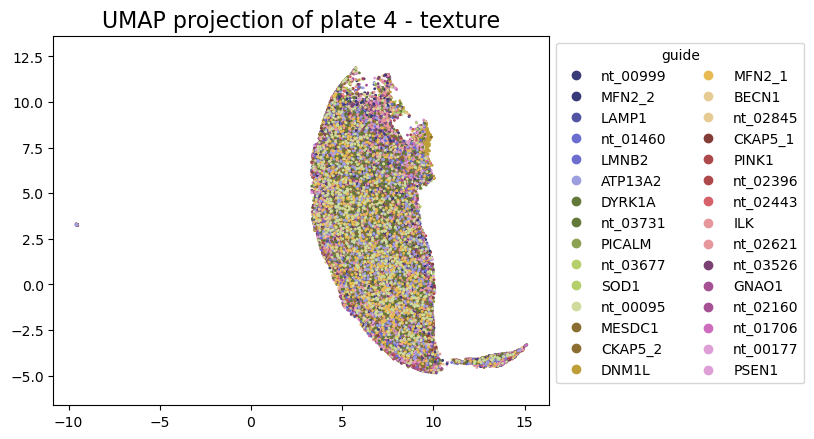

In [51]:
%%time
umap_plot_cpu(texture4, 'plate 4 - texture', 'guide', 1)

In [33]:
granularity = subset[[x for x in subset.columns if 'Granularity' in x] + ['guide']]
granularity.shape

(198941, 49)

In [73]:
granularity1 = subset1[[x for x in subset1.columns if 'Granularity' in x] + ['guide']]
granularity2 = subset2[[x for x in subset2.columns if 'Granularity' in x] + ['guide']]
# granularity3 = subset3[[x for x in subset3.columns if 'Granularity' in x] + ['guide']]
granularity4 = subset4[[x for x in subset4.columns if 'Granularity' in x] + ['guide']]
print(granularity1.shape)
print(granularity2.shape)
# print(granularity3.shape)
print(granularity4.shape)

(146230, 49)
(152150, 49)
(151096, 49)


CPU times: user 30min, sys: 31min 39s, total: 1h 1min 39s
Wall time: 27.1 s


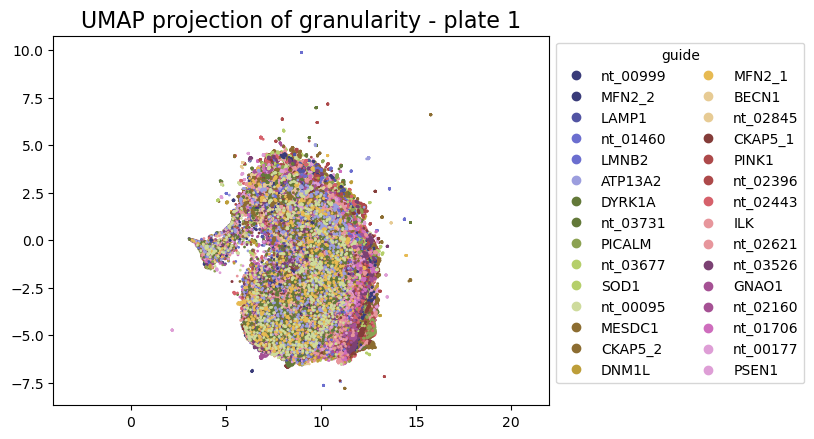

In [53]:
%%time
umap_plot_cpu(granularity1, 'granularity - plate 1', 'guide', 1)

CPU times: user 31min 33s, sys: 31min 10s, total: 1h 2min 44s
Wall time: 28.8 s


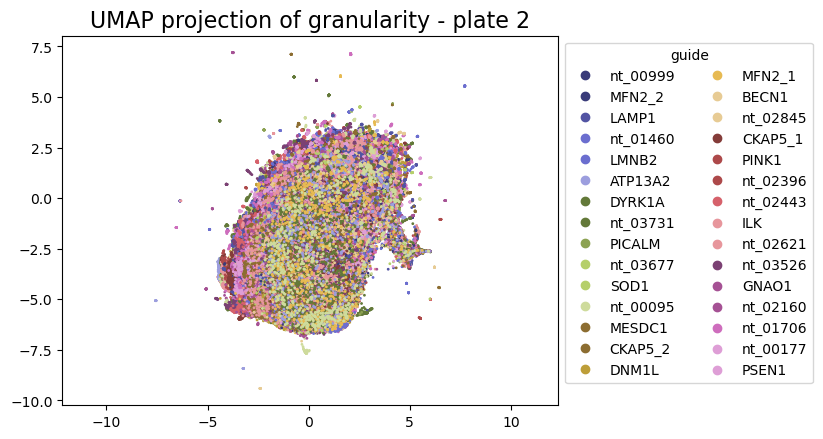

In [54]:
%%time
umap_plot_cpu(granularity2, 'granularity - plate 2', 'guide', 1)

In [55]:
# %%time
# umap_plot_cpu(granularity3, 'granularity - plate 3', 'guide', 1)

CPU times: user 31min 48s, sys: 28min 21s, total: 1h 9s
Wall time: 29 s


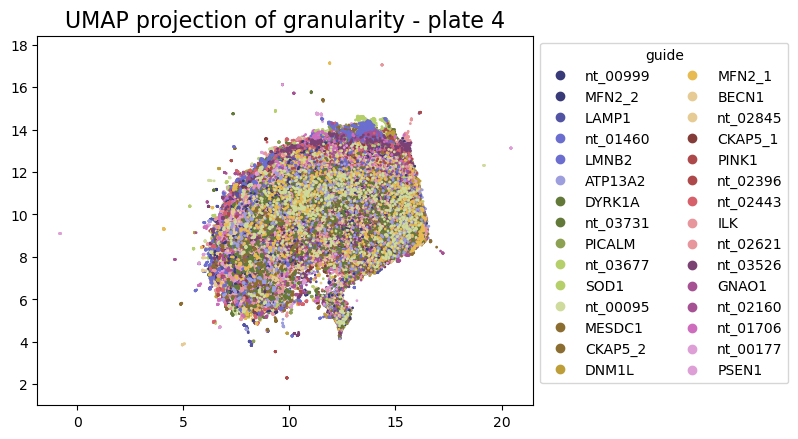

In [56]:
%%time
umap_plot_cpu(granularity4, 'granularity - plate 4', 'guide', 1)

CPU times: user 33min 28s, sys: 23min 32s, total: 57min
Wall time: 32.8 s


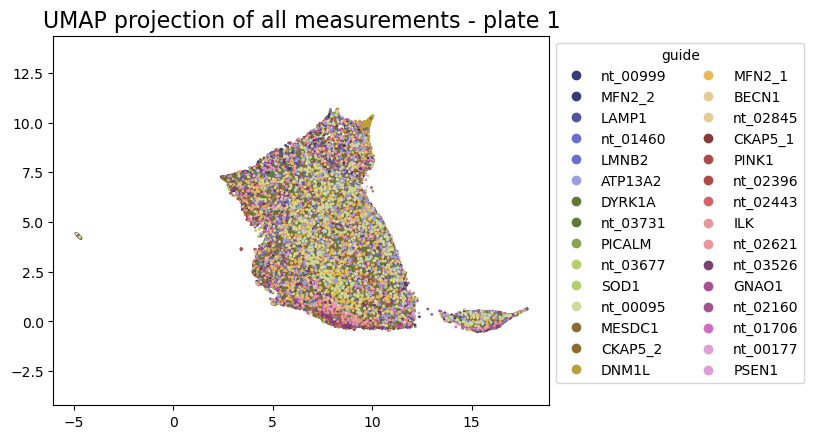

In [57]:
%%time
umap_plot_cpu(subset1, 'all measurements - plate 1', 'guide', 2)

CPU times: user 32min 55s, sys: 17min 22s, total: 50min 18s
Wall time: 34.4 s


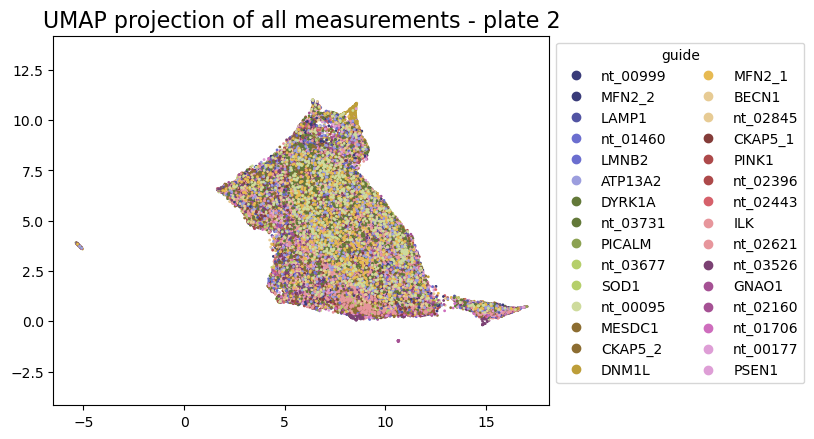

In [58]:
%%time
umap_plot_cpu(subset2, 'all measurements - plate 2', 'guide', 2)

In [59]:
# %%time
# umap_plot_cpu(subset3, 'all measurements - plate 3', 'guide', 2)

CPU times: user 32min 22s, sys: 20min 17s, total: 52min 39s
Wall time: 31 s


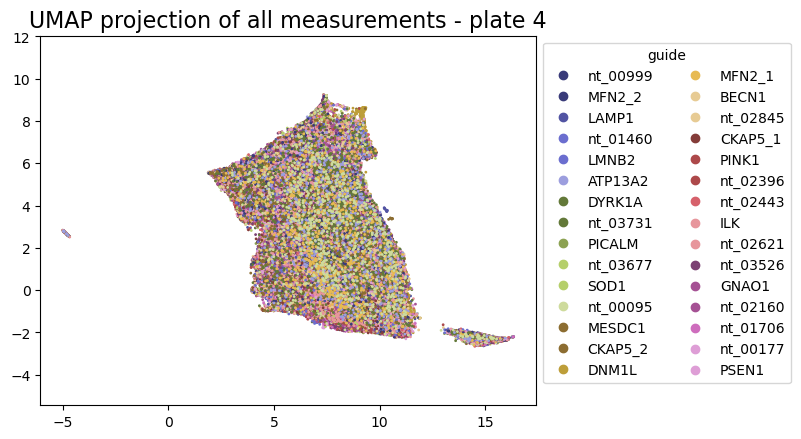

In [60]:
%%time
umap_plot_cpu(subset4, 'all measurements - plate 4', 'guide', 2)

In [61]:
# non-targeting only:
nt1 = subset1[subset1.guide.str.startswith('nt')]
nt2 = subset2[subset2.guide.str.startswith('nt')]
# nt3 = subset3[subset3.guide.str.startswith('nt')]
nt4 = subset4[subset4.guide.str.startswith('nt')]
print(nt1.shape)
print(nt2.shape)
# print(nt3.shape)
print(nt4.shape)

(65761, 360)
(68534, 360)
(69513, 360)


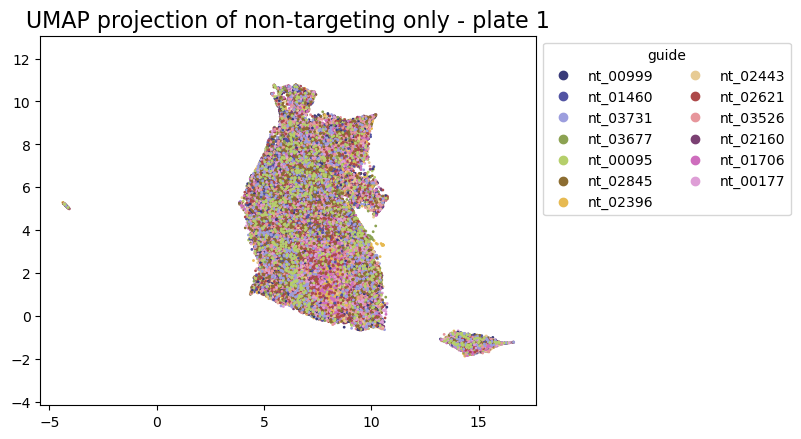

In [62]:
umap_plot_cpu(nt1, 'non-targeting only - plate 1', 'guide', 2)

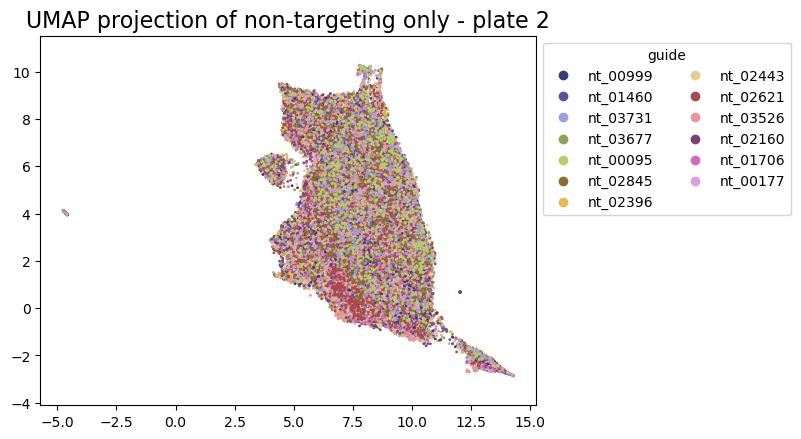

In [63]:
umap_plot_cpu(nt2, 'non-targeting only - plate 2', 'guide', 2)

In [64]:
# umap_plot_cpu(nt3, 'non-targeting only - plate 3', 'guide', 2)

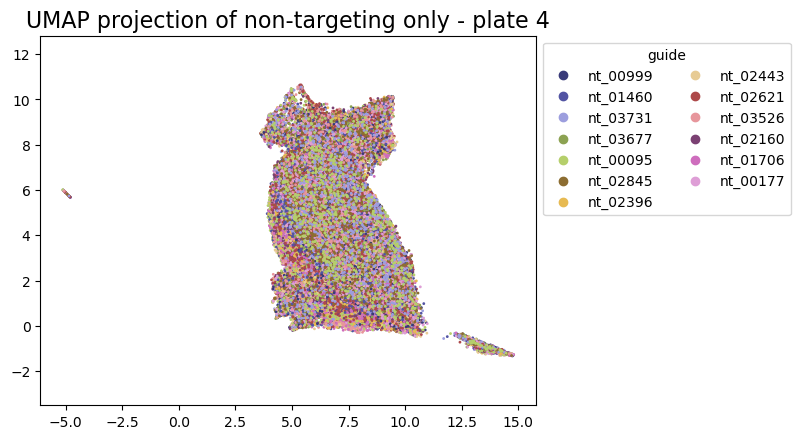

In [65]:
umap_plot_cpu(nt4, 'non-targeting only - plate 4', 'guide', 2)

In [74]:
# picking features based on standard deviations:
cols1 = [c for c in subset1.columns[:-2] if 2 < subset1[c].std() < 4]
cols2 = [c for c in subset2.columns[:-2] if 2 < subset2[c].std() < 4]
# cols3 = [c for c in subset3.columns[:-2] if 2 < subset3[c].std() < 4]
cols4 = [c for c in subset4.columns[:-2] if 2 < subset4[c].std() < 4]
print(len(cols1))
print(len(cols2))
# print(len(cols3))
print(len(cols4))

23
21
24


CPU times: user 27min 2s, sys: 38min 56s, total: 1h 5min 59s
Wall time: 24.9 s


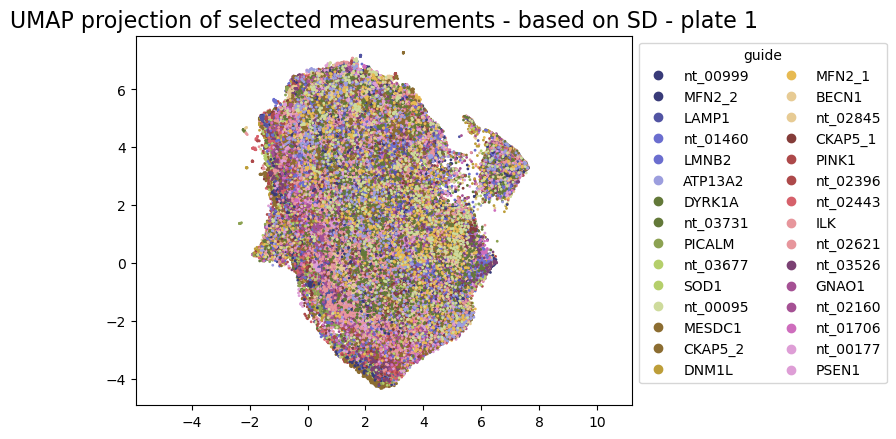

In [67]:
%%time
umap_plot_cpu(subset1[cols1 + ['guide']], 'selected measurements - based on SD - plate 1', 'guide', 1)

CPU times: user 28min 31s, sys: 36min 43s, total: 1h 5min 15s
Wall time: 26.1 s


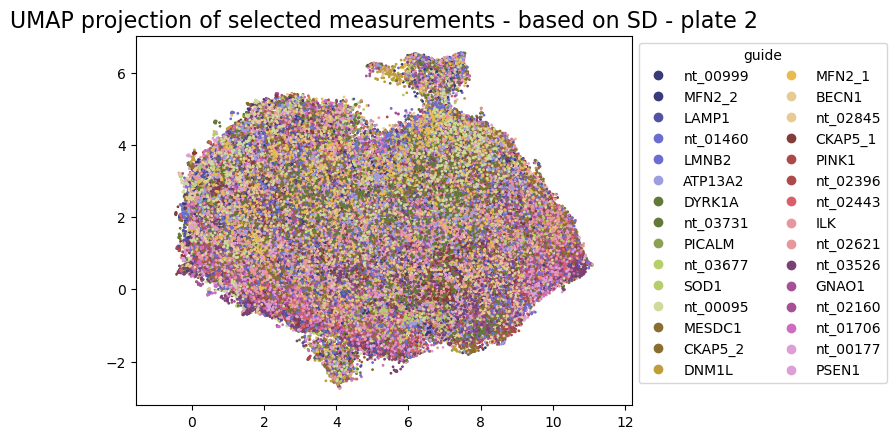

In [68]:
%%time
umap_plot_cpu(subset2[cols2 + ['guide']], 'selected measurements - based on SD - plate 2', 'guide', 1)

In [69]:
# %%time
# umap_plot_cpu(subset3[cols3 + ['guide']], 'selected measurements - based on SD - plate 3', 'guide', 1)

CPU times: user 28min 44s, sys: 38min 32s, total: 1h 7min 16s
Wall time: 26 s


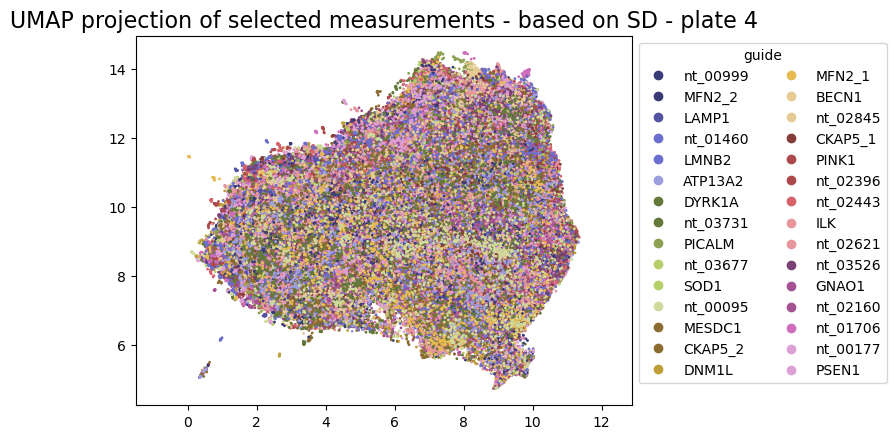

In [71]:
%%time
umap_plot_cpu(subset4[cols4 + ['guide']], 'selected measurements - based on SD - plate 4', 'guide', 1)

In [73]:
# area/shape measurements only:
area1 = subset1[[x for x in subset1.columns if 'Area' in x] + ['guide']]
area2 = subset2[[x for x in subset2.columns if 'Area' in x] + ['guide']]
# area3 = subset3[[x for x in subset3.columns if 'Area' in x] + ['guide']]
area4 = subset4[[x for x in subset4.columns if 'Area' in x] + ['guide']]
print(area1.shape)
print(area2.shape)
# print(area3.shape)
print(area4.shape)

(146230, 70)
(152150, 70)
(151096, 70)


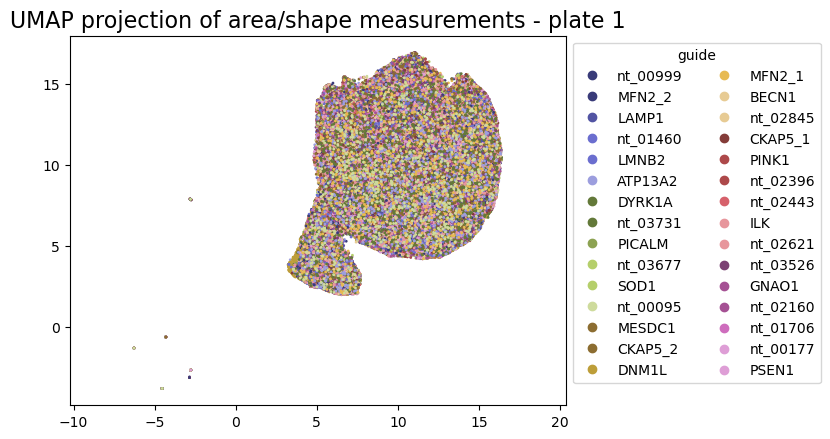

In [74]:
umap_plot_cpu(area1, 'area/shape measurements - plate 1', 'guide', 1)

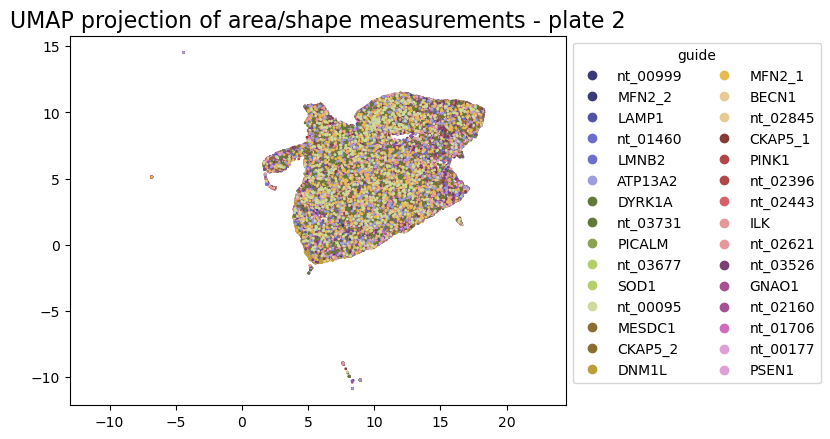

In [75]:
umap_plot_cpu(area2, 'area/shape measurements - plate 2', 'guide', 1)

In [76]:
# umap_plot_cpu(area3, 'area/shape measurements - plate 3', 'guide', 1)

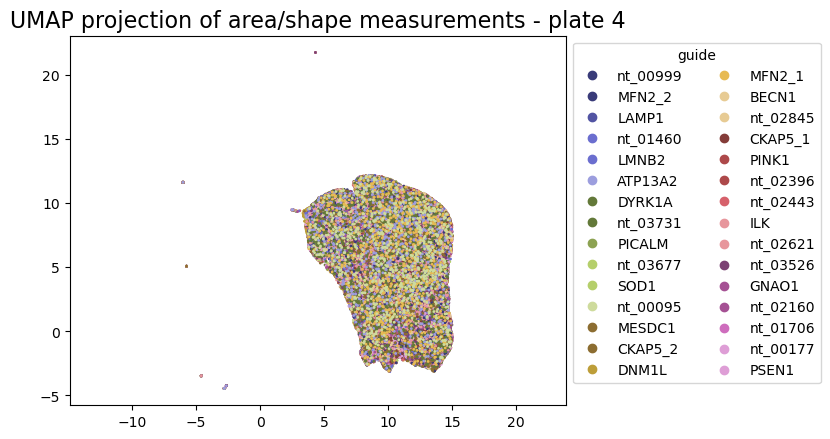

In [77]:
umap_plot_cpu(area4, 'area/shape measurements - plate 4', 'guide', 1)

## total variation normalization

In [80]:
# EFAAR benchmarking paper:
# https://www.biorxiv.org/content/10.1101/2022.12.09.519400v2.full
# https://github.com/recursionpharma/EFAAR_benchmarking/blob/trunk/efaar_benchmarking/efaar.py

In [75]:
import numpy as np
import pandas as pd
from scipy import linalg, sparse
# from scvi.model import SCVI
from sklearn.covariance import EllipticEnvelope
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.utils import Bunch

In [76]:
def centerscale_by_batch(
    features: np.ndarray, metadata: pd.DataFrame = None, batch_col: str | None = None
) -> np.ndarray:
    """
    Center and scale the input features by each batch. Not using any controls at all.
    We are using this prior to embedding high-dimensional data with PCA.

    Args:
        features (np.ndarray): Input features to be centered and scaled.
        metadata (pd.DataFrame): Metadata information for the input features.
        batch_col (str): Name of the column in metadata that contains batch information.

    Returns:
        np.ndarray: Centered and scaled features.
    """
    features = features.copy()
    if batch_col is None:
        features = StandardScaler().fit_transform(features)
    else:
        if metadata is None:
            raise ValueError("metadata must be provided if batch_col is not None")
        batches = metadata[batch_col].unique()
        for batch in batches:
            ind = metadata[batch_col] == batch
            features[ind, :] = StandardScaler().fit_transform(features[ind, :])
    return features


def embed_by_pca(
    features: np.ndarray,
    metadata: pd.DataFrame = None,
    variance_or_ncomp=128,
    batch_col: str | None = None,
) -> np.ndarray:
    """
    Embed the whole input data using principal component analysis (PCA).
    Note that we explicitly center & scale the data (by batch) before an embedding operation with `PCA`.
    Centering and scaling is done by batch if `batch_col` is not None, and on the whole data otherwise.
    Also note that `PCA` transformer also does mean-centering on the whole data prior to the PCA operation.

    Args:
        features (np.ndarray): Features to transform
        metadata (pd.DataFrame): Metadata. Defaults to None.
        variance_or_ncomp (float, optional): Variance or number of components to keep after PCA.
            Defaults to 128 (n_components). If between 0 and 1, select the number of components such that
            the amount of variance that needs to be explained is greater than the percentage specified.
            If 1, a single component is kept, and if None, all components are kept.
        batch_col (str, optional): Column name for batch information. Defaults to None.
    Returns:
        np.ndarray: Transformed data using PCA.
    """
    features = features.copy()
    features = centerscale_by_batch(features, metadata, batch_col)
    features = PCA(variance_or_ncomp).fit_transform(features)
    return features

In [77]:
pca_features1 = embed_by_pca(subset1[subset1.columns[:-2]].values, subset1[subset1.columns[-2:]])
pca_features2 = embed_by_pca(subset2[subset2.columns[:-2]].values, subset2[subset2.columns[-2:]])
# pca_features3 = embed_by_pca(subset3[subset3.columns[:-2]].values, subset3[subset3.columns[-2:]])
pca_features4 = embed_by_pca(subset4[subset4.columns[:-2]].values, subset4[subset4.columns[-2:]])

In [78]:
def centerscale_on_controls(
    embeddings: np.ndarray,
    metadata: pd.DataFrame,
    pert_col: str,
    control_key: str,
    batch_col: str | None = None,
) -> np.ndarray:
    """
    Center and scale the embeddings on the control perturbation units in the metadata.
    If batch information is provided, the embeddings are centered and scaled by batch.

    Args:
        embeddings (numpy.ndarray): The embeddings to be aligned.
        metadata (pandas.DataFrame): The metadata containing information about the embeddings.
        pert_col (str, optional): The column in the metadata containing perturbation information.
        control_key (str, optional): The key for non-targeting controls in the metadata.
        batch_col (str, optional): Column name in the metadata representing the batch labels.
            Defaults to None.
    Returns:
        numpy.ndarray: The aligned embeddings.
    """
    embeddings = embeddings.copy()
    if batch_col is not None:
        batches = metadata[batch_col].unique()
        for batch in batches:
            batch_ind = metadata[batch_col] == batch
            batch_control_ind = batch_ind & (metadata[pert_col] == control_key)
            embeddings[batch_ind] = StandardScaler().fit(embeddings[batch_control_ind]).transform(embeddings[batch_ind])
        return embeddings

    control_ind = metadata[pert_col] == control_key
    return StandardScaler().fit(embeddings[control_ind]).transform(embeddings)


In [79]:
pca_cs1 = centerscale_on_controls(pca_features1, subset1[subset1.columns[-2:]], pert_col='guide', control_key='nt_00095')
pca_cs2 = centerscale_on_controls(pca_features2, subset2[subset2.columns[-2:]], pert_col='guide', control_key='nt_00095')
# pca_cs3 = centerscale_on_controls(pca_features3, subset3[subset3.columns[-2:]], pert_col='guide', control_key='nt_00095')
pca_cs4 = centerscale_on_controls(pca_features4, subset4[subset4.columns[-2:]], pert_col='guide', control_key='nt_00095')

In [80]:
def tvn_on_controls(
    embeddings: np.ndarray,
    metadata: pd.DataFrame,
    pert_col: str,
    control_key: str,
    batch_col: str | None = None,
) -> np.ndarray:
    """
    Apply TVN (Typical Variation Normalization) to the data based on the control perturbation units.
    Note that the data is first centered and scaled based on the control units.

    Args:
        embeddings (np.ndarray): The embeddings to be normalized.
        metadata (pd.DataFrame): The metadata containing information about the samples.
        pert_col (str): The column name in the metadata DataFrame that represents the perturbation labels.
        control_key (str): The control perturbation label.
        batch_col (str, optional): Column name in the metadata DataFrame representing the batch labels
            to be used for CORAL normalization. Defaults to None.

    Returns:
        np.ndarray: The normalized embeddings.
    """
    embeddings = embeddings.copy()
    embeddings = centerscale_on_controls(embeddings, metadata, pert_col, control_key)
    ctrl_ind = metadata[pert_col] == control_key
    embeddings = PCA().fit(embeddings[ctrl_ind]).transform(embeddings)
    embeddings = centerscale_on_controls(embeddings, metadata, pert_col, control_key)
    if batch_col is not None:
        batches = metadata[batch_col].unique()
        for batch in batches:
            batch_ind = metadata[batch_col] == batch
            batch_control_ind = batch_ind & (metadata[pert_col] == control_key)
            source_cov = np.cov(embeddings[batch_control_ind], rowvar=False, ddof=1) + 0.5 * np.eye(embeddings.shape[1])
            source_cov_half_inv = linalg.fractional_matrix_power(source_cov, -0.5)
            embeddings[batch_ind] = np.matmul(embeddings[batch_ind], source_cov_half_inv)
    return embeddings

In [81]:
tvn1 = tvn_on_controls(pca_cs1, subset1[subset1.columns[-2:]], pert_col='guide', control_key='nt_00095')
tvn2 = tvn_on_controls(pca_cs2, subset2[subset2.columns[-2:]], pert_col='guide', control_key='nt_00095')
# tvn3 = tvn_on_controls(pca_cs3, subset3[subset3.columns[-2:]], pert_col='guide', control_key='nt_00095')
tvn4 = tvn_on_controls(pca_cs4, subset4[subset4.columns[-2:]], pert_col='guide', control_key='nt_00095')

In [82]:
pca_df1 = pandas.concat([pandas.DataFrame(data = tvn1[:,:2], columns = ['pc1', 'pc2']), subset1[subset1.columns[-2:]]], axis=1)
pca_df2 = pandas.concat([pandas.DataFrame(data = tvn2[:,:2], columns = ['pc1', 'pc2']), subset2[subset2.columns[-2:]]], axis=1)
# pca_df3 = pandas.concat([pandas.DataFrame(data = tvn3[:,:2], columns = ['pc1', 'pc2']), subset3[subset3.columns[-2:]]], axis=1)
pca_df4 = pandas.concat([pandas.DataFrame(data = tvn4[:,:2], columns = ['pc1', 'pc2']), subset4[subset4.columns[-2:]]], axis=1)

In [95]:
def umap_plot(table, kind, feature, n):
    # table = t.to_pandas()
    scaled_cells = StandardScaler().fit_transform(table[table.columns[:-n]].values)
    reducer = umap.UMAP()
    embedding = reducer.fit_transform(scaled_cells)
    
    colors_map = {idx: i for i, idx in enumerate(table[feature].unique())}
    colors_map_reverse = {i: idx for i, idx in enumerate(table[feature].unique())}

    c = [colors_map[idx] for idx in table[feature]]


    colors = [f"C{i}" for i, idx in enumerate(table[feature].unique())]
    cmap, norm = matplotlib.colors.from_levels_and_colors(range(min(c), max(c)+2), plt.cm.tab20b_r(numpy.linspace(0,1,len(table[feature].unique()))))

    fig, ax = plt.subplots()
    plt.gca().set_aspect('equal', 'datalim')
    plt.title('UMAP projection of ' + kind, fontsize=16)
    scatter1 = ax.scatter(embedding[:, 0], embedding[:, 1], c=c, cmap=cmap, norm=norm, s=1)
    if table[feature].nunique() < 6:
        ax.legend(scatter1.legend_elements()[0], [colors_map_reverse[i] for i in range(len(table[feature].unique()))],
          bbox_to_anchor=(1, 1), title=str(feature))#, ncols=2)
    else:
        ax.legend(scatter1.legend_elements(num=len(table[feature].unique()))[0], [colors_map_reverse[i] for i in range(len(table[feature].unique()))],
          bbox_to_anchor=(1, 1), title=str(feature), ncols=2)

In [99]:
tvn_df1 = pandas.concat([pandas.DataFrame(data = tvn1, columns = ['pc'+ str(i) for i in range(1, tvn1.shape[1]+1)]), subset1[subset1.columns[-2:]]], axis=1)
tvn_df2 = pandas.concat([pandas.DataFrame(data = tvn2, columns = ['pc'+ str(i) for i in range(1, tvn2.shape[1]+1)]), subset2[subset2.columns[-2:]]], axis=1)
# tvn_df3 = pandas.concat([pandas.DataFrame(data = tvn3, columns = ['pc'+ str(i) for i in range(1, tvn3.shape[1]+1)]), subset3[subset3.columns[-2:]]], axis=1)
tvn_df4 = pandas.concat([pandas.DataFrame(data = tvn4, columns = ['pc'+ str(i) for i in range(1, tvn4.shape[1]+1)]), subset4[subset4.columns[-2:]]], axis=1)

In [105]:
# granularity
tvn_df1 = pandas.concat([pandas.DataFrame(data = tvn1, columns = ['pc'+ str(i) for i in range(1, tvn1.shape[1]+1)]), granularity1[granularity1.columns[-1:]]], axis=1)
tvn_df2 = pandas.concat([pandas.DataFrame(data = tvn2, columns = ['pc'+ str(i) for i in range(1, tvn2.shape[1]+1)]), granularity2[granularity2.columns[-1:]]], axis=1)
tvn_df3 = pandas.concat([pandas.DataFrame(data = tvn3, columns = ['pc'+ str(i) for i in range(1, tvn3.shape[1]+1)]), granularity3[granularity3.columns[-1:]]], axis=1)
tvn_df4 = pandas.concat([pandas.DataFrame(data = tvn4, columns = ['pc'+ str(i) for i in range(1, tvn4.shape[1]+1)]), granularity4[granularity4.columns[-1:]]], axis=1)

In [86]:
print(tvn_df1.shape)
tvn_df1.dropna(axis='rows', inplace=True)
print(tvn_df1.shape)

(70051, 130)
(70051, 130)


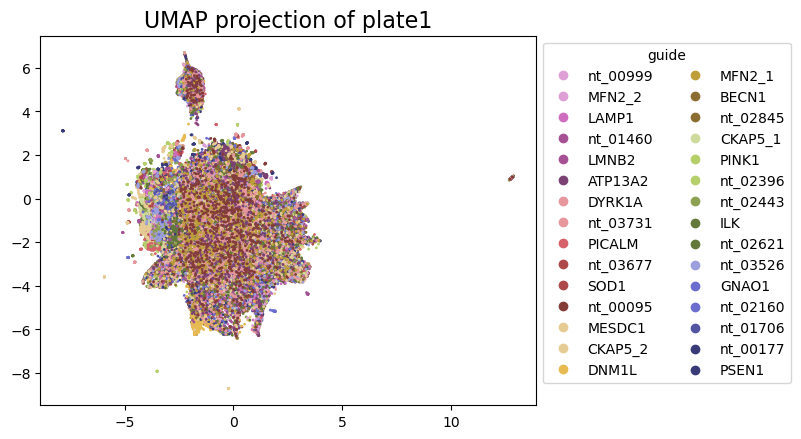

In [97]:
# scaling to NT_00095:
umap_plot(tvn_df1, 'plate1', 'guide', 2)

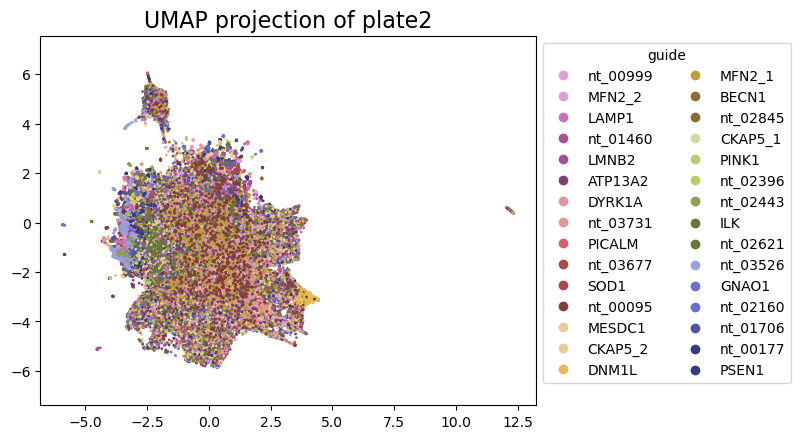

In [98]:
umap_plot(tvn_df2, 'plate2', 'guide', 2)

In [99]:
# umap_plot(tvn_df3, 'plate3', 'guide', 2)

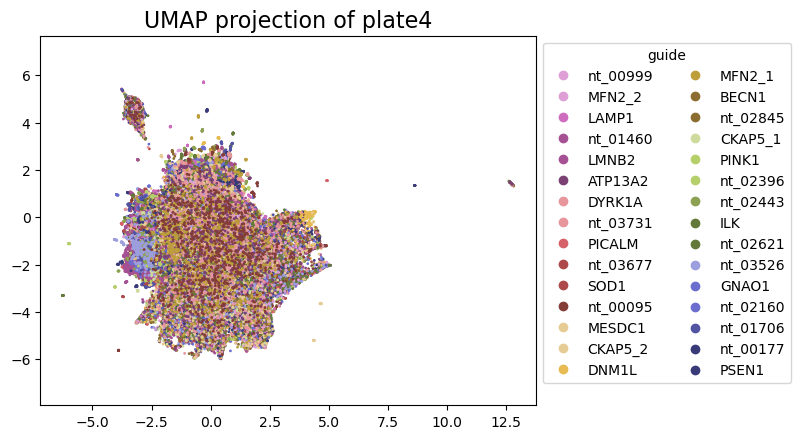

In [100]:
umap_plot(tvn_df4, 'plate4', 'guide', 2)

In [109]:
print(tvn_df1.shape)
tvn_df1.dropna(axis='rows', inplace=True)
print(tvn_df1.shape)

(70051, 49)
(70049, 49)


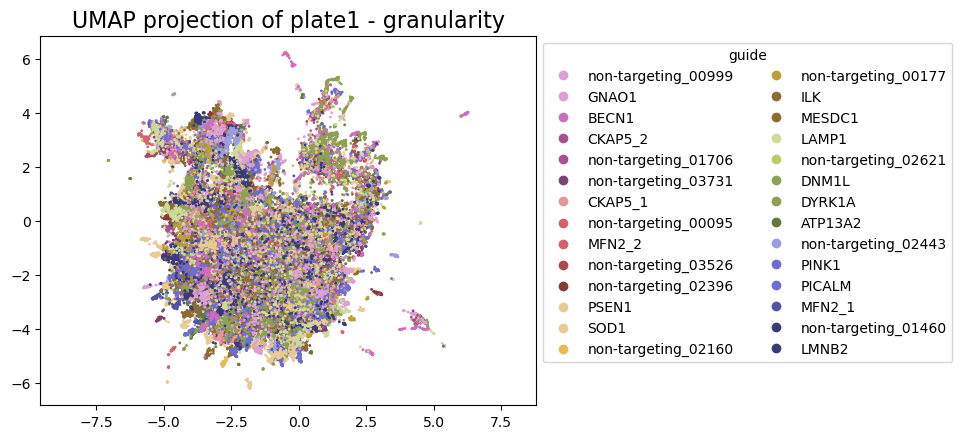

In [110]:
# scaling to NT_00999:
umap_plot(tvn_df1, 'plate1 - granularity', 'guide', 1)

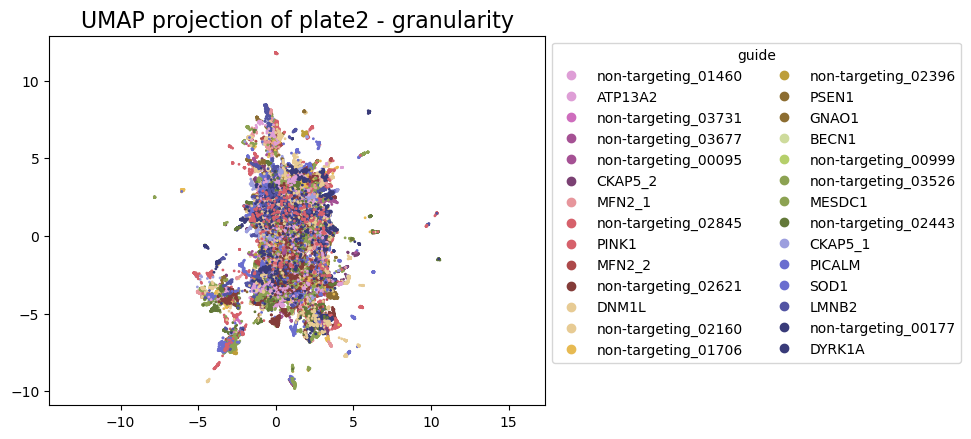

In [112]:
umap_plot(tvn_df2, 'plate2 - granularity', 'guide', 1)

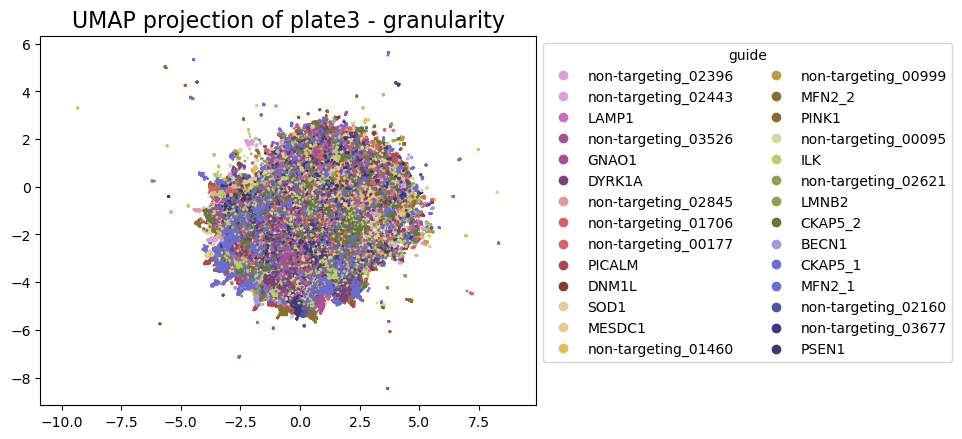

In [113]:
umap_plot(tvn_df3, 'plate3 - granularity', 'guide', 1)

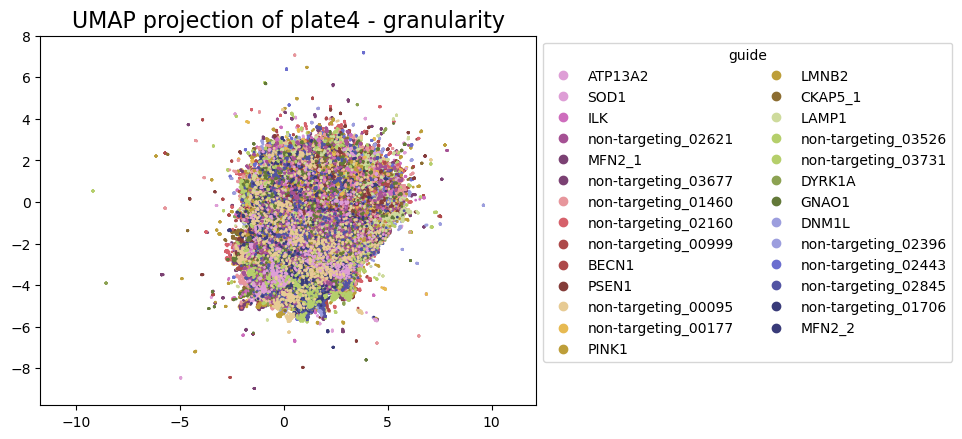

In [114]:
umap_plot(tvn_df4, 'plate4 - granularity', 'guide', 1)

In [114]:
# batch correction w/ harmony
# https://github.com/slowkow/harmonypy

In [116]:
# pip install harmonypy
# Successfully installed harmonypy-0.0.10

In [41]:
# tvn_df = pandas.concat([pandas.DataFrame(data = tvn, columns = ['pc'+ str(i) for i in range(1, tvn.shape[1]+1)]), subset.to_pandas()[subset.columns[-2:]]], axis=1)

In [101]:
meta_data1 = subset1[subset1.columns[-2:]]
meta_data2 = subset2[subset2.columns[-2:]]
# meta_data3 = subset3[subset3.columns[-2:]]
meta_data4 = subset4[subset4.columns[-2:]]

In [115]:
# granularity:
meta_data1 = granularity1[granularity1.columns[-2:]]
meta_data2 = granularity2[granularity2.columns[-2:]]
meta_data3 = granularity3[granularity3.columns[-2:]]
meta_data4 = granularity4[granularity4.columns[-2:]]

In [102]:
meta_data1['plate'] = 'plate1'
meta_data2['plate'] = 'plate2'
# meta_data3['plate'] = 'plate3'
meta_data4['plate'] = 'plate4'

meta_data = pandas.concat([meta_data1, meta_data2, meta_data4], axis=0)
meta_data.reset_index(inplace=True, drop=True)
meta_data.shape

(449476, 3)

In [103]:
data_mat = numpy.concatenate((tvn1, tvn2, tvn4), axis=0)
data_mat.shape

(449476, 128)

In [104]:
import harmonypy

In [105]:
harmony = harmonypy.run_harmony(data_mat, meta_data, ['plate'], max_iter_harmony=25)

2025-01-16 16:51:48,275 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2025-01-16 16:52:04,066 - harmonypy - INFO - sklearn.KMeans initialization complete.
2025-01-16 16:52:04,783 - harmonypy - INFO - Iteration 1 of 25
2025-01-16 16:53:36,870 - harmonypy - INFO - Iteration 2 of 25
2025-01-16 16:55:17,504 - harmonypy - INFO - Iteration 3 of 25
2025-01-16 16:57:36,468 - harmonypy - INFO - Iteration 4 of 25
2025-01-16 16:59:56,069 - harmonypy - INFO - Iteration 5 of 25
2025-01-16 17:00:57,107 - harmonypy - INFO - Iteration 6 of 25
2025-01-16 17:01:46,443 - harmonypy - INFO - Iteration 7 of 25
2025-01-16 17:02:26,955 - harmonypy - INFO - Iteration 8 of 25
2025-01-16 17:03:03,005 - harmonypy - INFO - Iteration 9 of 25
2025-01-16 17:03:43,491 - harmonypy - INFO - Iteration 10 of 25
2025-01-16 17:04:19,684 - harmonypy - INFO - Iteration 11 of 25
2025-01-16 17:04:55,633 - harmonypy - INFO - Iteration 12 of 25
2025-01-16 17:05:31,780 - harmonypy - INFO - Iteration 13 of

In [47]:
# conda install -c conda-forge pynndescent

In [106]:
harmonized = pandas.DataFrame(harmony.Z_corr).T
harmonized.columns = ['pc{}'.format(i + 1) for i in range(harmonized.shape[1])]
hm_tvn = pandas.concat([harmonized, meta_data], axis=1)

print(hm_tvn.shape)
hm_tvn.head()

(449476, 131)


,pc1,pc2,pc3,pc4,pc5,pc6,pc7,pc8,pc9,pc10,...,pc122,pc123,pc124,pc125,pc126,pc127,pc128,well,guide,plate
0,0.126329,-0.241563,0.049968,0.595372,0.077337,0.020824,-0.037681,1.986955,0.127093,0.179358,...,-0.080659,0.399834,-0.863031,-0.128229,-1.533363,0.259110,2907.032495,C03,nt_00999,plate1
1,-0.088128,-0.332799,0.282734,0.120948,-0.102935,0.435583,-0.583469,0.638450,-0.361771,-1.043402,...,0.172537,0.945419,-0.473179,0.112065,-0.764766,0.525320,2906.056607,C03,nt_00999,plate1
2,-0.126637,-0.051118,-0.301729,-0.559077,0.487736,0.170590,0.812688,0.162047,-0.354736,-0.432799,...,-0.618611,-0.229030,-0.649712,-0.920790,-0.151247,0.283494,2906.095432,C03,nt_00999,plate1
3,-0.822148,-0.486577,-0.067549,0.271565,-1.043735,-0.564275,1.113898,0.045393,-1.182215,0.135273,...,0.722330,0.133629,-1.075516,-0.766717,0.936201,0.365628,2905.221158,C03,nt_00999,plate1
4,0.046338,-0.517560,0.101526,-0.373627,0.708875,0.733035,0.547316,0.693883,-0.106443,-1.721053,...,-0.499579,0.423855,-0.491622,0.286134,1.781685,-0.059275,2908.142442,C03,nt_00999,plate1


In [107]:
orig = pandas.DataFrame(data_mat)
orig.columns = ['pc{}'.format(i + 1) for i in range(orig.shape[1])]
orig_tvn = pandas.concat([orig, meta_data], axis=1)
print(orig_tvn.shape)

(449476, 131)


In [108]:
def umap_plot_harmony(table, kind, feature1, feature2, n):
    scaled_cells = StandardScaler().fit_transform(table[table.columns[:-n]].values)
    reducer = umap.UMAP()
    embedding = reducer.fit_transform(scaled_cells)
    
    colors_map1 = {idx: i for i, idx in enumerate(table[feature1].unique())}
    colors_map_reverse1 = {i: idx for i, idx in enumerate(table[feature1].unique())}
    c1 = [colors_map1[idx] for idx in table[feature1]]
    colors1 = [f"C{i}" for i, idx in enumerate(table[feature1].unique())]
    cmap1, norm1 = matplotlib.colors.from_levels_and_colors(range(min(c1), max(c1)+2), plt.cm.tab20b_r(numpy.linspace(0,1,len(table[feature1].unique()))))

    colors_map2 = {idx: i for i, idx in enumerate(table[feature2].unique())}
    colors_map_reverse2 = {i: idx for i, idx in enumerate(table[feature2].unique())}
    c2 = [colors_map2[idx] for idx in table[feature2]]
    colors2 = [f"C{i}" for i, idx in enumerate(table[feature2].unique())]
    cmap2, norm2 = matplotlib.colors.from_levels_and_colors(range(min(c2), max(c2)+2), plt.cm.tab20b_r(numpy.linspace(0,1,len(table[feature2].unique()))))



    fig1, ax1 = plt.subplots()
    plt.gca().set_aspect('equal', 'datalim')
    plt.title('UMAP projection of ' + kind, fontsize=16)
    scatter1 = ax1.scatter(embedding[:, 0], embedding[:, 1], c=c1, cmap=cmap1, norm=norm1, s=.5)
    ax1.legend(scatter1.legend_elements(num=len(table[feature1].unique()))[0], [colors_map_reverse1[i] for i in range(len(table[feature1].unique()))],
          bbox_to_anchor=(1, 1), title=str(feature1), ncols=2)

    fig2, ax2 = plt.subplots()
    plt.gca().set_aspect('equal', 'datalim')
    plt.title('UMAP projection of ' + kind, fontsize=16)
    scatter2 = ax2.scatter(embedding[:, 0], embedding[:, 1], c=c2, cmap=cmap2, norm=norm2, s=.5)
    ax2.legend(scatter2.legend_elements()[0], [colors_map_reverse2[i] for i in range(len(table[feature2].unique()))],
          bbox_to_anchor=(1, 1), title=str(feature2))#, ncols=2)


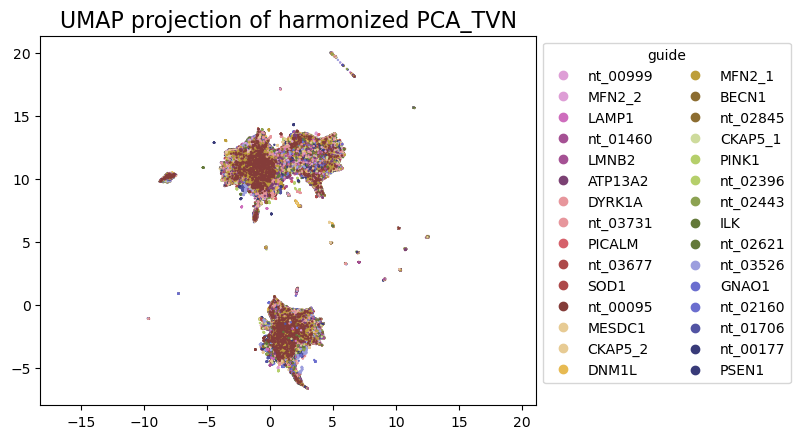

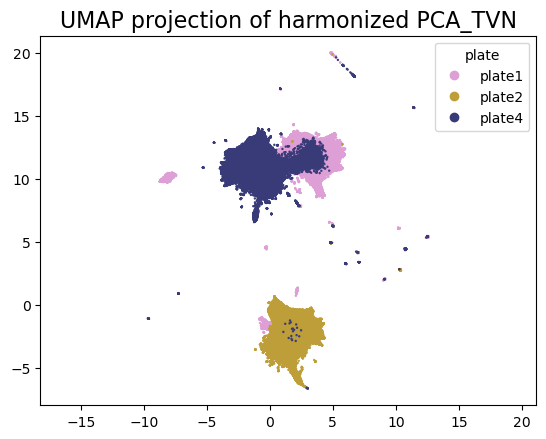

In [109]:
umap_plot_harmony(hm_tvn, 'harmonized PCA_TVN', 'guide', 'plate', 3)

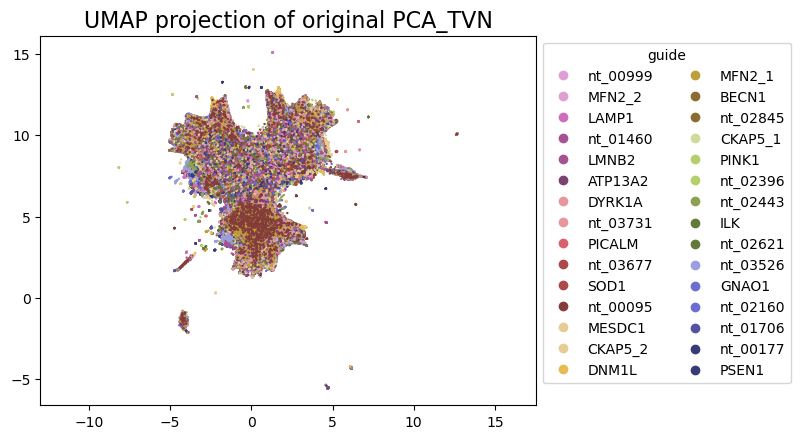

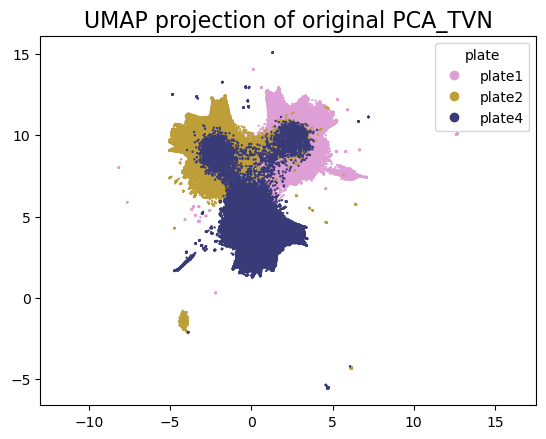

In [110]:
umap_plot_harmony(orig_tvn, 'original PCA_TVN', 'guide', 'plate', 3)

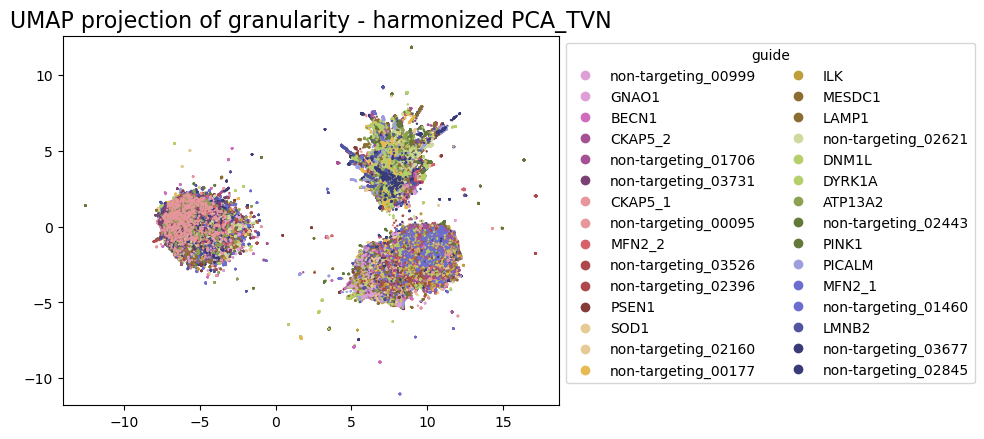

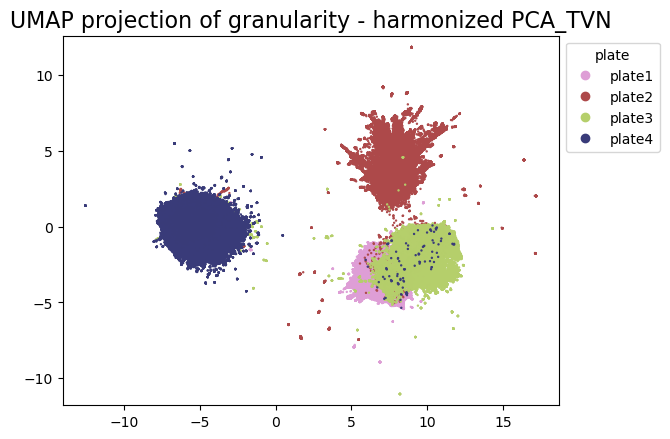

In [123]:
umap_plot_harmony(hm_tvn, 'granularity - harmonized PCA_TVN', 'guide', 'plate', 2)

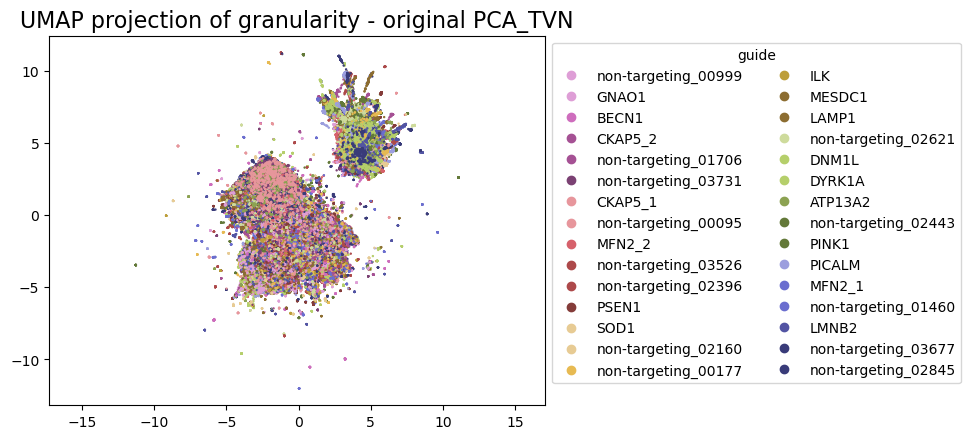

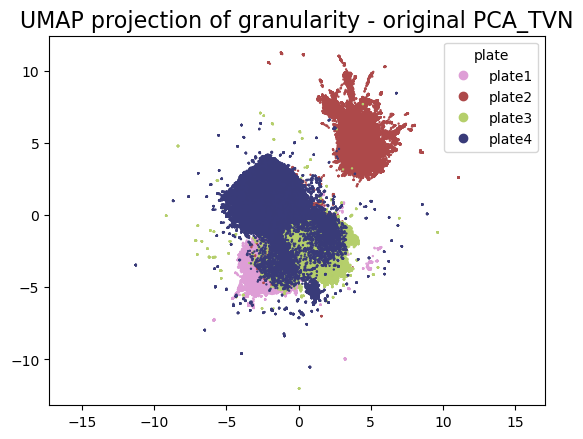

In [124]:
umap_plot_harmony(orig_tvn, 'granularity - original PCA_TVN', 'guide', 'plate', 2)

### measuring distributional shifts between treatments:

In [289]:
import scipy.stats as stats

array([<Axes: title={'center': 'ATP13A2'}>,
       <Axes: title={'center': 'BECN1'}>,
       <Axes: title={'center': 'CKAP5_1'}>,
       <Axes: title={'center': 'CKAP5_2'}>,
       <Axes: title={'center': 'DNM1L'}>,
       <Axes: title={'center': 'DYRK1A'}>,
       <Axes: title={'center': 'GNAO1'}>, <Axes: title={'center': 'ILK'}>,
       <Axes: title={'center': 'LAMP1'}>,
       <Axes: title={'center': 'LMNB2'}>,
       <Axes: title={'center': 'MESDC1'}>,
       <Axes: title={'center': 'MFN2_1'}>,
       <Axes: title={'center': 'MFN2_2'}>,
       <Axes: title={'center': 'PICALM'}>,
       <Axes: title={'center': 'PINK1'}>,
       <Axes: title={'center': 'PSEN1'}>,
       <Axes: title={'center': 'SOD1'}>,
       <Axes: title={'center': 'nt_00095'}>,
       <Axes: title={'center': 'nt_00177'}>,
       <Axes: title={'center': 'nt_00999'}>,
       <Axes: title={'center': 'nt_01460'}>,
       <Axes: title={'center': 'nt_01706'}>,
       <Axes: title={'center': 'nt_02160'}>,
       <Axes: t

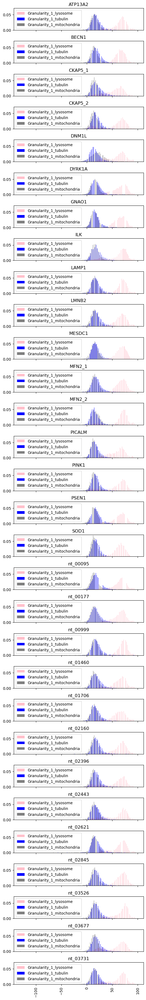

In [111]:
# plate 1:
p1[['Granularity_1_lysosome', 'Granularity_1_tubulin', 
    'Granularity_1_mitochondria', 'guide']].hist(bins=100, layout=(p1.guide.nunique(),1), figsize=(6,48), by='guide', legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True, density=True)

guide
ATP13A2     Axes(0.125,0.11;0.775x0.77)
BECN1       Axes(0.125,0.11;0.775x0.77)
CKAP5_1     Axes(0.125,0.11;0.775x0.77)
CKAP5_2     Axes(0.125,0.11;0.775x0.77)
DNM1L       Axes(0.125,0.11;0.775x0.77)
DYRK1A      Axes(0.125,0.11;0.775x0.77)
GNAO1       Axes(0.125,0.11;0.775x0.77)
ILK         Axes(0.125,0.11;0.775x0.77)
LAMP1       Axes(0.125,0.11;0.775x0.77)
LMNB2       Axes(0.125,0.11;0.775x0.77)
MESDC1      Axes(0.125,0.11;0.775x0.77)
MFN2_1      Axes(0.125,0.11;0.775x0.77)
MFN2_2      Axes(0.125,0.11;0.775x0.77)
PICALM      Axes(0.125,0.11;0.775x0.77)
PINK1       Axes(0.125,0.11;0.775x0.77)
PSEN1       Axes(0.125,0.11;0.775x0.77)
SOD1        Axes(0.125,0.11;0.775x0.77)
nt_00095    Axes(0.125,0.11;0.775x0.77)
nt_00177    Axes(0.125,0.11;0.775x0.77)
nt_00999    Axes(0.125,0.11;0.775x0.77)
nt_01460    Axes(0.125,0.11;0.775x0.77)
nt_01706    Axes(0.125,0.11;0.775x0.77)
nt_02160    Axes(0.125,0.11;0.775x0.77)
nt_02396    Axes(0.125,0.11;0.775x0.77)
nt_02443    Axes(0.125,0.11;0.775x

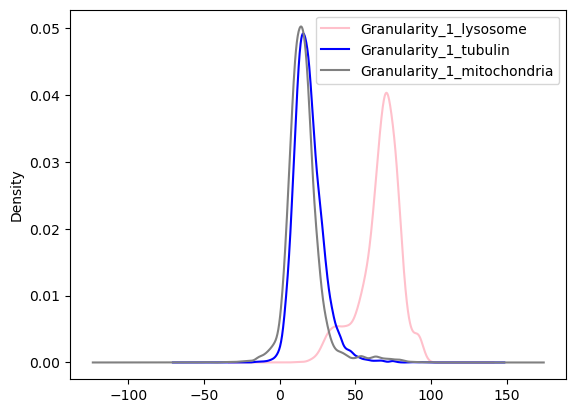

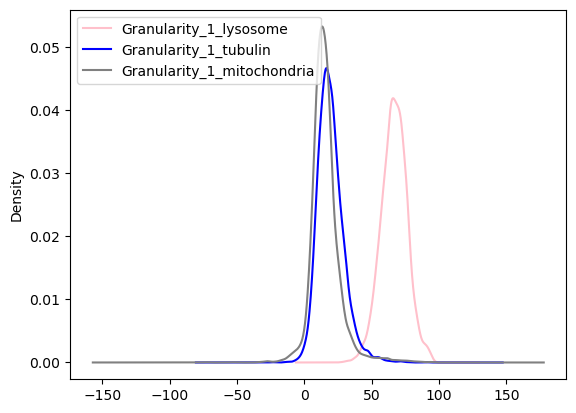

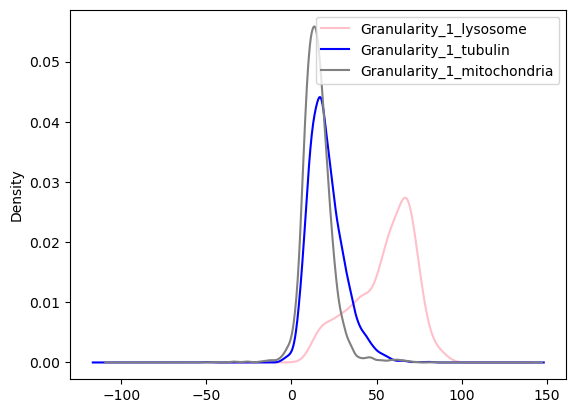

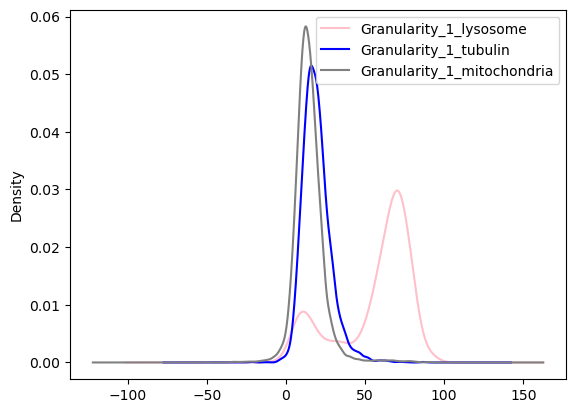

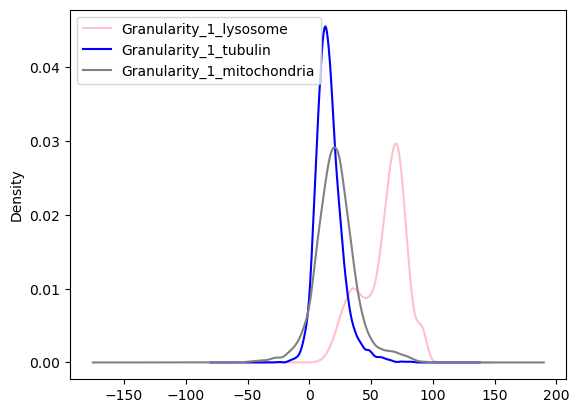

...

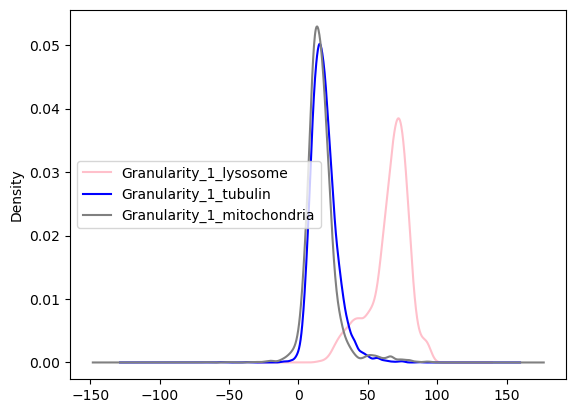

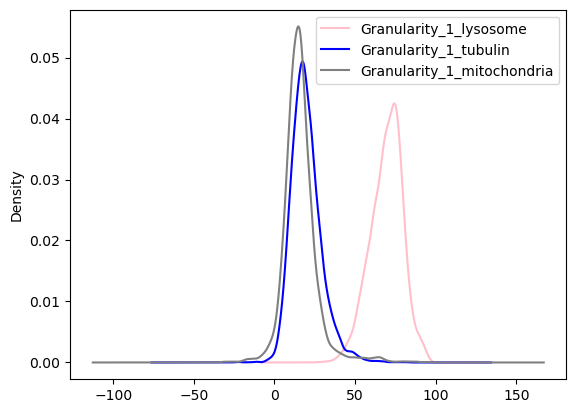

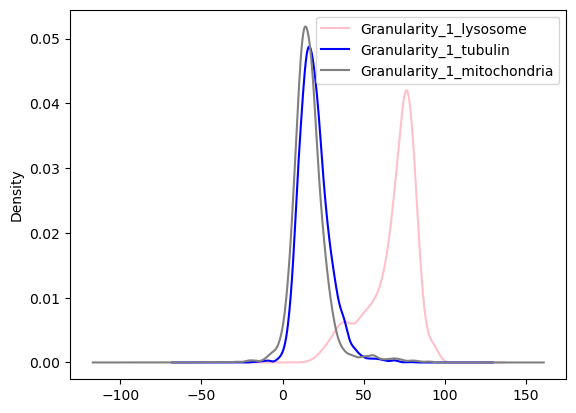

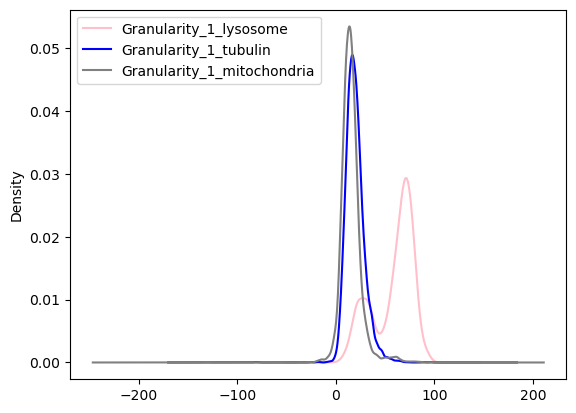

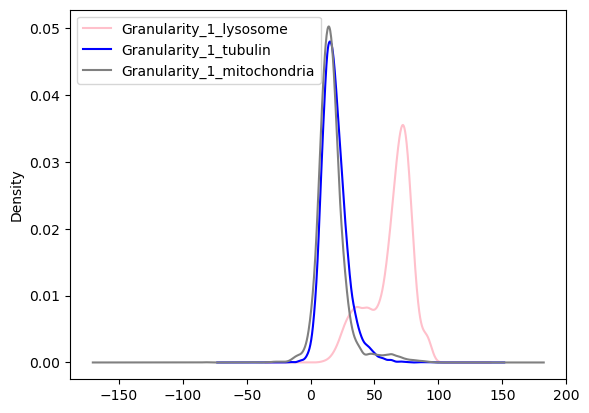

In [112]:
p1[['Granularity_1_lysosome', 'Granularity_1_tubulin', 
    'Granularity_1_mitochondria', 'guide']].groupby('guide').plot.kde(layout=(p1.guide.nunique(),1), legend=True, color=['pink', 'b', 'grey'], sharex=True, sharey=True)

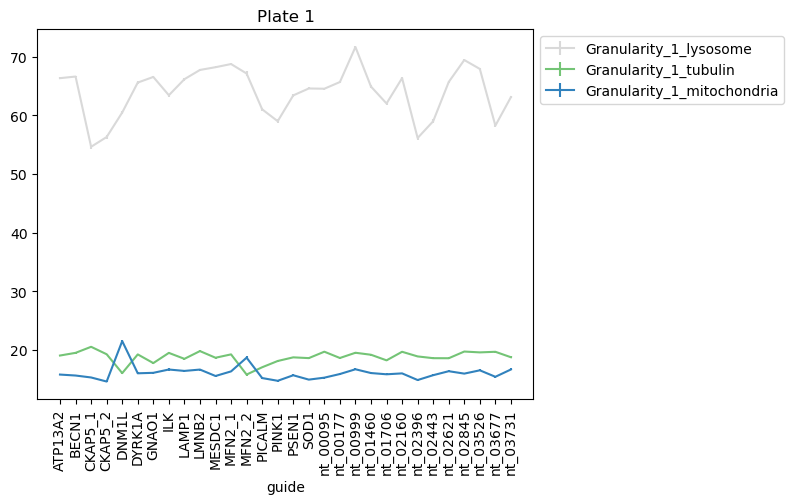

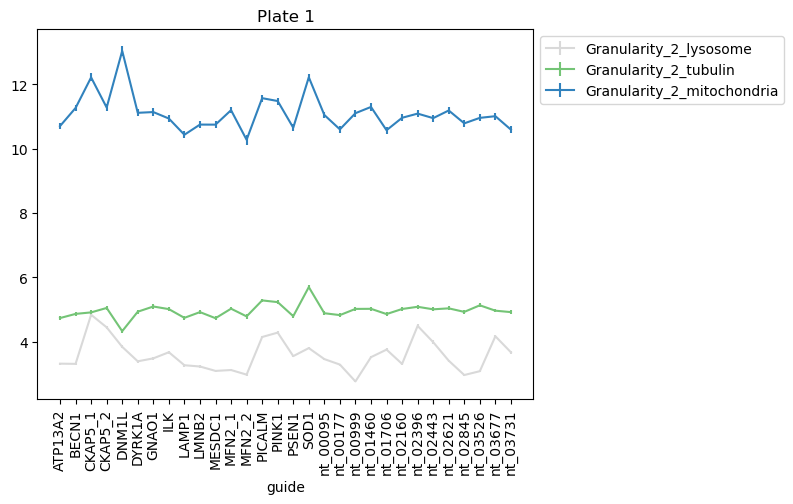

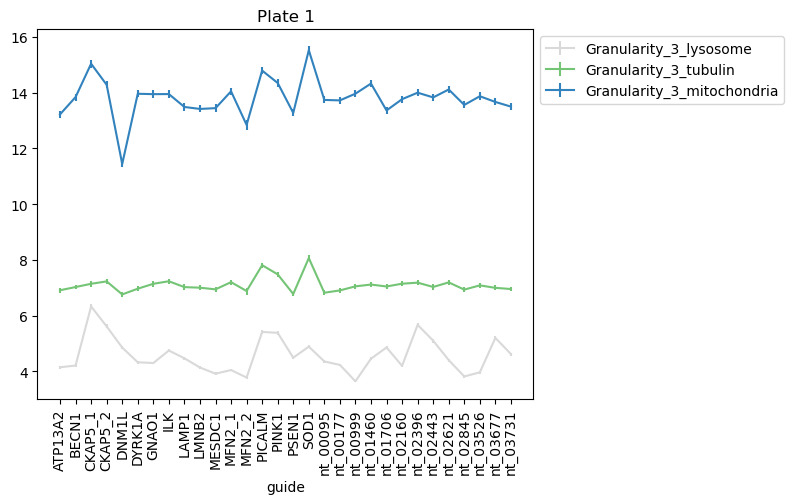

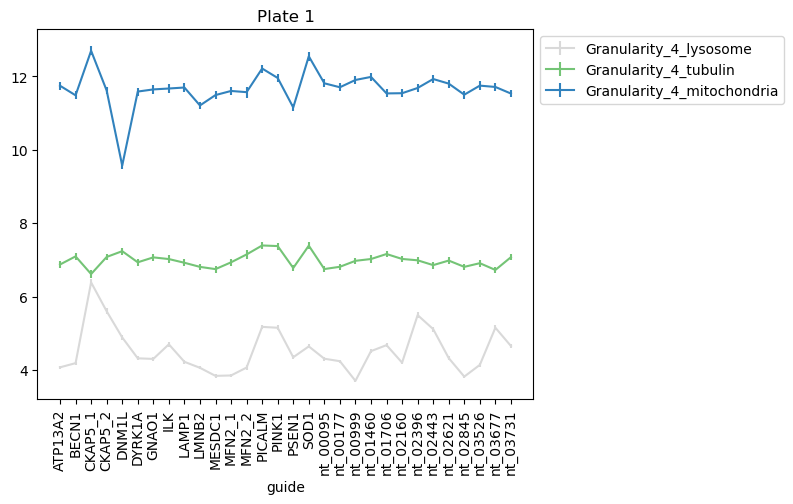

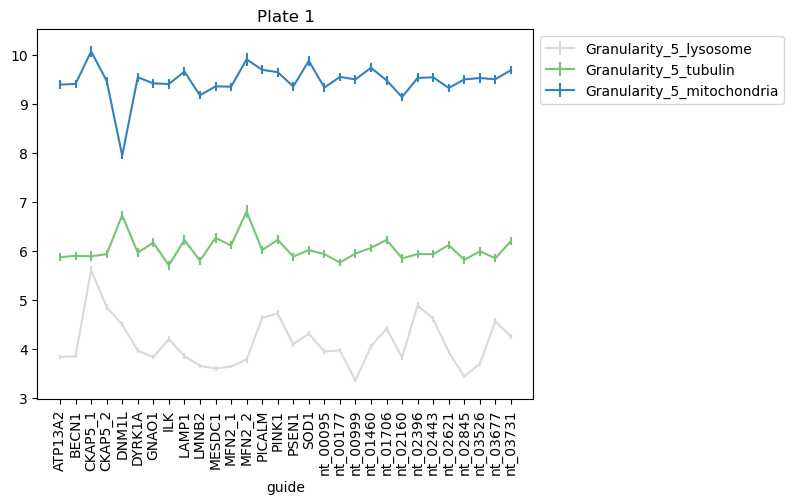

...

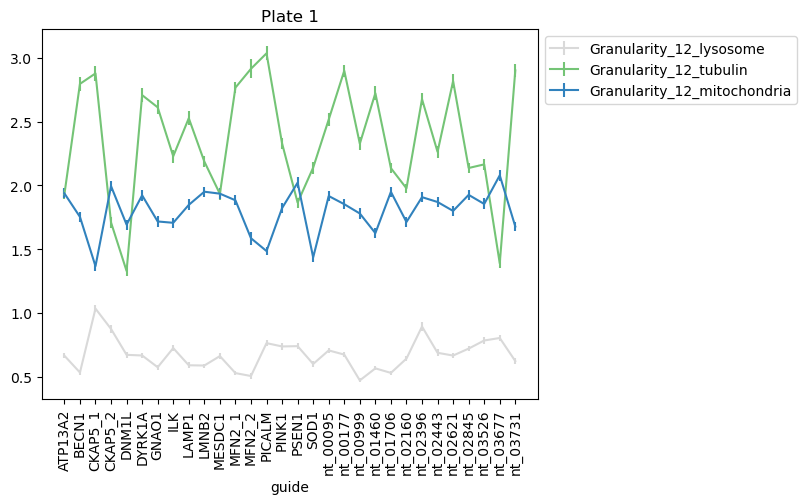

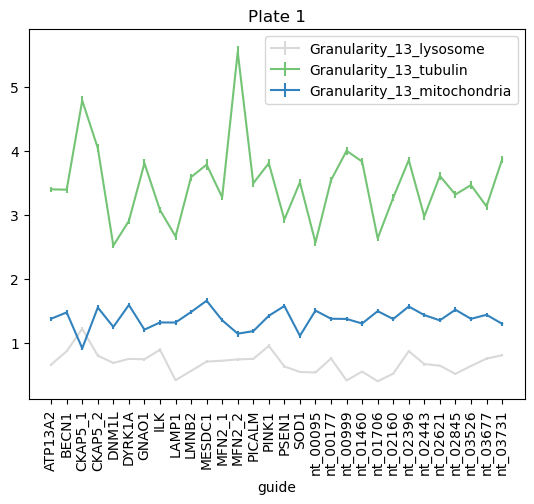

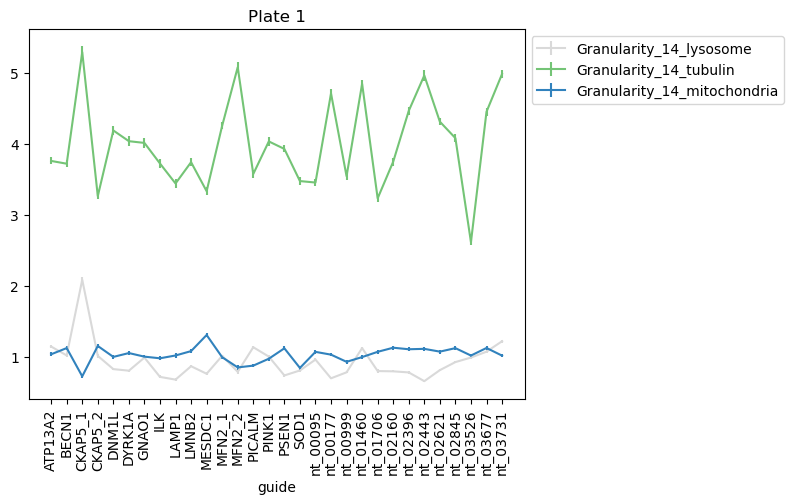

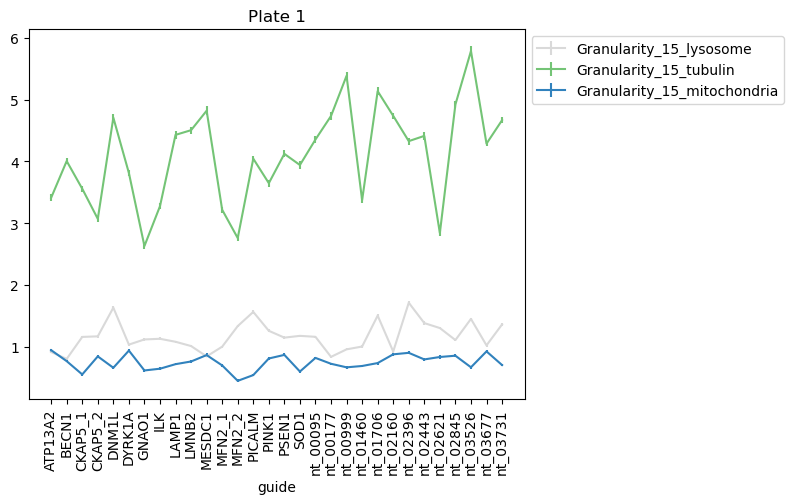

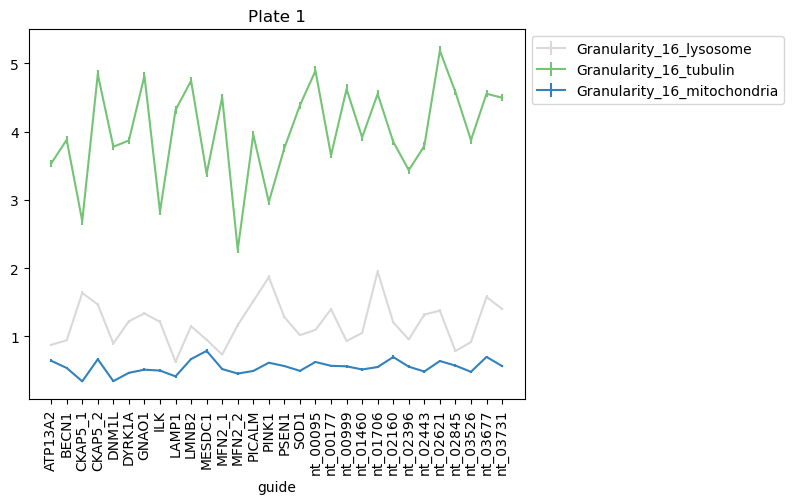

In [114]:
t = 'Plate 1'
for x in range(1,17):
    err = subset1[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').sem()
    subset1[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 
    'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').mean().plot(colormap='tab20c_r', yerr=err, rot=90, xticks=range(p1.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

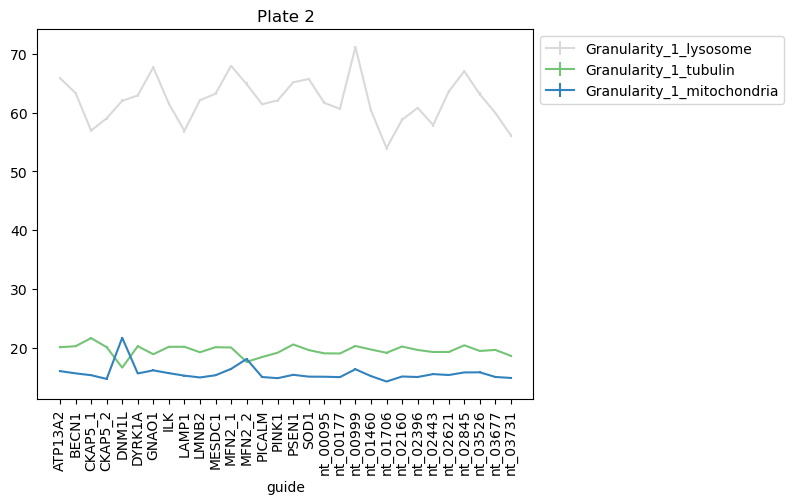

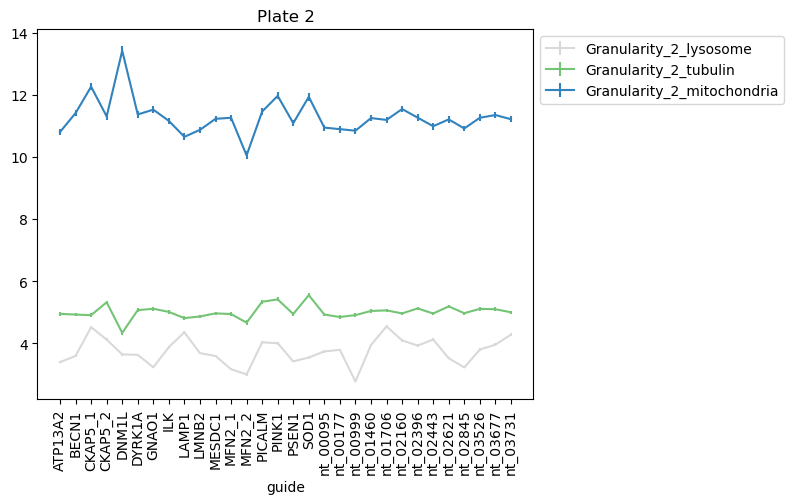

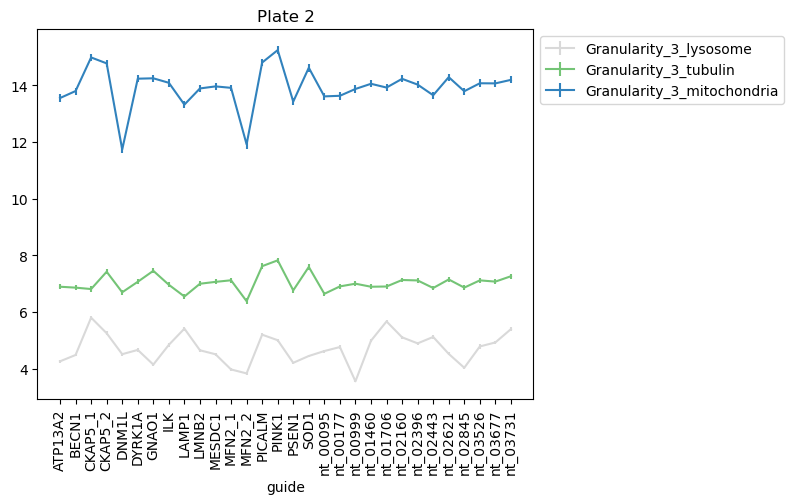

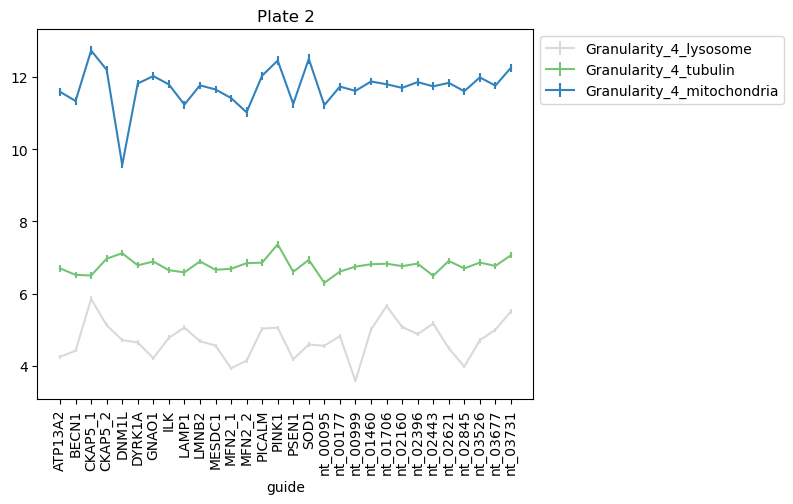

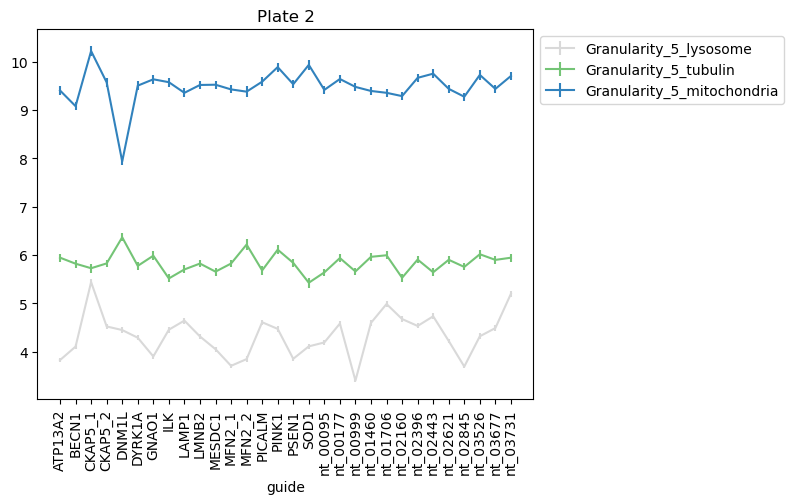

...

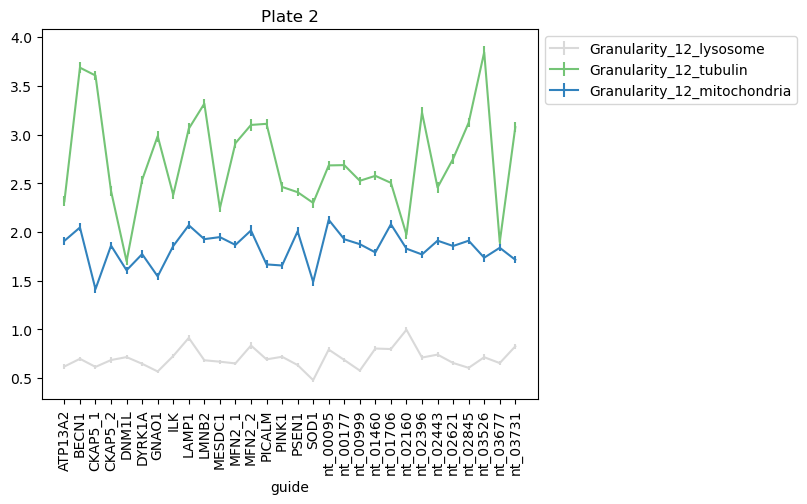

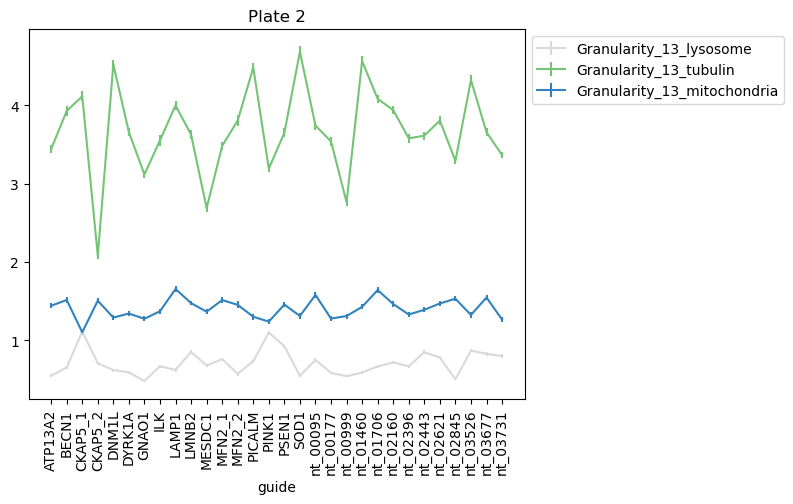

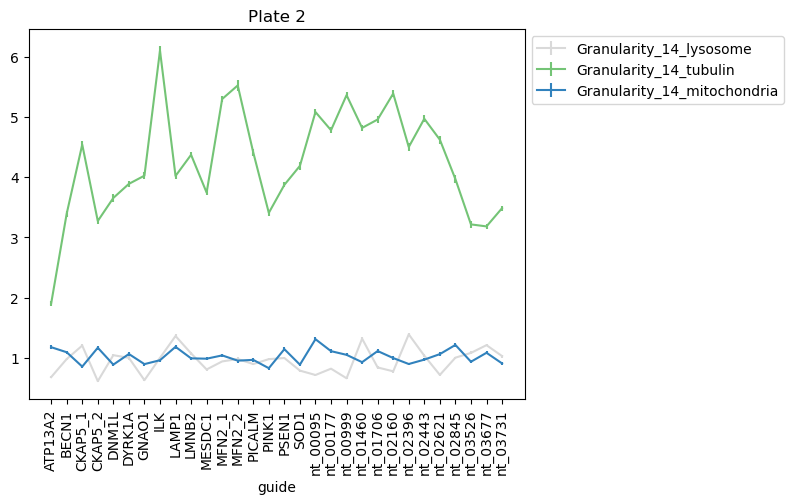

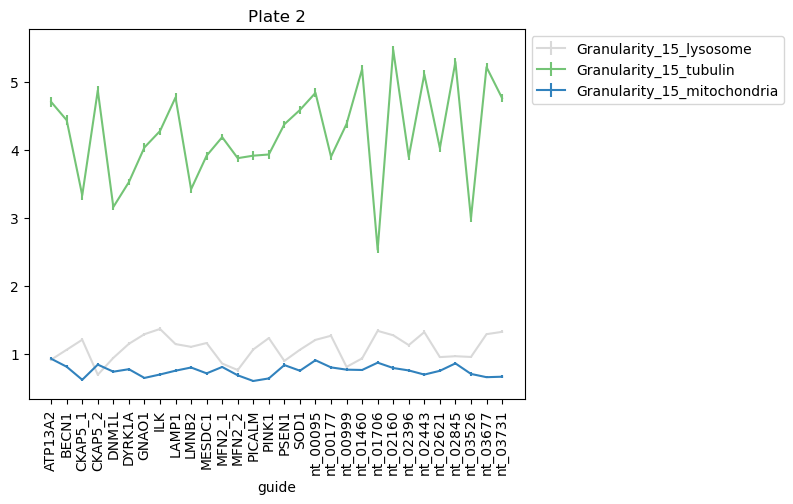

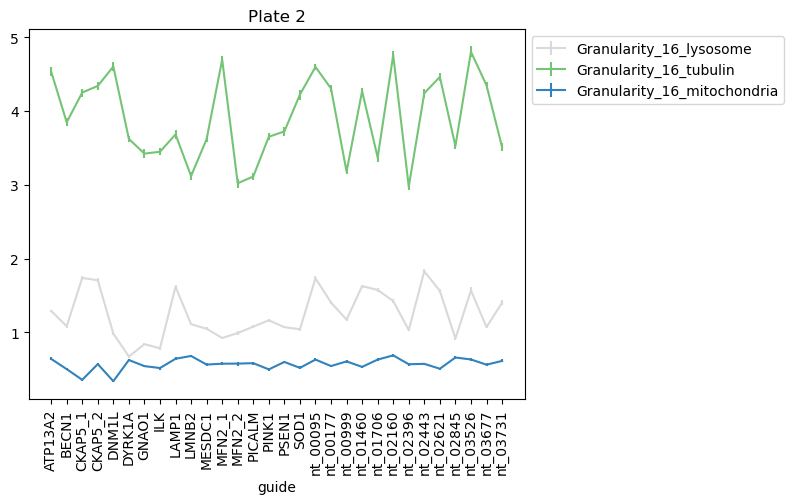

In [115]:
t = 'Plate 2'
for x in range(1,17):
    err = p2[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').sem()
    p2[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 
    'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').mean().plot(colormap='tab20c_r', yerr=err, rot=90, xticks=range(p2.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

In [116]:
# t = 'Plate 3'
# for x in range(1,17):
#     p3[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 
#     'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p3.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

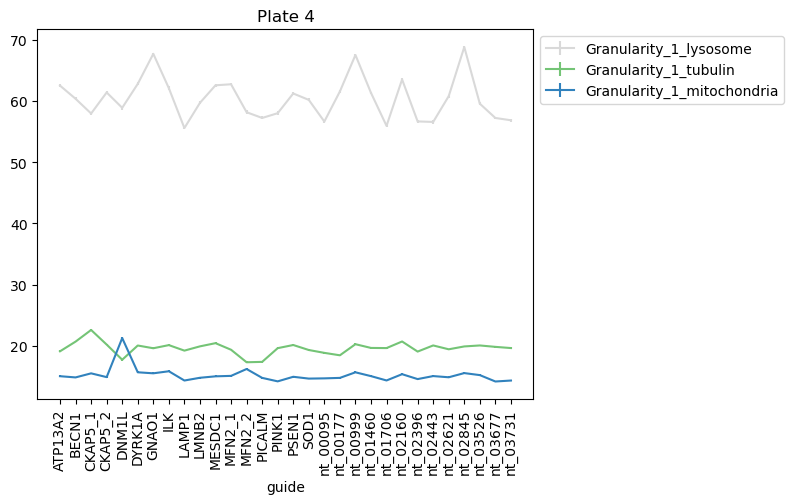

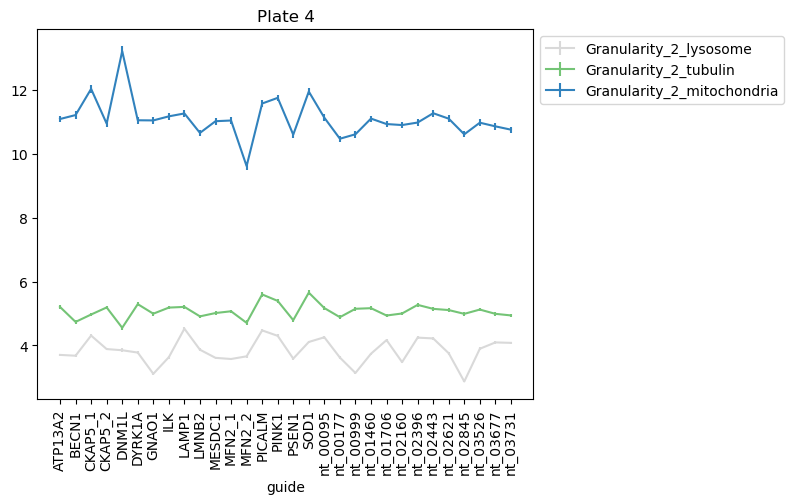

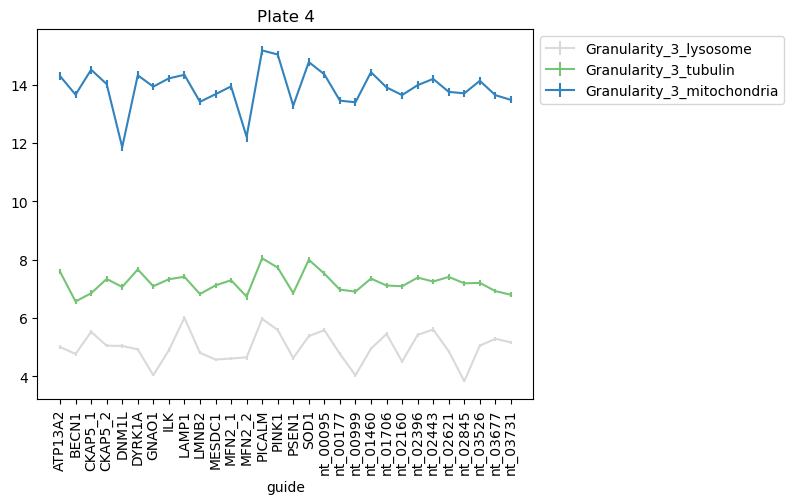

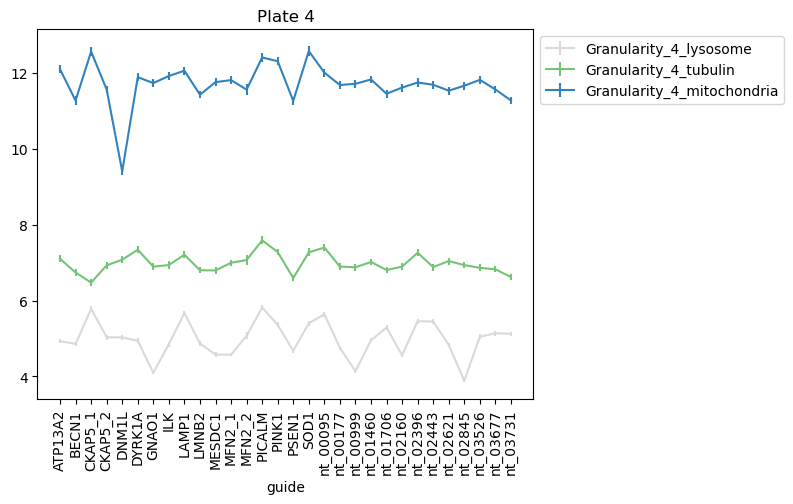

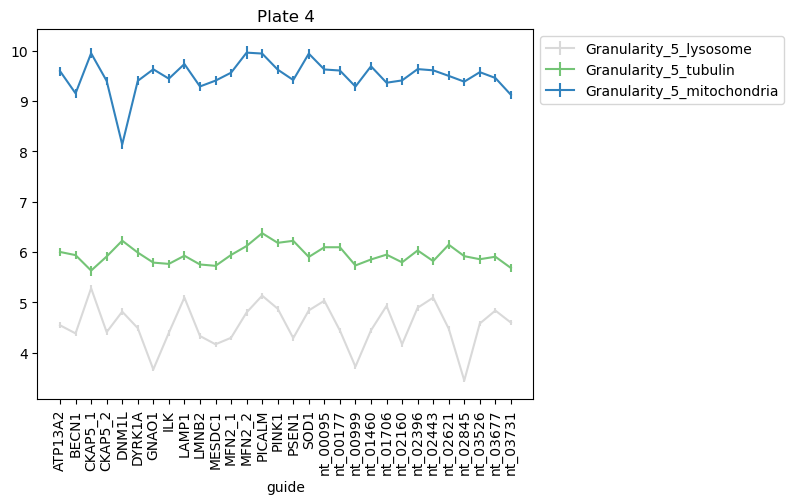

...

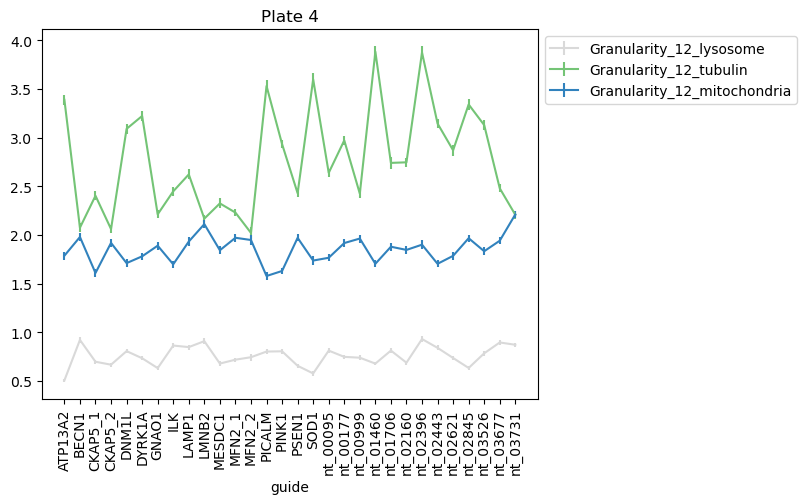

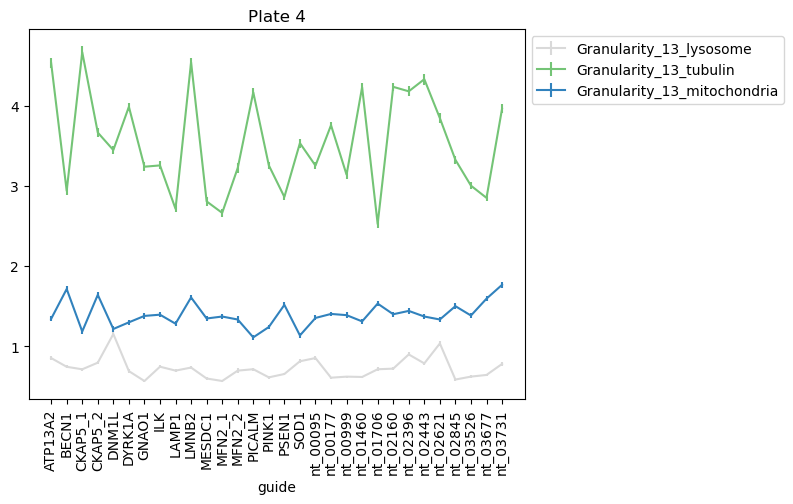

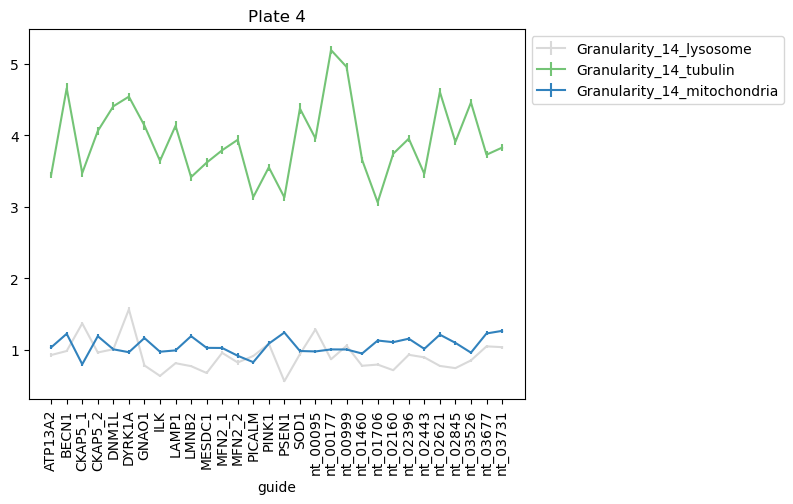

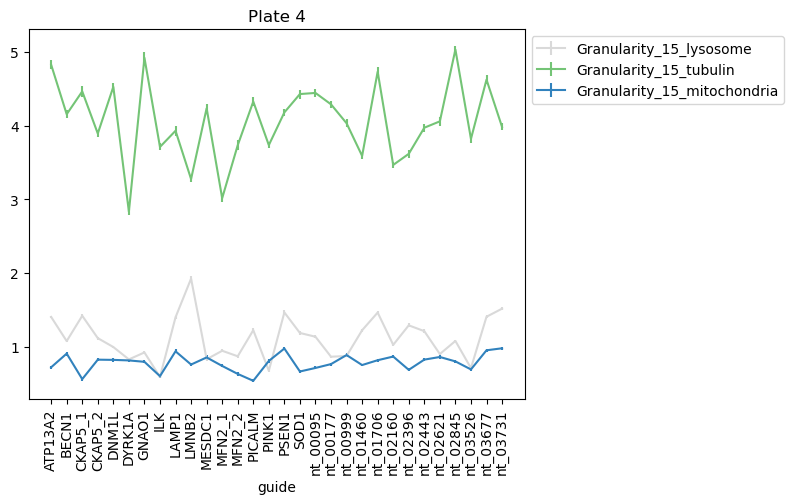

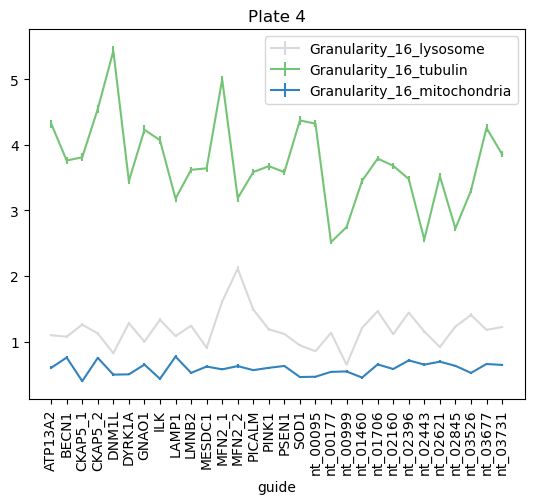

In [117]:
t = 'Plate 4'
for x in range(1,17):
    err = p4[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').sem()
    p4[['Granularity_' + str(x) + '_lysosome', 'Granularity_' + str(x) + '_tubulin', 
    'Granularity_' + str(x) + '_mitochondria', 'guide']].groupby('guide').mean().plot(colormap='tab20c_r', yerr=err, rot=90, xticks=range(p4.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

In [118]:
subset = subset1.copy()
subset['tmp'] = subset.guide.apply(lambda x: x.lower())
subset['tmp'] = subset['tmp'].str.replace('non-targeting','nt')
subset['tmp'].value_counts()

tmp
dnm1l       5894
nt_00177    5806
nt_03731    5525
mfn2_1      5510
atp13a2     5449
becn1       5393
nt_00095    5364
psen1       5340
lmnb2       5316
nt_02845    5220
picalm      5204
ckap5_2     5179
nt_03677    5104
nt_00999    5093
nt_02396    5090
nt_02621    5044
dyrk1a      5023
nt_01706    4943
nt_02160    4858
nt_01460    4708
pink1       4618
nt_02443    4545
nt_03526    4461
ilk         4381
gnao1       4308
lamp1       4238
mesdc1      4189
sod1        4187
ckap5_1     3629
mfn2_2      2611
Name: count, dtype: int64

In [119]:
for x in subset.tmp.unique():
    globals()[x] = subset[subset.tmp==x]
    print(x)

nt_00999
mfn2_2
lamp1
nt_01460
lmnb2
atp13a2
dyrk1a
nt_03731
picalm
nt_03677
sod1
nt_00095
mesdc1
ckap5_2
dnm1l
mfn2_1
becn1
nt_02845
ckap5_1
pink1
nt_02396
nt_02443
ilk
nt_02621
nt_03526
gnao1
nt_02160
nt_01706
nt_00177
psen1


In [120]:
genes = [nt_00095,gnao1,becn1,ckap5_2,nt_01706,nt_03731,ckap5_1,nt_00999,mfn2_2,nt_03526,nt_02396,psen1,sod1,nt_02160,nt_00177,ilk,mesdc1,lamp1,nt_02621,dnm1l,dyrk1a,atp13a2,
nt_02443,pink1,picalm,mfn2_1,nt_01460,lmnb2]
for x in genes:
    print(x.shape)

(5364, 361)
(4308, 361)
(5393, 361)
(5179, 361)
(4943, 361)
(5525, 361)
(3629, 361)
(5093, 361)
(2611, 361)
(4461, 361)
(5090, 361)
(5340, 361)
(4187, 361)
(4858, 361)
(5806, 361)
(4381, 361)
(4189, 361)
(4238, 361)
(5044, 361)
(5894, 361)
(5023, 361)
(5449, 361)
(4545, 361)
(4618, 361)
(5204, 361)
(5510, 361)
(4708, 361)
(5316, 361)


In [300]:
# for x in [picalm,dyrk1a,psen1,lmnb2,dnm1l,gnao1,becn1,sod1,mesdc1,lamp1,ilk,pink1,atp13a2,mfn2_1, mfn2_2,ckap5_1, ckap5_2,nt]:
#     print(x.shape)

In [126]:
import scipy.stats as stats

In [124]:
def pval_test(treatment):
    d = dict(zip(treatment.columns, [[] for x in range(len(treatment.columns))]))
    measurements = []
    for x in treatment.columns[:-3]:
        dtmp = nt_00095[x]
        tmp = treatment[x]
        u = stats.mannwhitneyu(dtmp, tmp, alternative='two-sided')
        if u[1] < 10e-15:
            d[x].append(u[1])
        t = stats.ttest_ind(dtmp, tmp, alternative='two-sided', equal_var=False, trim=0)
        if t[1] < 10e-15:
            d[x].append(t[1])
        ks = stats.ks_2samp(dtmp, tmp, alternative='two-sided')
        if ks[1] < 10e-15:
            d[x].append(ks[1])

    for k, v in d.items():
        if len(v) == 3:
            measurements.append(k)

    # return measurements, d
    return measurements

In [128]:
sigdict = dict()
for g in genes[1:]:
    print(g.guide.unique())
    p = pval_test(g)
    print(len(p))
    sigdict[g.guide.unique()[0]] = len(p)
sigdict

['GNAO1']
5
['BECN1']
37
['CKAP5_2']
41
['nt_01706']
72
['nt_03731']
6
['CKAP5_1']
117
['nt_00999']
29
['MFN2_2']
32
['nt_03526']
21
['nt_02396']
37
['PSEN1']
2
['SOD1']
75
['nt_02160']
25
['nt_00177']
5
['ILK']
5
['MESDC1']
18
['LAMP1']
44
['nt_02621']
4
['DNM1L']
215
['DYRK1A']
5
['ATP13A2']
32
['nt_02443']
7
['PINK1']
12
['PICALM']
54
['MFN2_1']
6
['nt_01460']
3
['LMNB2']
6


{'GNAO1': 5,
 'BECN1': 37,
 'CKAP5_2': 41,
 'nt_01706': 72,
 'nt_03731': 6,
 'CKAP5_1': 117,
 'nt_00999': 29,
 'MFN2_2': 32,
 'nt_03526': 21,
 'nt_02396': 37,
 'PSEN1': 2,
 'SOD1': 75,
 'nt_02160': 25,
 'nt_00177': 5,
 'ILK': 5,
 'MESDC1': 18,
 'LAMP1': 44,
 'nt_02621': 4,
 'DNM1L': 215,
 'DYRK1A': 5,
 'ATP13A2': 32,
 'nt_02443': 7,
 'PINK1': 12,
 'PICALM': 54,
 'MFN2_1': 6,
 'nt_01460': 3,
 'LMNB2': 6}

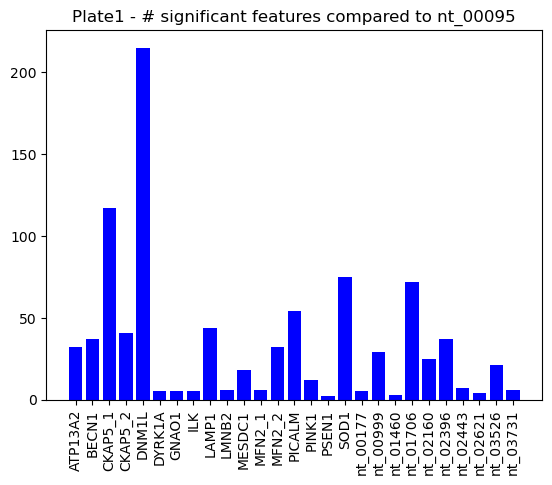

In [137]:
plt.bar(*zip(*sorted(sigdict.items())), color='b')
plt.xticks(rotation=90)
plt.title('Plate1 - # significant features compared to nt_00095')
plt.show()

In [145]:
pval_test(dnm1l)

['AreaShape_Area',
 'AreaShape_BoundingBoxArea',
 'AreaShape_CentralMoment_0_0',
 'AreaShape_CentralMoment_0_2',
 'AreaShape_CentralMoment_2_0',
 'AreaShape_CentralMoment_2_2',
 'AreaShape_Compactness',
 'AreaShape_ConvexArea',
 'AreaShape_Eccentricity',
 'AreaShape_EquivalentDiameter',
 'AreaShape_Extent',
 'AreaShape_FormFactor',
 'AreaShape_HuMoment_0',
 'AreaShape_HuMoment_1',
 'AreaShape_HuMoment_2',
 'AreaShape_InertiaTensorEigenvalues_0',
 'AreaShape_InertiaTensorEigenvalues_1',
 'AreaShape_InertiaTensor_0_0',
 'AreaShape_InertiaTensor_1_1',
 'AreaShape_MajorAxisLength',
 'AreaShape_MaxFeretDiameter',
 'AreaShape_MaximumRadius',
 'AreaShape_MeanRadius',
 'AreaShape_MedianRadius',
 'AreaShape_MinFeretDiameter',
 'AreaShape_MinorAxisLength',
 'AreaShape_Perimeter',
 'AreaShape_SpatialMoment_0_0',
 'AreaShape_SpatialMoment_0_1',
 'AreaShape_SpatialMoment_0_2',
 'AreaShape_SpatialMoment_0_3',
 'AreaShape_SpatialMoment_1_0',
 'AreaShape_SpatialMoment_1_1',
 'AreaShape_SpatialMoment_1

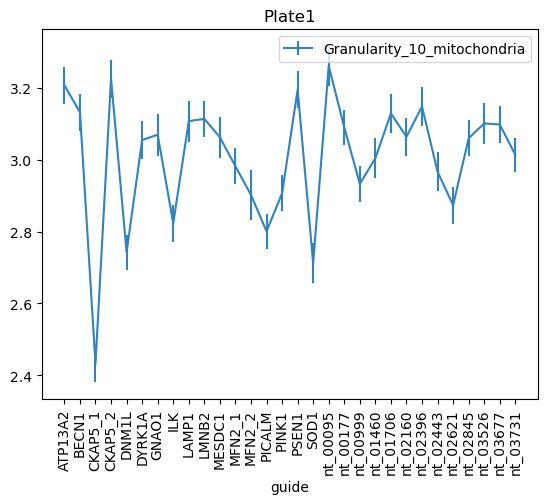

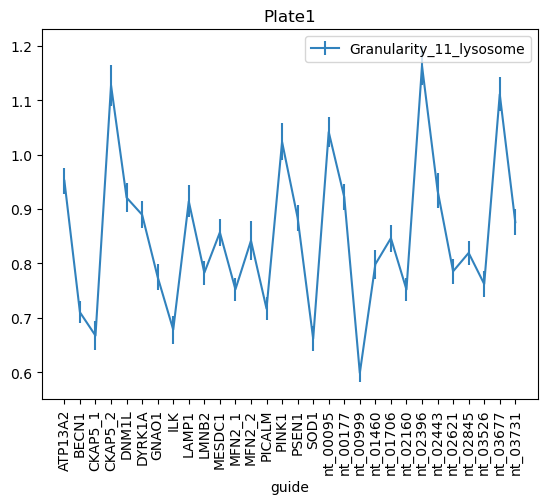

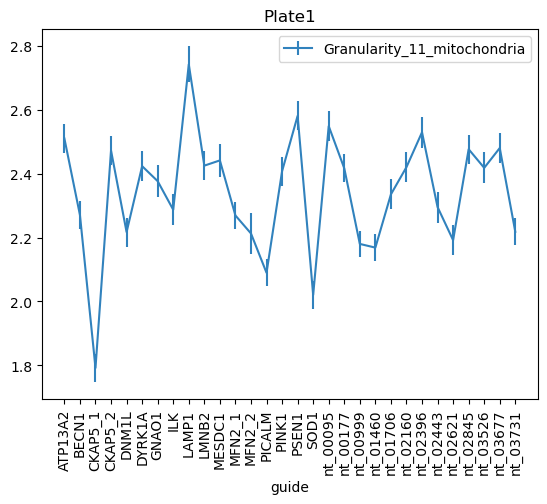

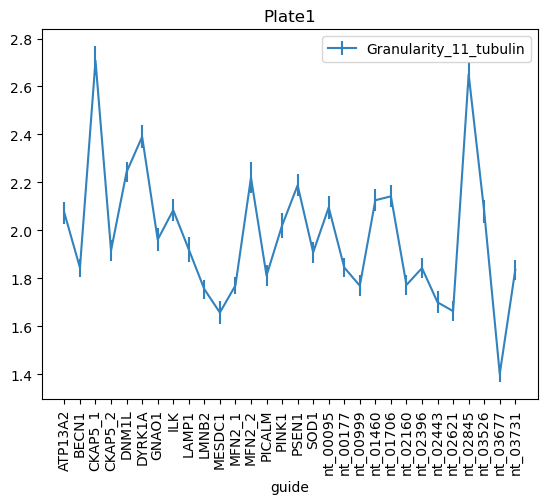

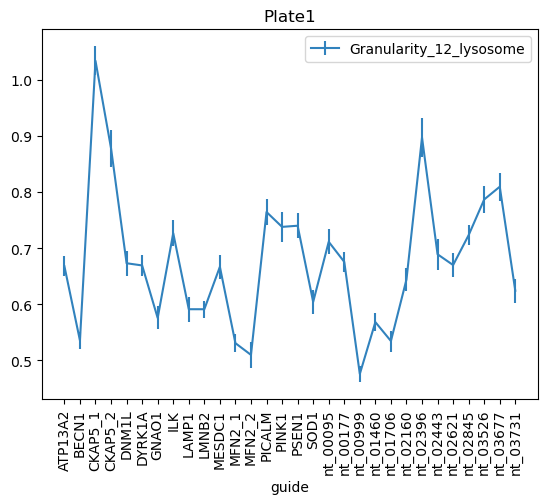

...

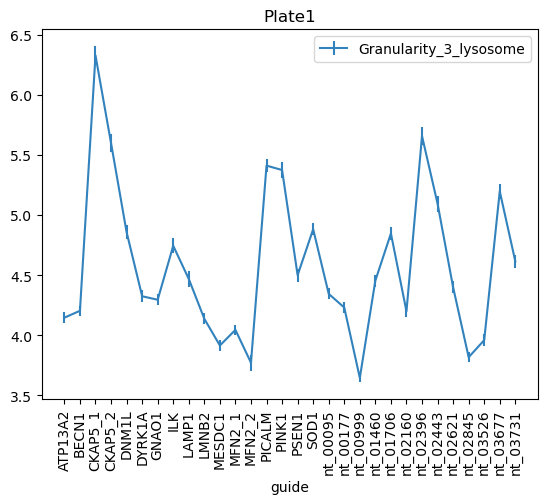

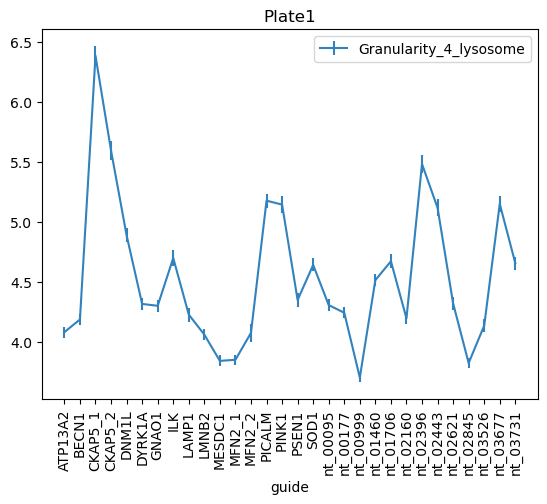

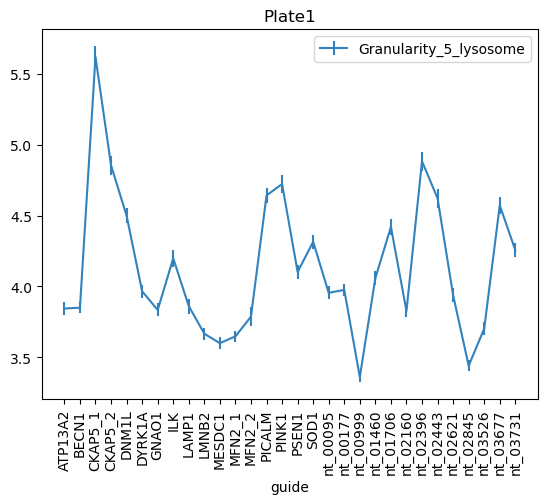

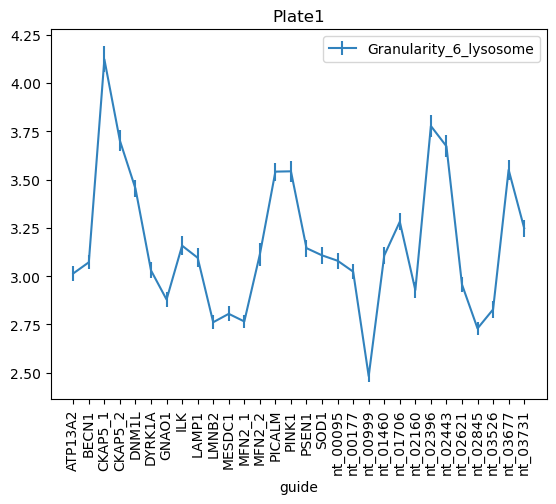

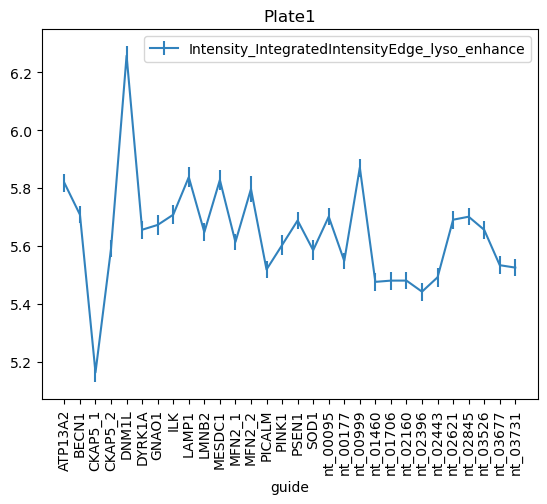

In [140]:
# CKAP5_1 highly statistically significant measurements:
t = 'Plate1'
for x in pval_test(ckap5_1)[:20]:
    err = p1[[x, 'guide']].groupby('guide').sem()
    p1[[x, 'guide']].groupby('guide').mean().plot(colormap='tab20c', yerr=err, rot=90, xticks=range(p1.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))


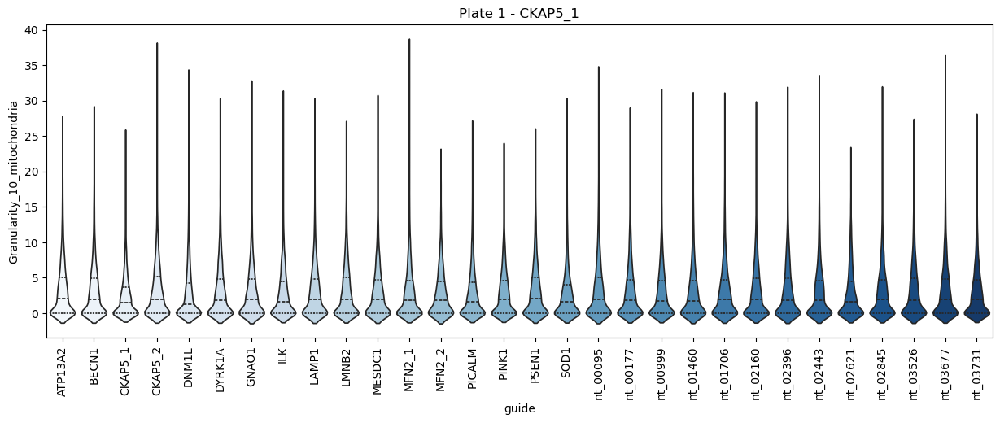

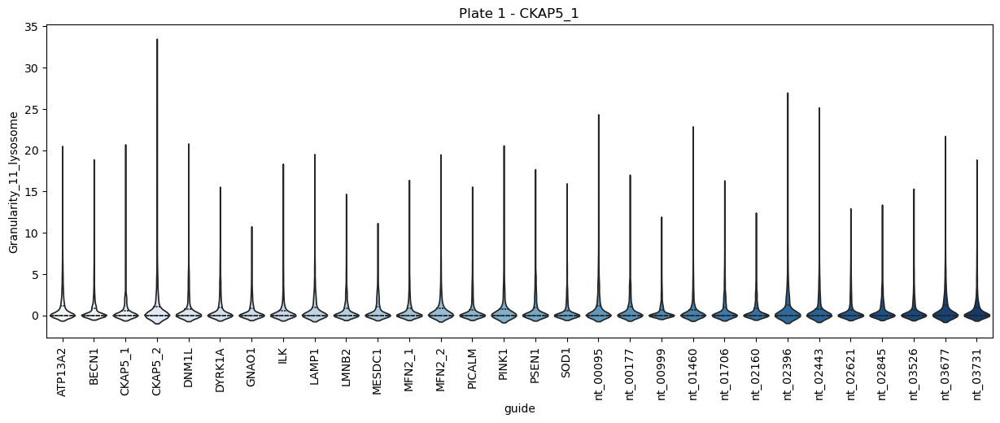

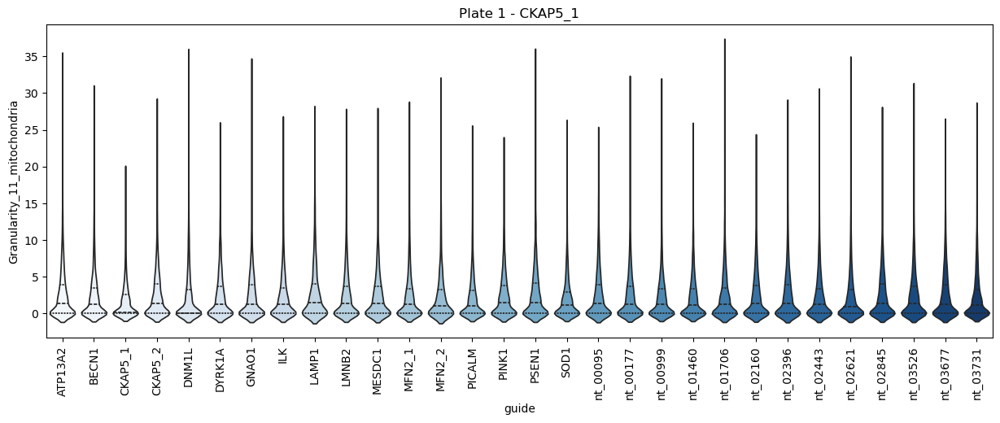

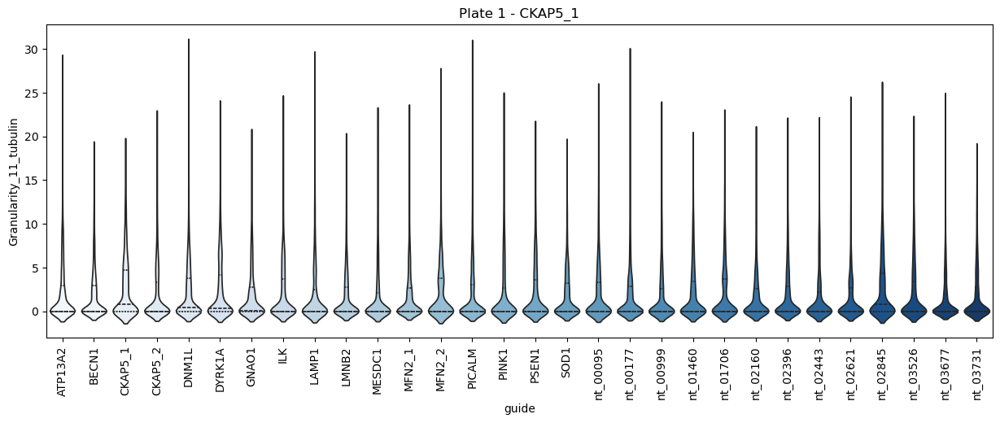

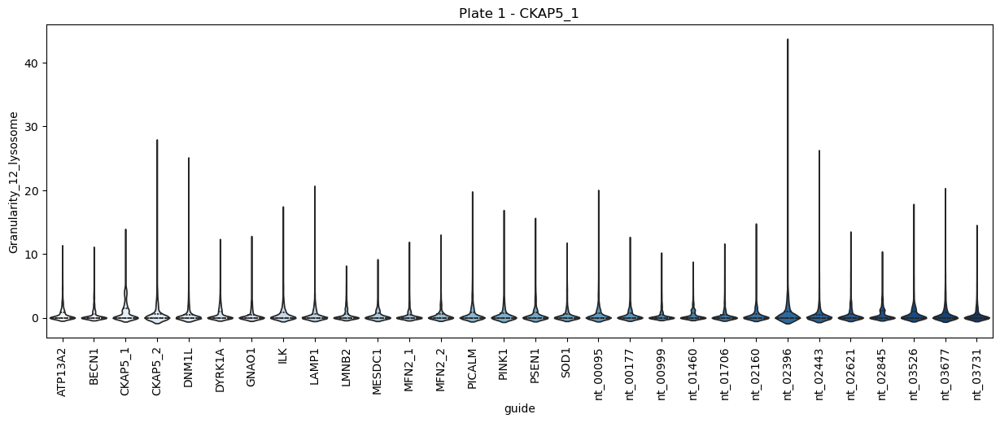

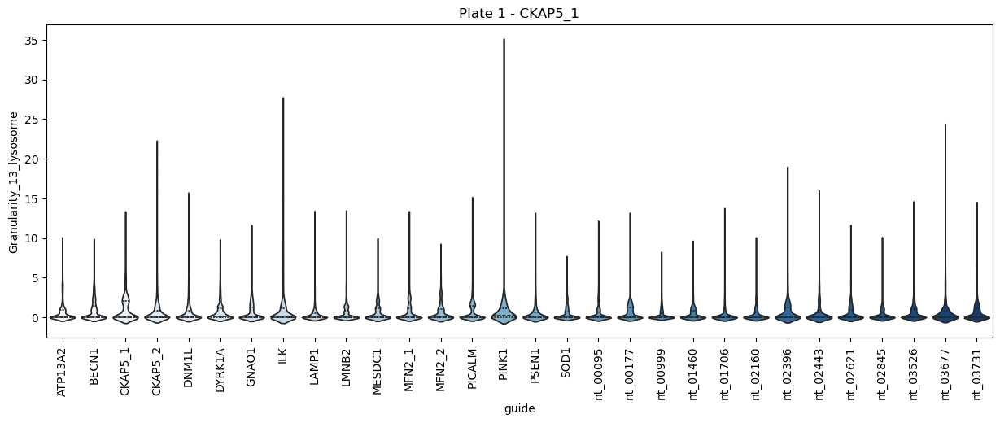

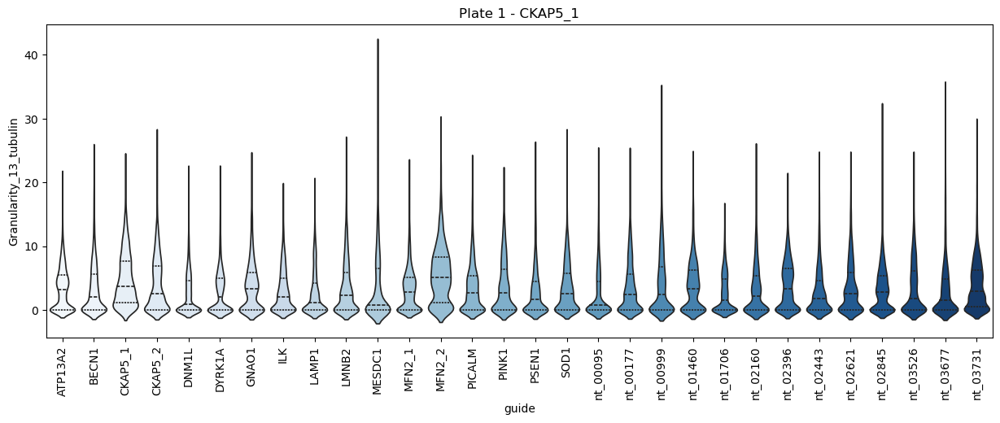

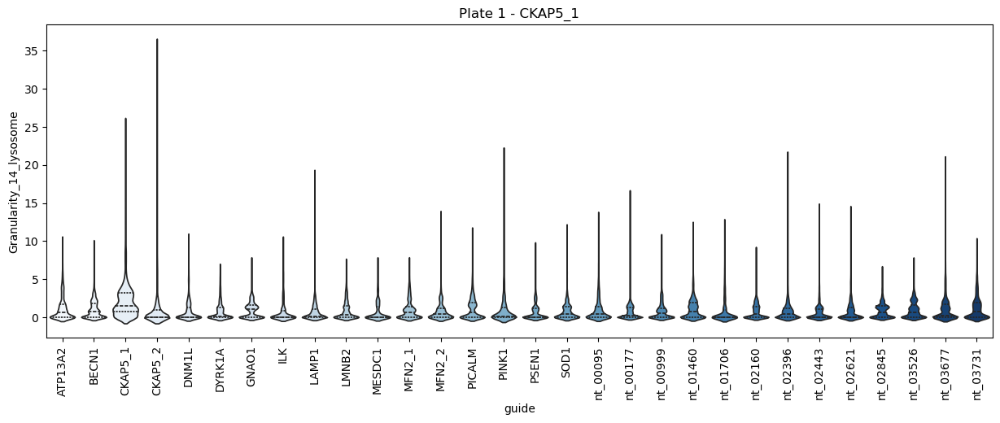

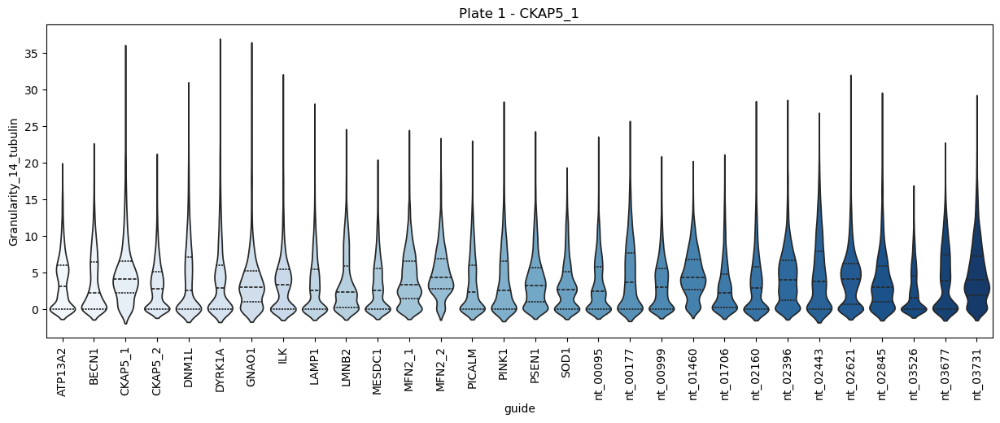

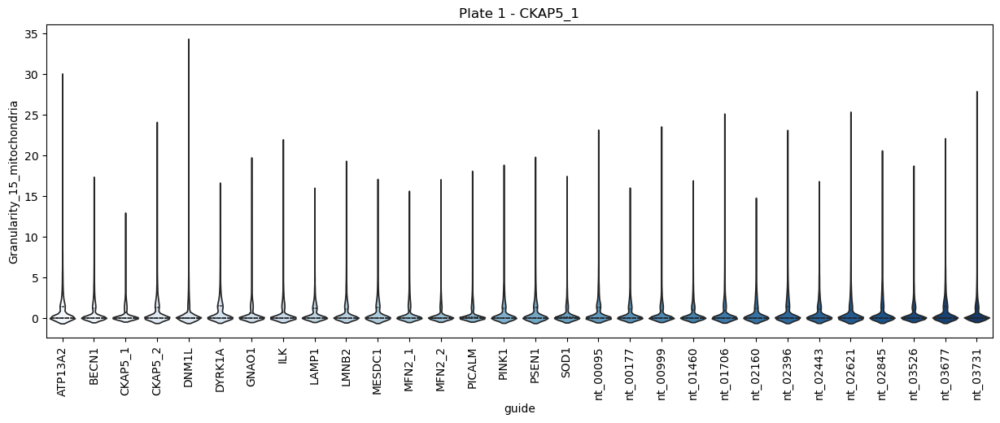

In [142]:
import seaborn

for feature in pval_test(ckap5_1)[:10]:
    plt.rcParams['figure.figsize']=(15,5)
    fig, axes = plt.subplots()
    seaborn.violinplot(data=p1.sort_values(by='guide'), x = 'guide', y=feature, ax = axes, hue='guide', palette='Blues', inner='quart')
    axes.set_title('Plate 1 - CKAP5_1')
    
    axes.yaxis.grid(False)
    axes.set_xlabel('guide')
    # axes.set_ylabel('cells/well')
    plt.xticks(rotation=90)
    
    plt.show()
matplotlib.rc_file_defaults()

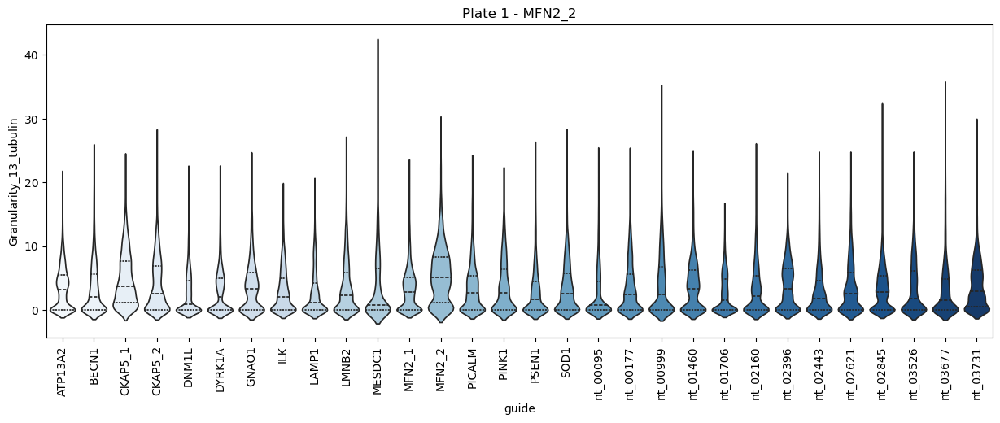

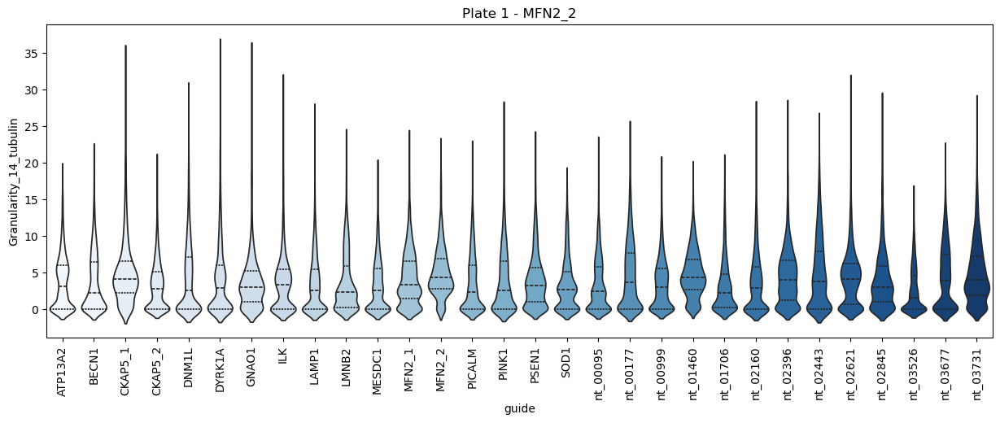

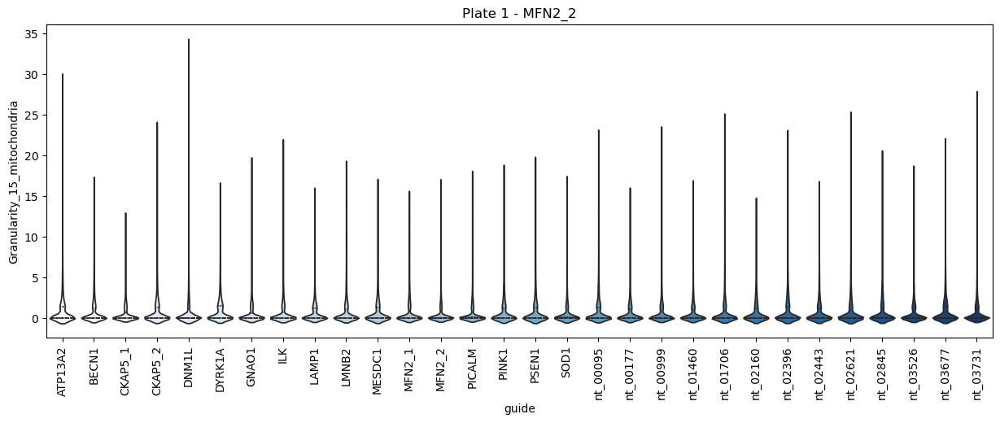

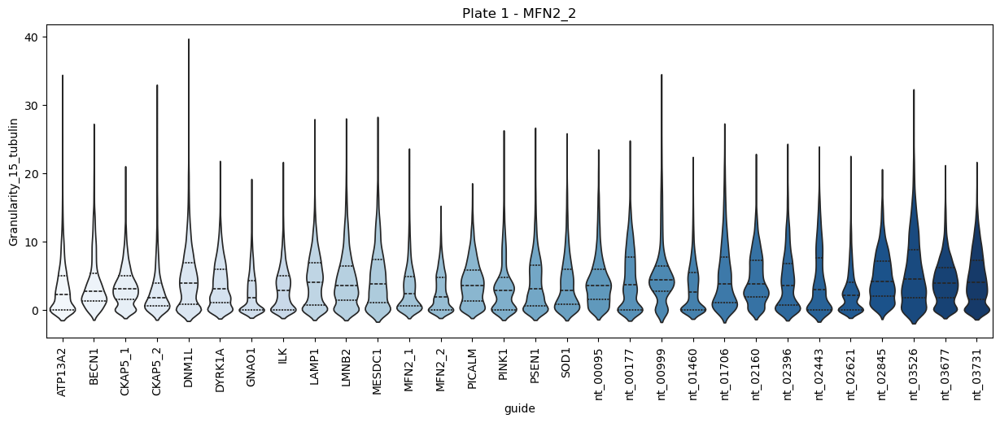

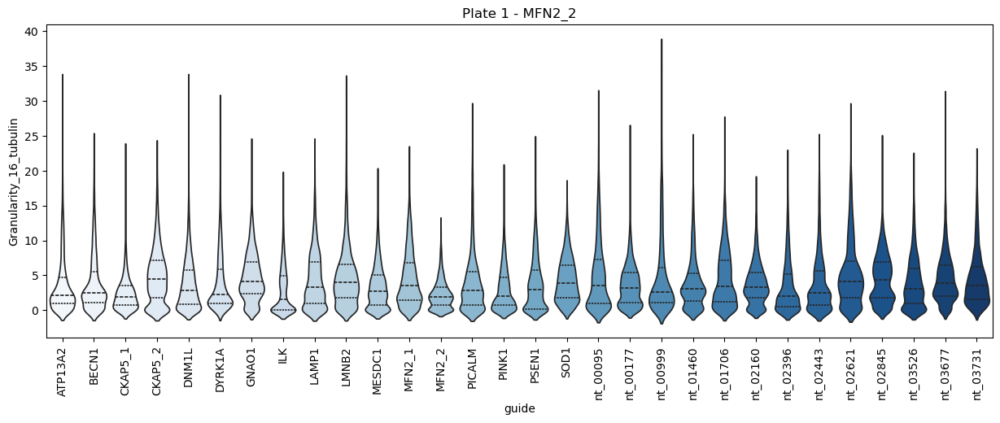

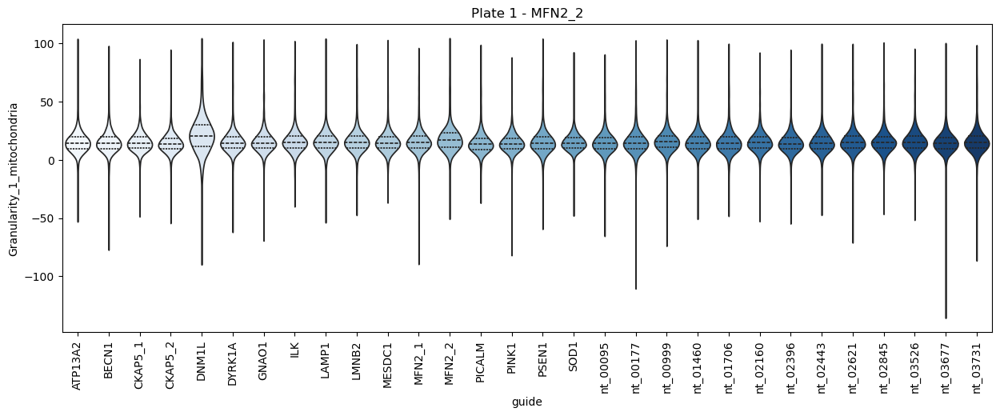

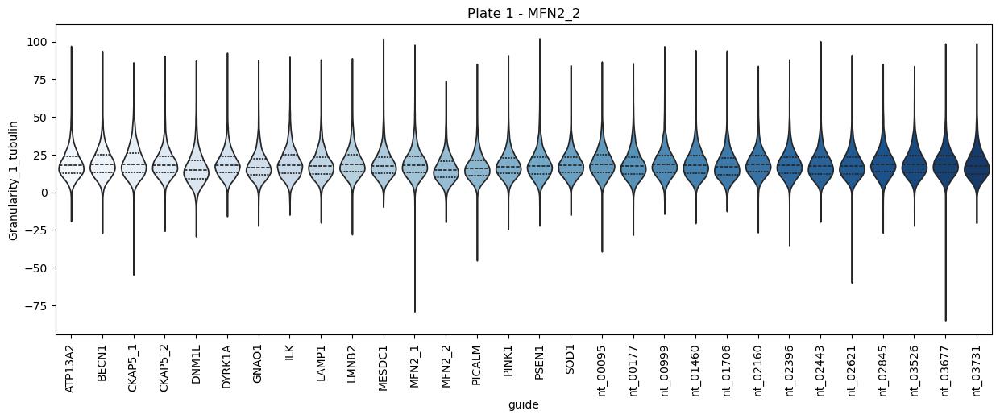

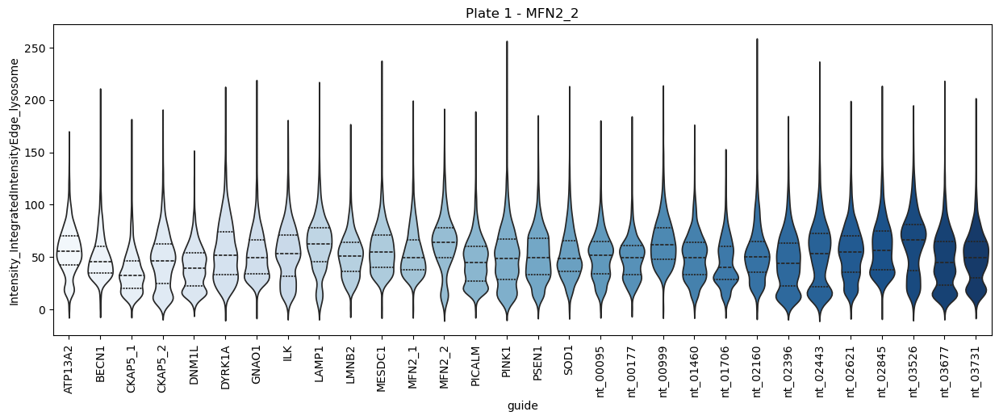

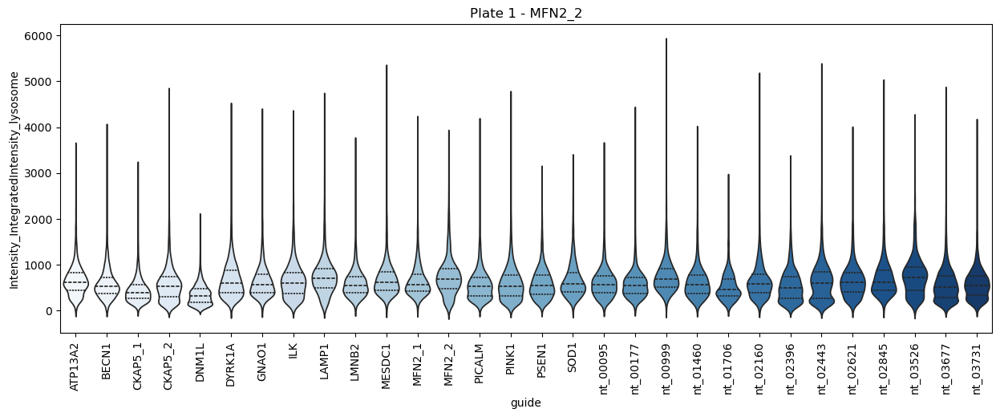

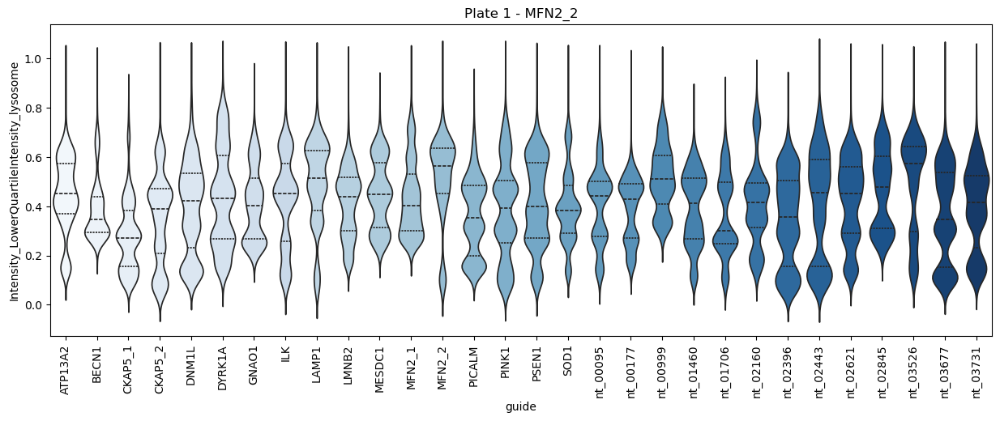

In [143]:
for feature in pval_test(mfn2_2)[:10]:
    plt.rcParams['figure.figsize']=(15,5)
    fig, axes = plt.subplots()
    seaborn.violinplot(data=p1.sort_values(by='guide'), x = 'guide', y=feature, ax = axes, hue='guide', palette='Blues', inner='quart')
    axes.set_title('Plate 1 - MFN2_2')
    
    axes.yaxis.grid(False)
    axes.set_xlabel('guide')
    # axes.set_ylabel('cells/well')
    plt.xticks(rotation=90)
    
    plt.show()
matplotlib.rc_file_defaults()

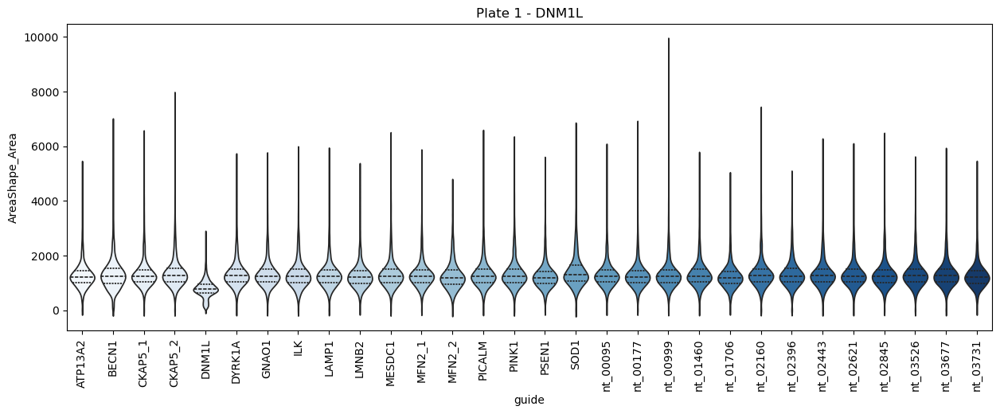

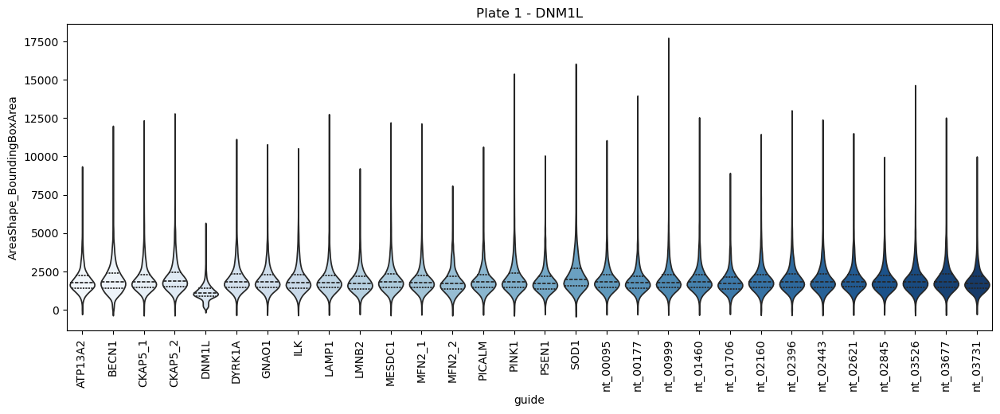

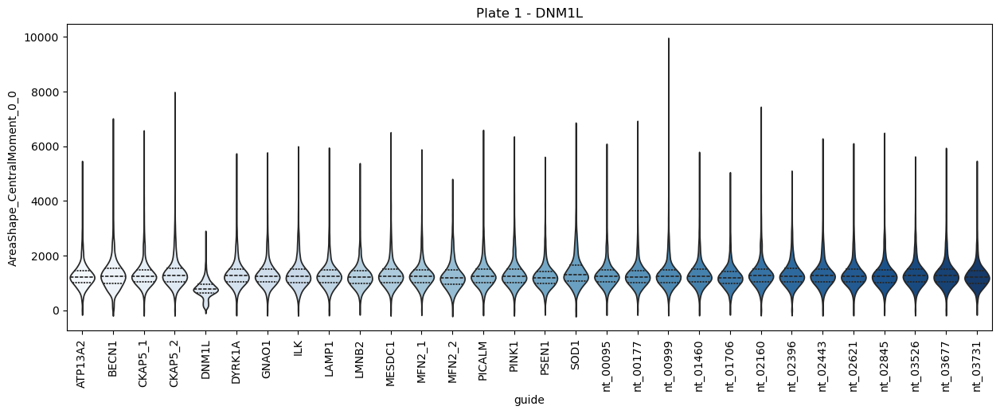

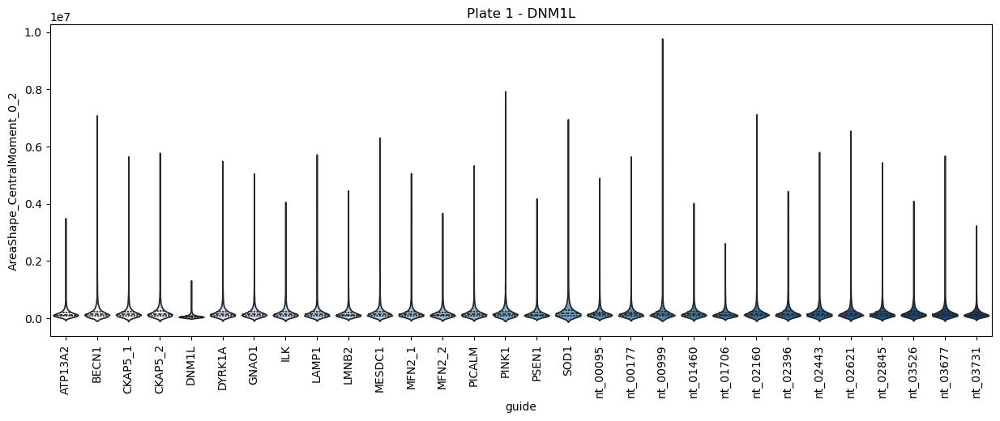

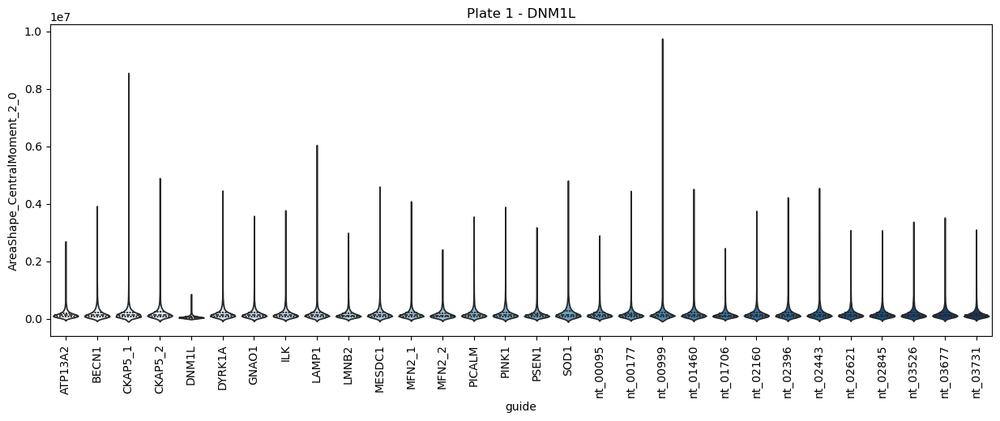

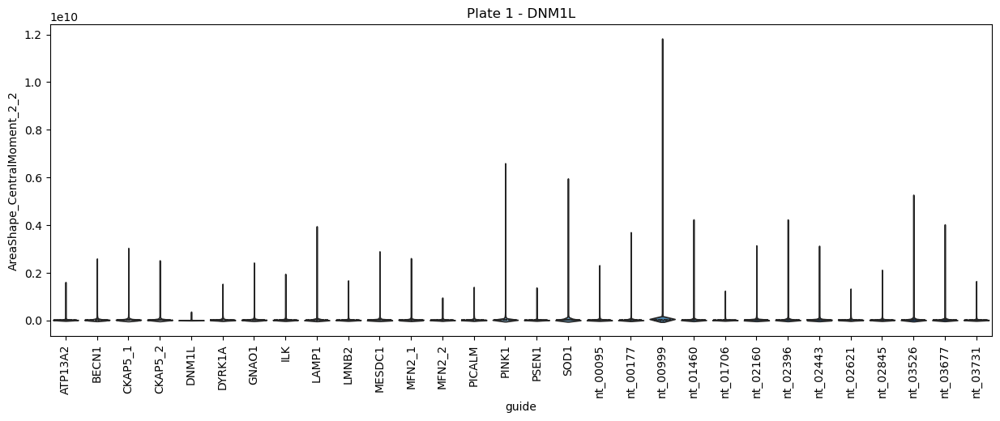

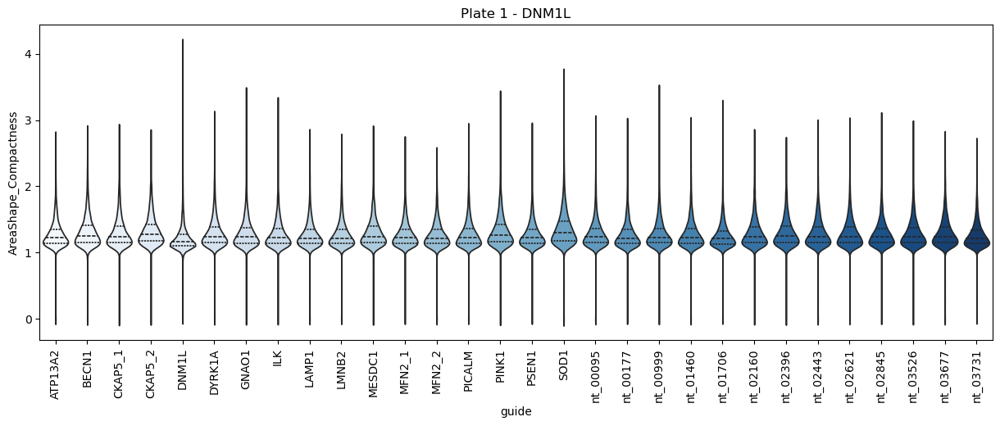

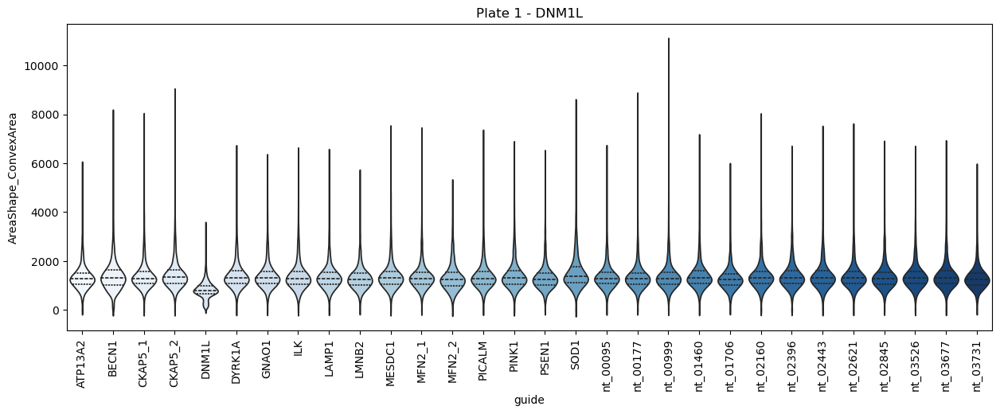

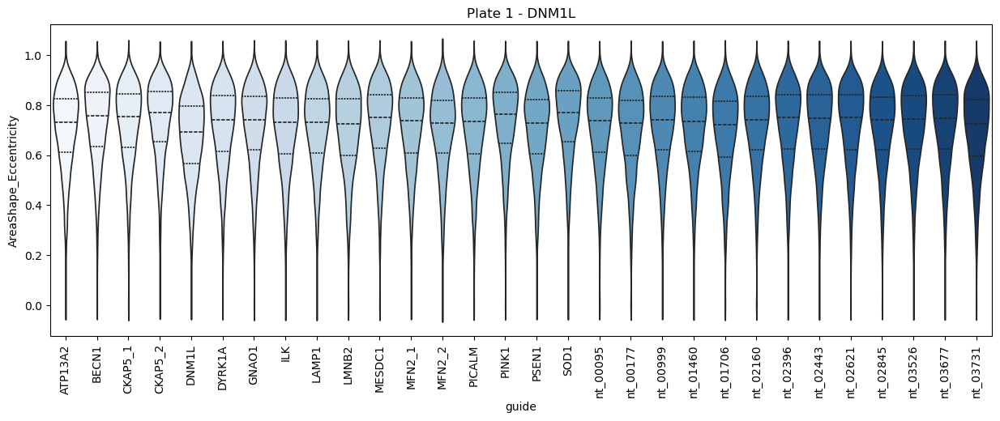

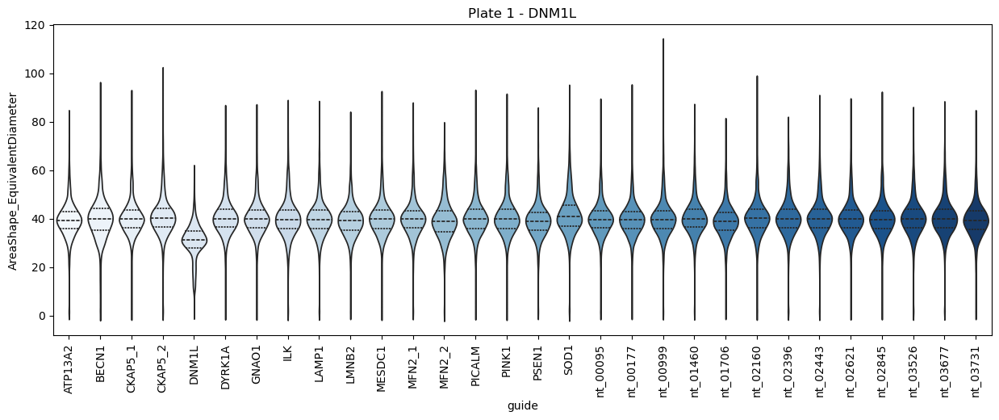

In [144]:
for feature in pval_test(dnm1l)[:10]:
    plt.rcParams['figure.figsize']=(15,5)
    fig, axes = plt.subplots()
    seaborn.violinplot(data=p1.sort_values(by='guide'), x = 'guide', y=feature, ax = axes, hue='guide', palette='Blues', inner='quart')
    axes.set_title('Plate 1 - DNM1L')
    
    axes.yaxis.grid(False)
    axes.set_xlabel('guide')
    # axes.set_ylabel('cells/well')
    plt.xticks(rotation=90)
    
    plt.show()
matplotlib.rc_file_defaults()

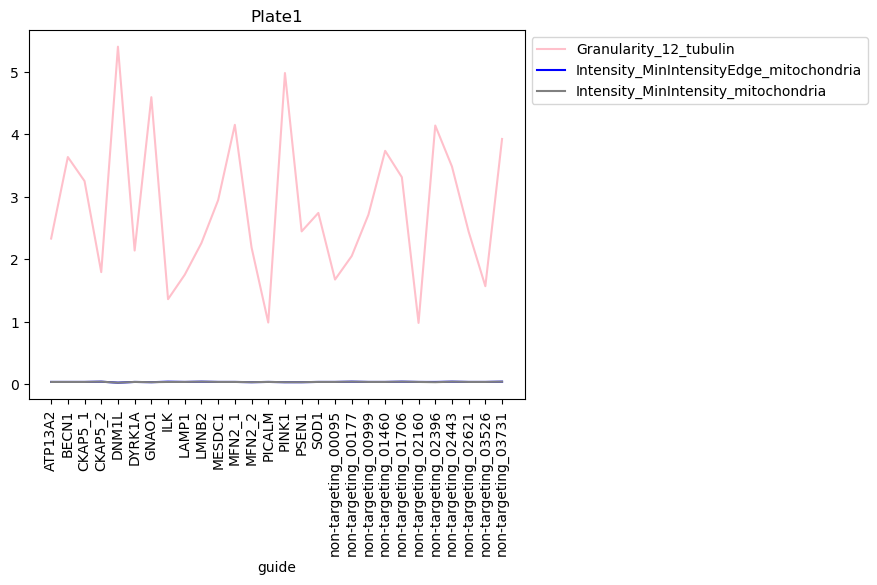

In [315]:
# gnao1 highly statistically significant measurements:
t = 'Plate1'
subset[['Granularity_12_tubulin', 'Intensity_MinIntensityEdge_mitochondria', 'Intensity_MinIntensity_mitochondria', 'guide']].groupby('guide').median().plot(color=['pink', 'b', 'grey'], rot=90, xticks=range(p1.guide.nunique()), title=t).legend(bbox_to_anchor=(1.0, 1.0))

In [88]:
w1 = subset1.groupby('well')[subset1.columns[:-2]].median().reset_index()
w1 = w1.merge(i1.drop_duplicates(subset='well')[i1.columns[1:]], how='left', on='well')

w2 = subset2.groupby('well')[subset2.columns[:-2]].median().reset_index()
w2 = w2.merge(i2.drop_duplicates(subset='well')[i2.columns[1:]], how='left', on='well')

# w3 = subset3.groupby('well')[subset3.columns[:-2]].median().reset_index()
# w3 = w3.merge(i3.drop_duplicates(subset='well')[i3.columns[1:]], how='left', on='well')

w4 = subset4.groupby('well')[subset4.columns[:-2]].median().reset_index()
w4 = w4.merge(i4.drop_duplicates(subset='well')[i4.columns[1:]], how='left', on='well')

In [89]:
def pca_plot_well(table, cols, title):

    # d = table[table.treatment=='dmso'][cols].values
    # scaler = preprocessing.StandardScaler()
    # scaler.fit(d)
    
    norm = StandardScaler().fit_transform(table[cols].values)
    # norm = scaler.transform(table[cols].values)
    
    # d = StandardScaler().fit_transform(dmso[cols].values)
    # norm = table[cols].values
    
    # pca = PCA(n_components=2)
    # pc_dmso = pca.fit(d)
    # pc = pc_dmso.transform(norm)
    
    # norm = StandardScaler().fit_transform(table[cols].values)
    # d = StandardScaler().fit_transform(table[table.treatment=='dmso'][cols].values)
    # norm = table[cols].values
    pca = PCA(n_components=2)
    # pc_dmso = pca.fit(d)
    # pc = pc_dmso.transform(norm)
    pc = pca.fit_transform(norm)
    
    print('Explained variation per principal component: {}'.format(pca.explained_variance_ratio_))

    pca_df = pandas.DataFrame(data = pc, columns = ['principal component 1', 'principal component 2'])
    pca_df['well'] = table['well']
    pca_df['guide'] = table['guide']

    # # plotting just 10% of data:
    # pca_df = pca_df.sample(frac=.05)
    # print(pca_df.shape)

    plt.figure(figsize=(8,5))
    # seaborn.jointplot(
    seaborn.scatterplot(
    x="principal component 1", y="principal component 2",
    hue="guide",
    palette=seaborn.color_palette("tab20b", table.guide.nunique()),
    data=pca_df,
    legend="full",
    # marker="$\circ$", ec="face", # <-- for unfilled circles
    # marker = '+',
    alpha=1)
    plt.title(title, fontsize=20)
    plt.legend(bbox_to_anchor=(1, 1), ncol=2)
    return pca_df

Explained variation per principal component: [0.38227816 0.22403242]


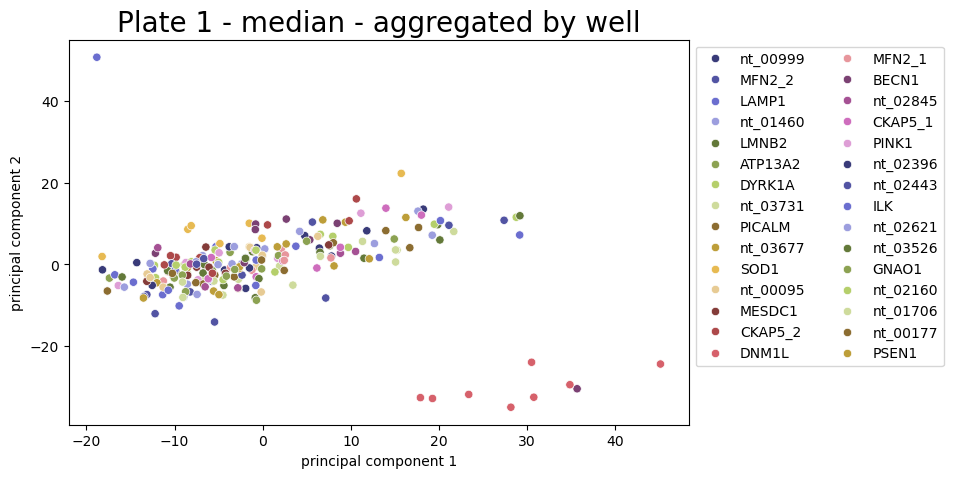

In [90]:
pl = 'Plate 1'
pca_df1 = pca_plot_well(w1, w1.columns[1:-1], pl + ' - median - aggregated by well')

In [92]:
pca_df1[(-20 > pca_df1['principal component 2'])]# | (pca_df1['principal component 1'] > 25)]

,principal component 1,principal component 2,well,guide
14,30.762035,-32.566458,C17,DNM1L
16,35.677158,-30.490986,C19,BECN1
43,28.160443,-35.019499,E06,DNM1L
64,23.378092,-31.882615,F07,DNM1L
87,17.894507,-32.667922,G10,DNM1L
126,45.137113,-24.428474,I09,DNM1L
140,30.509656,-23.995171,J04,DNM1L
175,34.859091,-29.497260,K20,DNM1L
209,19.265930,-32.873928,M14,DNM1L


Explained variation per principal component: [0.38526163 0.22445009]


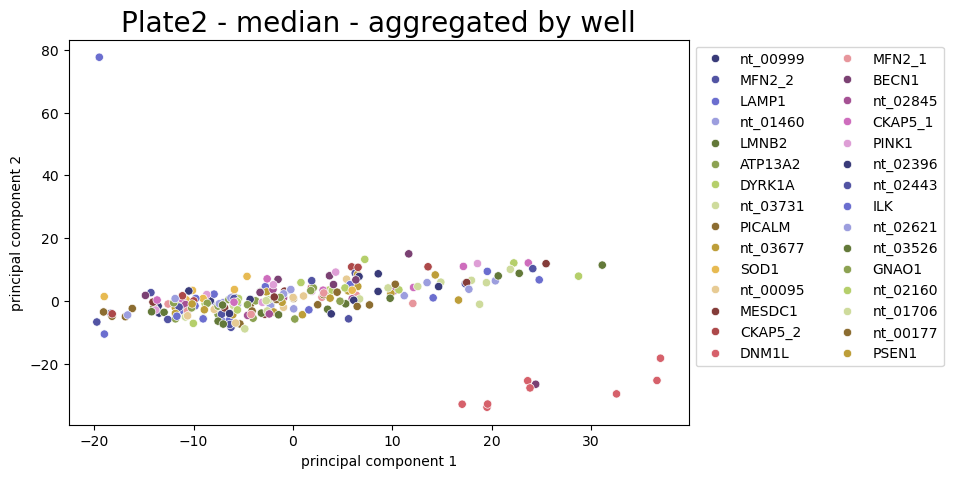

In [93]:
pl = 'Plate2'
pca_df2 = pca_plot_well(w2, w2.columns[1:-2], pl + ' - median - aggregated by well')

In [94]:
# pl = 'Plate3'
# pca_df3 = pca_plot_well(w3, w3.columns[1:-2], pl + ' - median - aggregated by well')

Explained variation per principal component: [0.38661596 0.22402039]


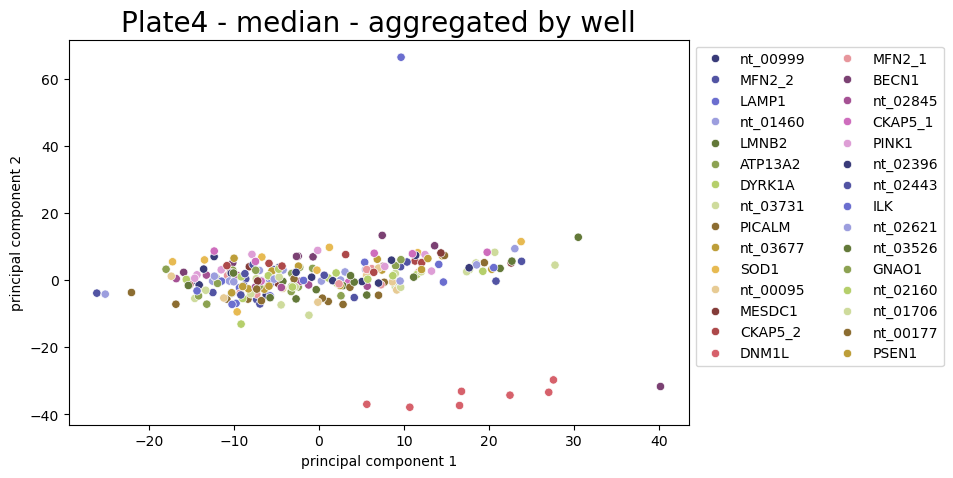

In [95]:
pl = 'Plate4'
pca_df4 = pca_plot_well(w4, w4.columns[1:-2], pl + ' - median - aggregated by well')

In [96]:
pca_df4[(-20 > pca_df4['principal component 1']) | (pca_df4['principal component 2'] < -20) | (pca_df4['principal component 2'] > 20)]

,principal component 1,principal component 2,well,guide
14,27.601340,-29.711077,C17,DNM1L
16,40.203209,-31.674472,C19,BECN1
43,16.548148,-37.328924,E06,DNM1L
64,5.628729,-36.969439,F07,DNM1L
87,10.692063,-37.844953,G10,DNM1L
102,-26.160308,-3.870607,H05,nt_02443
136,9.659830,66.370317,I21,ILK
139,27.049268,-33.392014,J04,DNM1L
175,22.484974,-34.251660,K20,DNM1L
199,-25.168788,-4.169000,M06,nt_02621


# supervised machine learning:

In [97]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report

In [100]:
d = dict()
d_rev = dict()
for i, x in enumerate(sorted(tvn_df1.guide.unique())):
    d[x] = i
    d_rev[i] = x
print(d)
print(d_rev)

{'ATP13A2': 0, 'BECN1': 1, 'CKAP5_1': 2, 'CKAP5_2': 3, 'DNM1L': 4, 'DYRK1A': 5, 'GNAO1': 6, 'ILK': 7, 'LAMP1': 8, 'LMNB2': 9, 'MESDC1': 10, 'MFN2_1': 11, 'MFN2_2': 12, 'PICALM': 13, 'PINK1': 14, 'PSEN1': 15, 'SOD1': 16, 'nt_00095': 17, 'nt_00177': 18, 'nt_00999': 19, 'nt_01460': 20, 'nt_01706': 21, 'nt_02160': 22, 'nt_02396': 23, 'nt_02443': 24, 'nt_02621': 25, 'nt_02845': 26, 'nt_03526': 27, 'nt_03677': 28, 'nt_03731': 29}
{0: 'ATP13A2', 1: 'BECN1', 2: 'CKAP5_1', 3: 'CKAP5_2', 4: 'DNM1L', 5: 'DYRK1A', 6: 'GNAO1', 7: 'ILK', 8: 'LAMP1', 9: 'LMNB2', 10: 'MESDC1', 11: 'MFN2_1', 12: 'MFN2_2', 13: 'PICALM', 14: 'PINK1', 15: 'PSEN1', 16: 'SOD1', 17: 'nt_00095', 18: 'nt_00177', 19: 'nt_00999', 20: 'nt_01460', 21: 'nt_01706', 22: 'nt_02160', 23: 'nt_02396', 24: 'nt_02443', 25: 'nt_02621', 26: 'nt_02845', 27: 'nt_03526', 28: 'nt_03677', 29: 'nt_03731'}


In [101]:
# machine learning on TVN projections:
# plate1:
X = tvn_df1[tvn_df1.columns[:-2]]
y = [d[i] for i in tvn_df1.guide]
print(X.shape)
print(len(y))

(146230, 128)
146230


In [20]:
# # harmonized TVN projections:
# X = hm_tvn[hm_tvn.columns[:-3]]
# y = [d[i] for i in hm_tvn.guide]
# print(X.shape)
# print(len(y))

In [116]:
scaled = StandardScaler().fit_transform(X.values)
scaled.shape

(151096, 128)

In [117]:
# logistic regression:
# multi-class (OVR classification)

from sklearn.linear_model import LogisticRegression
from sklearn.multiclass import OneVsRestClassifier

from sklearn.svm import SVC

x_train, x_test, y_train, y_test = train_test_split(scaled, y, test_size=0.25, random_state=None, shuffle=True)
print(len(x_train), len(x_test), len(y_train), len(y_test))

logistic_tuned = LogisticRegression(max_iter=5000, solver='lbfgs', C=1)
ovr_classifier = OneVsRestClassifier(logistic_tuned).fit(x_train, y_train)

113322 37774 113322 37774


In [118]:
y_pred = ovr_classifier.predict(x_test)

from sklearn.metrics import f1_score, recall_score, precision_score

recall = recall_score(y_test, y_pred, average='weighted')
f1 = f1_score(y_test, y_pred, average='weighted')
precision = precision_score(y_test, y_pred, average='weighted')

# Create a dataframe that will hold the metrics of each model
# MODELS = pd.DataFrame([['Logistic Regression', log_train_recall, log_test_recall, log_train_f1, log_test_f1]], 
#                     columns = ['Model', 'Train Recall Score', 'Test Recall Score', 'F1 Train Score', 'F1 Test Score'])

MODELS = pandas.DataFrame([['Logistic Regression', precision, recall, f1]], 
                    columns = ['Model', 'Precision Score', 'Recall Score', 'F1 Score'])

display(MODELS)

,Model,Precision Score,Recall Score,F1 Score
0,Logistic Regression,0.122761,0.137078,0.122063


              precision    recall  f1-score   support

           0       0.13      0.18      0.15      1380
           1       0.10      0.13      0.11      1335
           2       0.23      0.47      0.31       910
           3       0.14      0.19      0.16      1293
           4       0.42      0.82      0.56      1466
           5       0.09      0.05      0.06      1261
           6       0.15      0.09      0.11      1005
           7       0.11      0.06      0.08      1084
           8       0.13      0.15      0.14      1071
           9       0.08      0.04      0.05      1327
          10       0.07      0.03      0.04      1060
          11       0.09      0.15      0.11      1335
          12       0.17      0.31      0.22       638
          13       0.13      0.15      0.14      1299
          14       0.11      0.08      0.10      1187
          15       0.11      0.04      0.05      1321
          16       0.13      0.15      0.14      1079
          17       0.11    

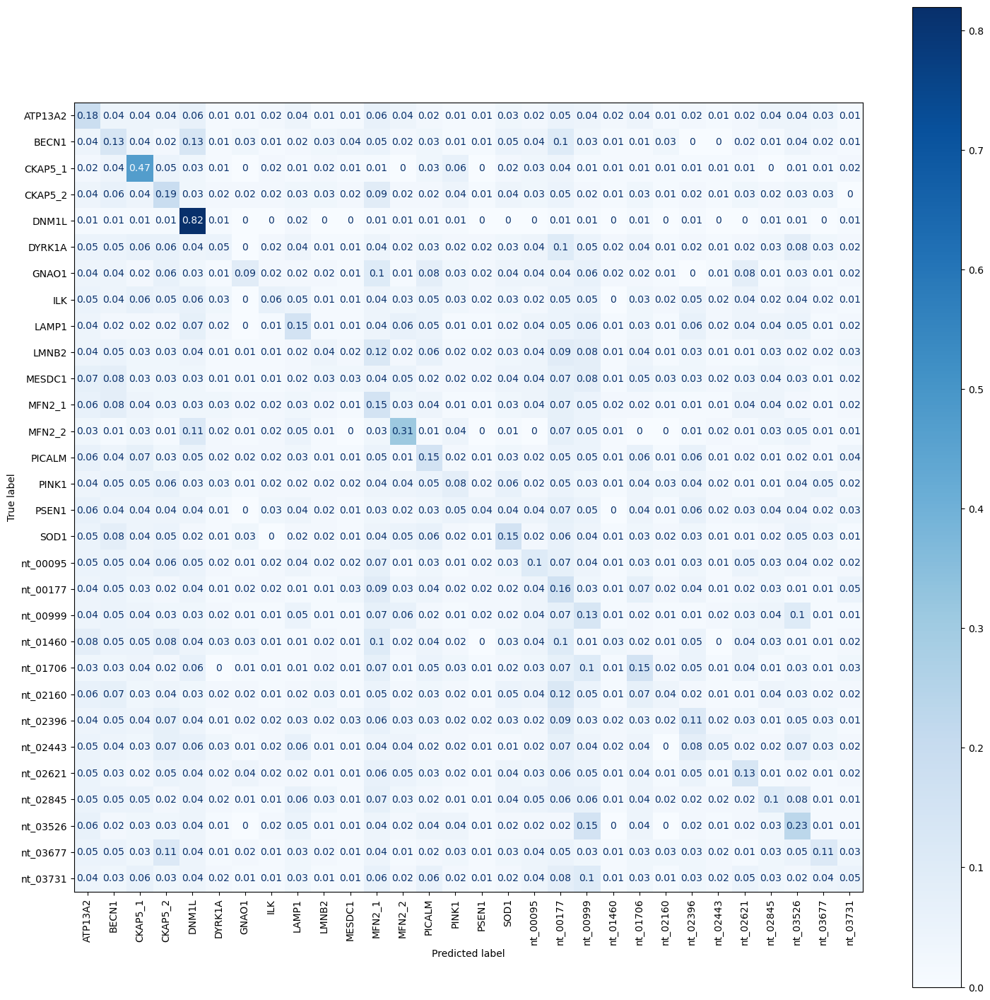

In [107]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

conf_mtx = confusion_matrix(y_true = y_test, y_pred = y_pred, normalize='true')
vis = ConfusionMatrixDisplay(confusion_matrix=conf_mtx.round(2), display_labels=list(d_rev.values())[:len(d)])
fig, ax = plt.subplots(figsize=(18,18))
# vis.plot(cmap='Blues', xticks_rotation=90)
vis.plot(ax=ax, cmap='Blues', xticks_rotation=90)

print(classification_report(y_test, y_pred))

# plate 1 TVN projections
# multi-label logistic regression


### MLP on TVN_PCA:

In [121]:
import torchvision
import torch
from torch import nn
from torch.utils.data import DataLoader, Dataset
from torchvision import datasets
from torchvision.transforms import ToTensor, Lambda
import torchvision.transforms as T
from torchvision import datasets, transforms
from torchvision.utils import make_grid
from torchvision.utils import Image
from torchvision.io import read_image

import pandas
import numpy
import numpy as np
import matplotlib.pyplot as plt

import torch.nn.functional as F
import torch.utils.data as data_utils
from sklearn.model_selection import train_test_split
import glob

In [122]:
# mlp on TVN projections:
# plate1:
X = tvn_df1[tvn_df1.columns[:-2]]
y = [d[i] for i in tvn_df1.guide]
print(X.shape)
print(len(y))

(146230, 128)
146230


In [123]:
print(X.shape)
scaled_cells = StandardScaler().fit_transform(X.values)
imgs = torch.from_numpy(scaled_cells)#.permute(0, 3, 1, 2)
imgs = transforms.ConvertImageDtype(torch.float32)(imgs)

print(imgs.shape)

classes = numpy.array(y)
lbls = torch.from_numpy(classes)
lbls = lbls.type(torch.LongTensor)

print(lbls.shape)
print(numpy.unique(lbls))

(146230, 128)
torch.Size([146230, 128])
torch.Size([146230])
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22 23
 24 25 26 27 28 29]


In [124]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(imgs, lbls, shuffle=True, test_size=.16, random_state=None)
# X_train, X_test, y_train, y_test = train_test_split(rotenone, l, shuffle=True, test_size=.16, random_state=None)
print('Training data shape : ', X_train.shape, y_train.shape)
print('Testing data shape : ', X_test.shape, y_test.shape)

X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, shuffle=True, test_size=.2, random_state=None)
print('Training data shape : ', X_train.shape, y_train.shape)
print('Validation data shape : ', X_val.shape, y_val.shape)

Training data shape :  torch.Size([122833, 128]) torch.Size([122833])
Testing data shape :  torch.Size([23397, 128]) torch.Size([23397])
Training data shape :  torch.Size([98266, 128]) torch.Size([98266])
Validation data shape :  torch.Size([24567, 128]) torch.Size([24567])


In [125]:
import torch.utils.data as data_utils
train_dataset = data_utils.TensorDataset(X_train, y_train)
test_dataset = data_utils.TensorDataset(X_test, y_test)
val_dataset = data_utils.TensorDataset(X_val, y_val)

trainloader = data_utils.DataLoader(train_dataset, batch_size=64, shuffle=True)
valloader = data_utils.DataLoader(val_dataset, batch_size=64, shuffle=True)
testloader = data_utils.DataLoader(test_dataset, batch_size=64, shuffle=True)

print(len(trainloader))
print(len(valloader))
print(len(testloader))

print(len(train_dataset))
print(len(val_dataset))
print(len(test_dataset))

1536
384
366
98266
24567
23397


In [126]:
len(d)
imgs.shape[1]

128

In [127]:
#### multi layer perceptron: ########
from torch import optim
model = nn.Sequential(nn.Linear(imgs.shape[1], 256),
                      nn.ReLU(),
                      # nn.Linear(4096, 2048),
                      # nn.ReLU(),
                      # nn.Linear(2048, 1024),
                      # nn.ReLU(),
                      # nn.Linear(1024, 512),
                      # nn.ReLU(),
                      # nn.Linear(512, 256),
                      # nn.ReLU(),
                      nn.Linear(256, 128),
                      nn.ReLU(),
                      nn.Linear(128, 64),
                      nn.ReLU(),
#                       nn.Linear(64, 6),
                      nn.Linear(64, len(d)),
                      nn.LogSoftmax(dim=1))

criterion = nn.NLLLoss()#weight=weights)
# criterion = nn.CrossEntropyLoss(weight=weights)
optimizer = optim.SGD(model.parameters(), lr = .01)

model

Sequential(
  (0): Linear(in_features=128, out_features=256, bias=True)
  (1): ReLU()
  (2): Linear(in_features=256, out_features=128, bias=True)
  (3): ReLU()
  (4): Linear(in_features=128, out_features=64, bias=True)
  (5): ReLU()
  (6): Linear(in_features=64, out_features=30, bias=True)
  (7): LogSoftmax(dim=1)
)

In [128]:
exp = 'plate1_TVN'

In [129]:
train_on_gpu = torch.cuda.is_available()
if not train_on_gpu:
    print ('CUDA is not available. Training on CPU...')
else: print('CUDA is available. Training on GPU...')
model.cuda()
n_epochs = 100

valid_loss_min = numpy.Inf

train_losses, test_losses = [], []

for epoch in range(1, n_epochs+1):

    # keep track of training and validation loss
    train_loss = 0.0
    valid_loss = 0.0
    
    ###################
    # train the model #
    ###################
    model.train()
    for data, target in trainloader:
#         # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # clear the gradients of all optimized variables
        optimizer.zero_grad()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = criterion(output, target)
        # backward pass: compute gradient of the loss with respect to model parameters
        loss.backward()
        # perform a single optimization step (parameter update)
        optimizer.step()
        # update training loss
        train_loss += loss.item()*data.size(0)
        
    ######################    
    # validate the model #
    ######################
    model.eval()
    for data, target in valloader:
        # move tensors to GPU if CUDA is available
        if train_on_gpu:
            data, target = data.cuda(), target.cuda()
        # forward pass: compute predicted outputs by passing inputs to the model
        output = model(data)
        # calculate the batch loss
        loss = criterion(output, target)
        # update average validation loss 
        valid_loss += loss.item()*data.size(0)
    
    # calculate average losses
    train_loss = train_loss/len(trainloader.sampler)
    valid_loss = valid_loss/len(valloader.sampler)
    
    train_losses.append(train_loss)
    test_losses.append(valid_loss)
        
    # print training/validation statistics 
    print('Epoch: {} \tTraining Loss: {:.6f} \tValidation Loss: {:.6f}'.format(
        epoch, train_loss, valid_loss))
    
    # save model if validation loss has decreased
    if valid_loss <= valid_loss_min:
        print('Validation loss decreased ({:.6f} --> {:.6f}).  Saving model ...'.format(
        valid_loss_min,
        valid_loss))
        torch.save(model.state_dict(), '30label_CP_mlp_model_' + exp + '.pt')
        valid_loss_min = valid_loss
print(exp)

CUDA is available. Training on GPU...
Epoch: 1 	Training Loss: 3.396189 	Validation Loss: 3.388082
Validation loss decreased (inf --> 3.388082).  Saving model ...
Epoch: 2 	Training Loss: 3.381855 	Validation Loss: 3.371108
Validation loss decreased (3.388082 --> 3.371108).  Saving model ...
Epoch: 3 	Training Loss: 3.347321 	Validation Loss: 3.316289
Validation loss decreased (3.371108 --> 3.316289).  Saving model ...
Epoch: 4 	Training Loss: 3.290647 	Validation Loss: 3.278786
Validation loss decreased (3.316289 --> 3.278786).  Saving model ...
Epoch: 5 	Training Loss: 3.255013 	Validation Loss: 3.242982
Validation loss decreased (3.278786 --> 3.242982).  Saving model ...
Epoch: 6 	Training Loss: 3.213687 	Validation Loss: 3.203943
Validation loss decreased (3.242982 --> 3.203943).  Saving model ...
Epoch: 7 	Training Loss: 3.173762 	Validation Loss: 3.170153
Validation loss decreased (3.203943 --> 3.170153).  Saving model ...
Epoch: 8 	Training Loss: 3.136506 	Validation Loss: 3.138

Text(0.5, 1.0, 'plate1_TVN')

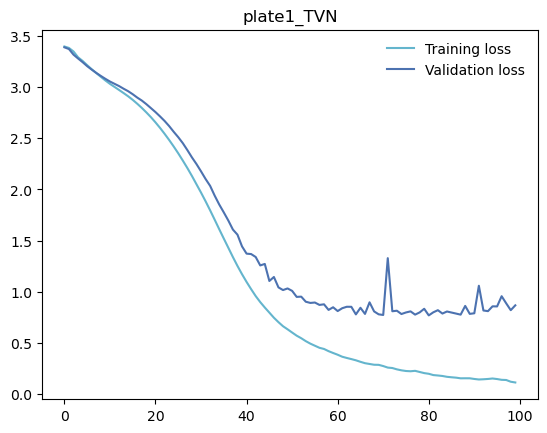

In [130]:
plt.plot(train_losses, label='Training loss', color='c')
plt.plot(test_losses, label='Validation loss', color='b')
plt.legend(frameon=False)
plt.title(exp)

In [131]:
model.load_state_dict(torch.load('30label_CP_mlp_model_' + exp + '.pt'))

<All keys matched successfully>

In [132]:
# predictions based on trained model:
#import helper

i, l = next(iter(testloader))

correct = 0
for x in range(len(i)):
    img = i[x].view(1, imgs.shape[1]).cuda()
    lb = l[x].item()
    # turn off gradients to speed up:
    with torch.no_grad():
        logps = model(img)
    # logps = model(img)

    # output of the network are log-probabilities, need to take exponential for probabilities:
    ps = torch.exp(logps)
    #helper.view_classify(img.view(150,150,3), ps)
#     view_classify(img, ps, lb)
    if ps.topk(1)[1].item() == lb:
        correct += 1
# view_classify(img, ps, lb)
print(correct)
print('accuracy: ' + str(correct/64))

52
accuracy: 0.8125


In [133]:
# initialize lists to monitor test loss and accuracy
num_classes = len(d)
test_loss = 0.0
class_correct = list(0. for i in range(num_classes))
class_total = list(0. for i in range(num_classes))

# model.cuda().eval() # prep model for *evaluation*
# model.cpu().eval()
model.eval()

for data, target in testloader:
    data, target = data.cuda(), target.cuda()
    # forward pass: compute predicted outputs by passing inputs to the model
    output = model(data)
    # calculate the loss
    loss = criterion(output, target)
    # update test loss 
    test_loss += loss.item()*data.size(0)
    # convert output probabilities to predicted class
    _, pred = torch.max(output, 1)
    # compare predictions to true label
    correct = numpy.squeeze(pred.eq(target.data.view_as(pred)))
    # calculate test accuracy for each object class
    for i in range(len(data)):
        label = target.data[i]
        class_correct[label] += correct[i].item()
        class_total[label] += 1

# calculate and print avg test loss
test_loss = test_loss/len(testloader.dataset)
print('Test Loss: {:.6f}\n'.format(test_loss))

for i in range(num_classes):
    if class_total[i] > 0:
        print('Test Accuracy of %5s: %2d%% (%2d/%2d)' % (
            d_rev[i], 100 * class_correct[i] / class_total[i],
            class_correct[i], class_total[i]))
    else:
        print('Test Accuracy of %5s: N/A (no training examples)' % (classes[i]))

print('\nTest Accuracy (Overall): %2d%% (%2d/%2d)' % (
    100. * numpy.sum(class_correct) / numpy.sum(class_total),
    numpy.sum(class_correct), numpy.sum(class_total)))

Test Loss: 0.763003

Test Accuracy of ATP13A2: 79% (679/856)
Test Accuracy of BECN1: 87% (765/875)
Test Accuracy of CKAP5_1: 88% (498/560)
Test Accuracy of CKAP5_2: 79% (648/812)
Test Accuracy of DNM1L: 83% (776/927)
Test Accuracy of DYRK1A: 75% (596/786)
Test Accuracy of GNAO1: 86% (629/729)
Test Accuracy of   ILK: 78% (531/677)
Test Accuracy of LAMP1: 80% (552/682)
Test Accuracy of LMNB2: 88% (741/835)
Test Accuracy of MESDC1: 72% (478/659)
Test Accuracy of MFN2_1: 86% (768/888)
Test Accuracy of MFN2_2: 78% (330/422)
Test Accuracy of PICALM: 87% (720/825)
Test Accuracy of PINK1: 82% (609/739)
Test Accuracy of PSEN1: 74% (612/822)
Test Accuracy of  SOD1: 86% (583/677)
Test Accuracy of nt_00095: 81% (708/867)
Test Accuracy of nt_00177: 85% (829/965)
Test Accuracy of nt_00999: 87% (734/839)
Test Accuracy of nt_01460: 85% (659/774)
Test Accuracy of nt_01706: 81% (634/779)
Test Accuracy of nt_02160: 81% (651/800)
Test Accuracy of nt_02396: 80% (661/822)
Test Accuracy of nt_02443: 79% (569

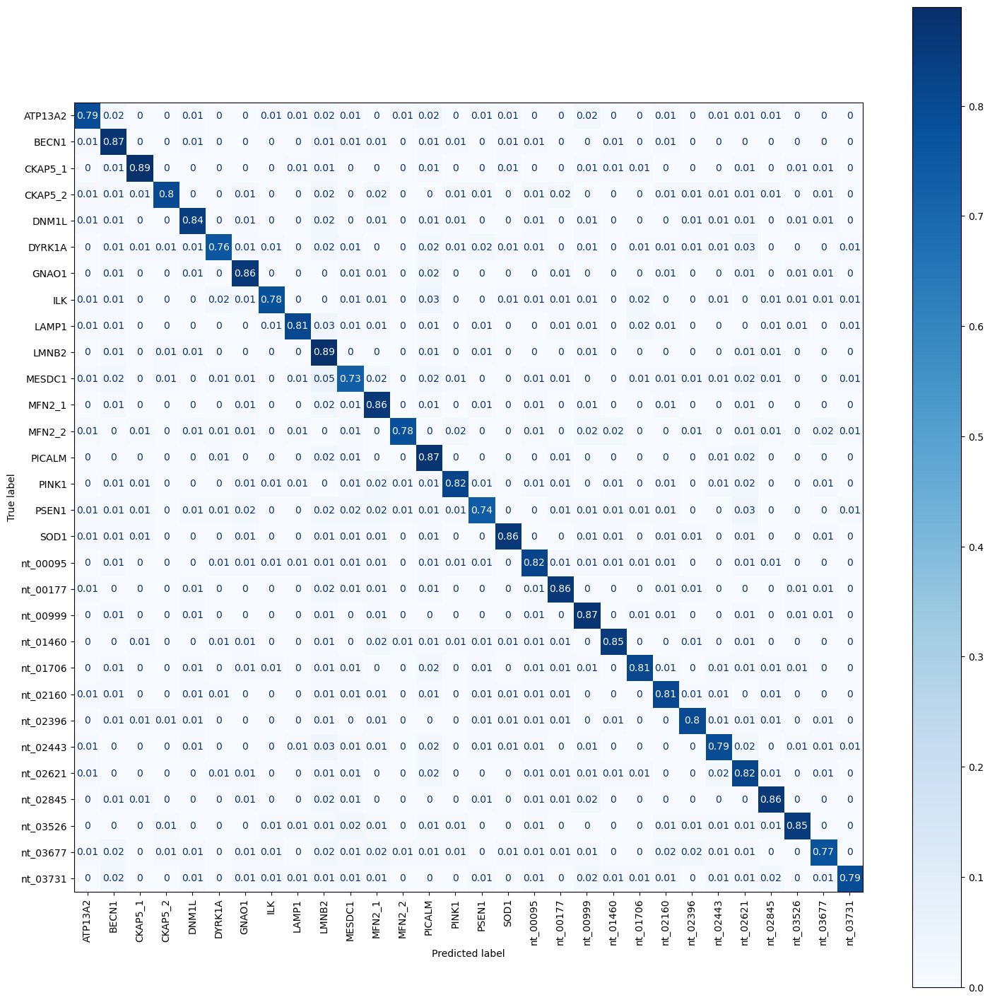

In [134]:
import seaborn
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

# turn off autograd for testing evaluation
with torch.no_grad():
# set the model in evaluation mode
    model.to('cpu').eval()
    #model.eval()
# initialize a list to store our predictions
    preds = []
    ytest = []
# loop over the test set
    for (x, y) in testloader:
#        x.cuda()
 #       y.cuda()
        # make the predictions and add them to the list
#         x = x.view(x.shape[0], -1)
        # x, y = x.cuda(), y.cuda()
        pred = model(x)
        preds.extend(pred.argmax(axis=1).cpu().numpy())
        ytest.extend(list(y.numpy()))
# generate a classification report

# print(classification_report(numpy.array(ytest), numpy.array(preds)))

conf_mtx = confusion_matrix(y_true = ytest, y_pred = preds, normalize='true')
vis = ConfusionMatrixDisplay(confusion_matrix=conf_mtx.round(2), display_labels=list(d_rev.values())[:len(d)])
fig, ax = plt.subplots(figsize=(18,18))
#vis.plot(cmap='Blues', xticks_rotation=90)
vis.plot(ax=ax, cmap='Blues', xticks_rotation=90)#, title='mlp on harmonized TVN pcs')

# mlp on plate1 TVN pcs: